In [2]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

df = pd.read_csv("~/home/vip/Desktop/Proff/1. AI:ML,DL,RL,NLP,etc/1. Machine Learning/Practice\Projects/archive/APPL_data.csv")

df = pd.read_csv("./archive/AAPL_data.csv")

df.head()

In [3]:
df1 = pd.read_csv("./Pima_Indians_Diabetes/diabetes.csv")

In [4]:
df1.head()

,Pregnancies,Glucose,BloodPressure,SkinThickness,Insulin,BMI,DiabetesPedigreeFunction,Age,Outcome
0,6,148,72,35,0,33.6,0.627,50,1
1,1,85,66,29,0,26.6,0.351,31,0
2,8,183,64,0,0,23.3,0.672,32,1
3,1,89,66,23,94,28.1,0.167,21,0
4,0,137,40,35,168,43.1,2.288,33,1


In [17]:
df['Glucose'].unique()

array([ 89, 137,  78, 197, 189, 166, 118, 103, 115, 126, 143, 125,  97,
       145, 158,  88, 111, 180, 171, 101, 176, 150, 187, 100, 105, 141,
        95, 146, 139, 129,  83, 110, 136, 123,  81, 142, 144,  71,  93,
       122, 155, 160,  99, 162, 107, 120, 117, 173, 170,  96, 108, 154,
       106, 156, 153, 109, 163, 102, 114, 104, 134,  79,  75, 179, 119,
       181, 128, 148, 196, 140, 112, 151, 177,  87,  74,  91, 165, 124,
        90,  92, 193, 191, 133,  77, 161, 113, 152, 157, 130, 147,  84,
        98, 131, 116, 127, 172, 138,  94, 184, 135,  80,  82,  86,  85,
       195,  68, 186, 164, 198, 121, 188, 174, 168, 167,  56, 169, 149])

In [18]:
df['Insulin'].unique()

array([ 94, 168,  88, 543, 846, 175, 230,  83,  96, 235, 146, 115, 140,
       110, 245,  54, 192, 207,  70, 240,  82,  36,  23, 300, 342, 304,
       142, 128,  38, 100,  90, 270,  71, 125, 176,  48,  64, 228,  76,
       220,  40, 152,  18, 135, 495,  37,  51,  99, 145, 225,  49,  50,
        92, 325,  63, 284, 119, 204, 155, 485,  53, 114, 105, 285, 156,
        78, 130,  55,  58, 160, 210, 318,  44, 190, 280,  87, 271, 129,
       120, 478,  56,  32, 744, 370,  45, 194, 680, 402, 258, 375, 150,
        67,  57, 116, 278, 122, 545,  75,  74, 182, 360, 215, 184,  42,
       132, 148, 180, 205,  85, 231,  29,  68,  52, 255, 171,  73, 108,
        43, 167, 249, 293,  66, 465,  89, 158,  84,  72,  59,  81, 196,
       415, 275, 165, 579, 310,  61, 474, 170, 277,  60,  14,  95, 237,
       191, 328, 250, 480, 265, 193,  79,  86, 326, 188, 106,  65, 166,
       274,  77, 126, 330, 600, 185,  25,  41, 272, 321, 144,  15, 183,
        91,  46, 440, 159, 540, 200, 335, 387,  22, 291, 392, 17

## Removing Invalid entries

In [5]:
df = df1[df1['Insulin'] !=0]

In [6]:
df = df[df['Glucose']!=0]

## Visualization

<Axes: xlabel='Glucose', ylabel='Insulin'>

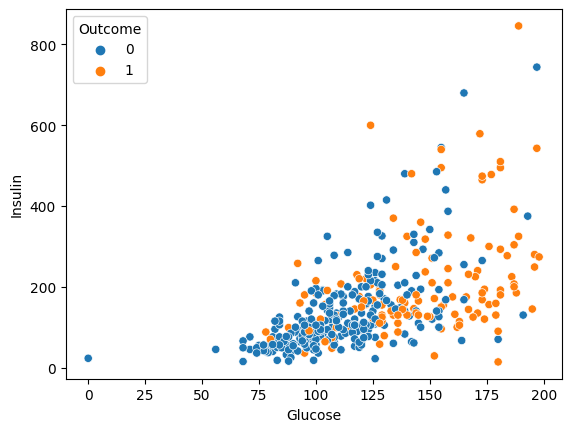

In [35]:
sns.scatterplot(x=df['Glucose'],y=df['Insulin'],hue=df['Outcome'])

<Axes: xlabel='Insulin', ylabel='BMI'>

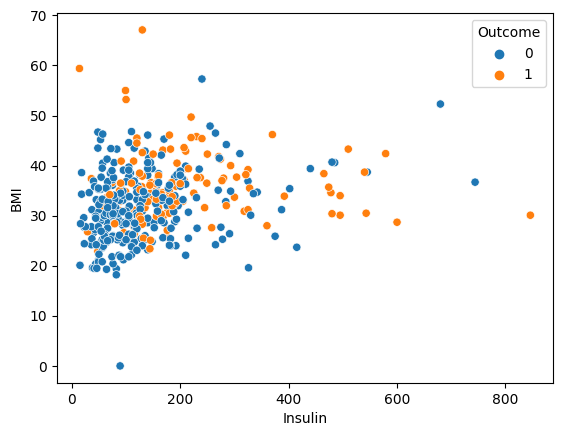

In [37]:
sns.scatterplot(y=df['BMI'],x=df['Insulin'],hue=df['Outcome'])

<Axes: xlabel='Glucose', ylabel='BMI'>

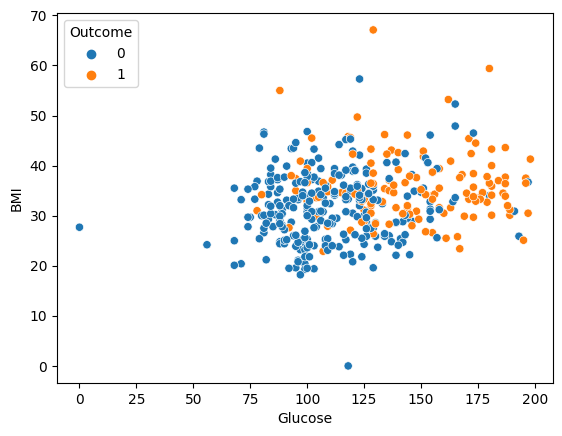

In [38]:
sns.scatterplot(x=df['Glucose'],y=df['BMI'],hue=df['Outcome'])

# Try Auto-encoder/PCA here (above)

<Axes: xlabel='BloodPressure', ylabel='Glucose'>

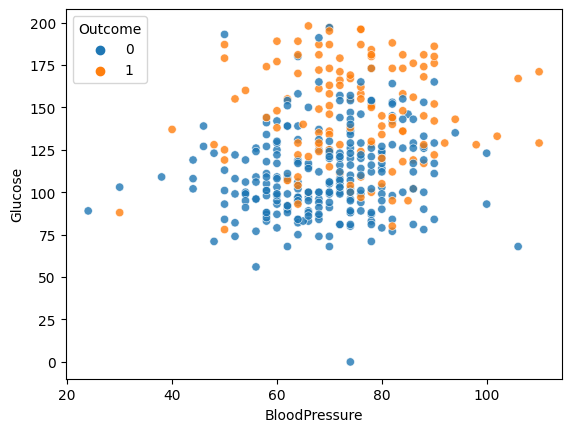

In [43]:
sns.scatterplot(x=df['BloodPressure'],y=df['Glucose'],hue=df['Outcome'],alpha=0.8)

<Axes: xlabel='Glucose', ylabel='SkinThickness'>

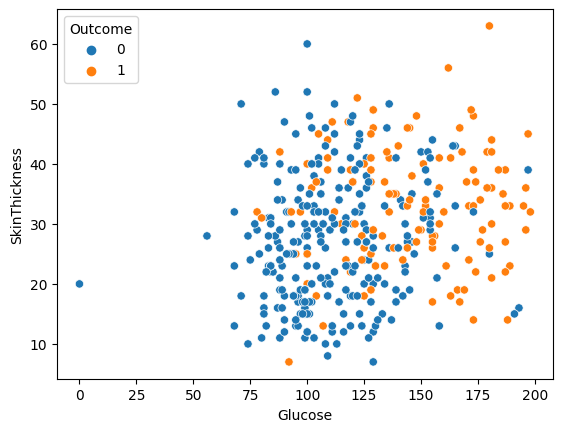

In [45]:
sns.scatterplot(x=df['Glucose'],y=df['SkinThickness'],hue=df['Outcome'])

## Check Variablity along y axis

<Axes: xlabel='Glucose', ylabel='DiabetesPedigreeFunction'>

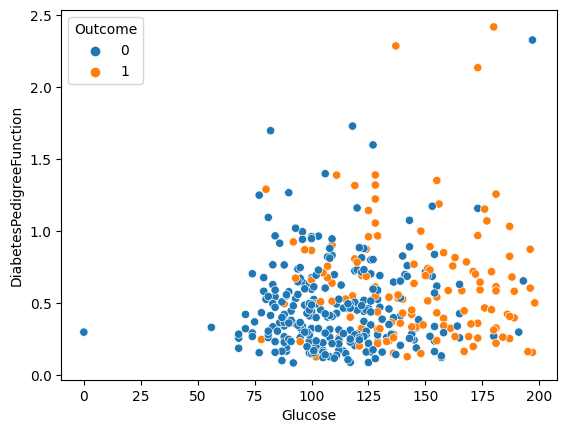

In [46]:
sns.scatterplot(x=df['Glucose'],y=df['DiabetesPedigreeFunction'],hue=df['Outcome'])

<Axes: xlabel='DiabetesPedigreeFunction', ylabel='Outcome'>

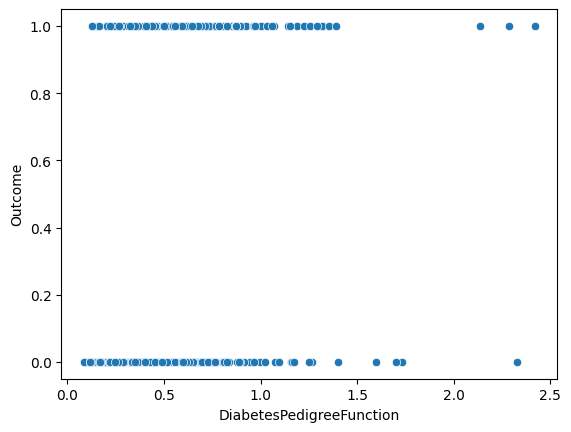

In [53]:
sns.scatterplot(x=df['DiabetesPedigreeFunction'],y=df['Outcome'])

<Figure size 2500x2500 with 0 Axes>

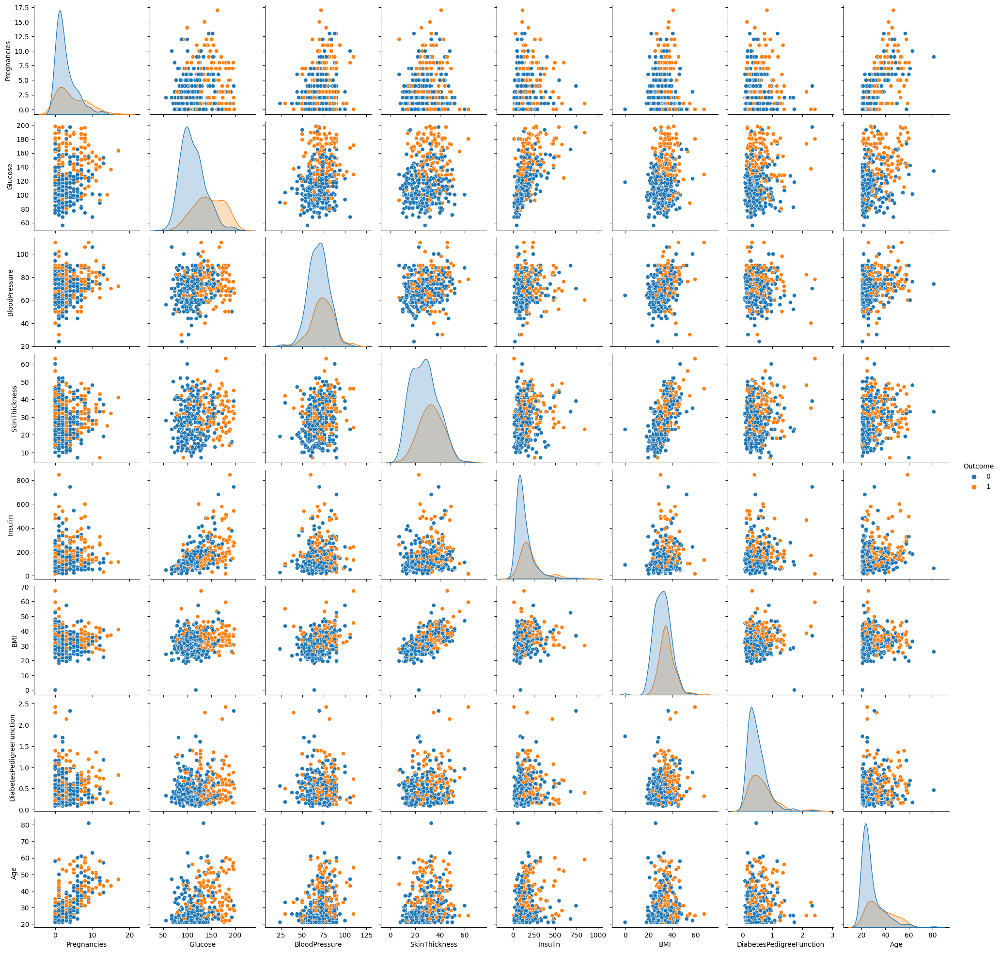

In [22]:
plt.figure(figsize=(25,25))
sns.pairplot(df,hue='Outcome')


In [ ]:
sns.pairplot(df,hue=df['Outcome'])

# Data Split: Train test

In [7]:
from sklearn.model_selection import train_test_split

In [8]:
X = df.drop('Outcome',axis=1)
y = df['Outcome']

In [9]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.33, random_state=42)

# Model

## 1. Logistic Regression

In [59]:
from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()

In [60]:
scaled_Xtrain = scaler.fit_transform(X_train)
scaled_Xtrest = scaler.transform(X_test)

In [61]:
from sklearn.linear_model import LogisticRegression
logistic_model = LogisticRegression()

In [62]:
param_grid_lr = {'penalty':['l1', 'l2', 'elasticnet', None],'solver':['lbfgs', 'liblinear', 'newton-cg', 'newton-cholesky', 'sag', 'saga'],
                 'multi_class':['auto', 'ovr', 'multinomial'],
                 'max_iter':[250,500],
                 
                 'tol':[0.000001,0.00001,0.0001,0.001],'C':[0.001,0.01,0.1,1,10],
                 'l1_ratio':[0.1,0.5,0.8],
                 'warm_start':[True,False]}

In [63]:
grid_lr =GridSearchCV(estimator=logistic_model,param_grid=param_grid_lr,
                     verbose=2,
                     scoring='accuracy')

In [64]:
grid_lr.fit(scaled_Xtrain,y_train)

Fitting 5 folds for each of 17280 candidates, totalling 86400 fits
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l1, solver=lbfgs, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l1, solver=lbfgs, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l1, solver=lbfgs, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l1, solver=lbfgs, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l1, solver=lbfgs, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l1, solver=lbfgs, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l1, solver=lbfgs, tol=1e-06, warm_star

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l1, solver=sag, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l1, solver=sag, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l1, solver=sag, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l1, solver=sag, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l1, solver=sag, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l1, solver=sag, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l1, solver=sag, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, mult

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l2, solver=lbfgs, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l2, solver=lbfgs, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l2, solver=lbfgs, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l2, solver=lbfgs, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l2, solver=lbfgs, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l2, solver=lbfgs, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l2, solver=lbfgs, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l2, solver=liblinear, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l2, solver=liblinear, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l2, solver=liblinear, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l2, solver=liblinear, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l2, solver=liblinear, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l2, solver=liblinear, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l2, solver=liblinear, tol=0.0001, warm_start=True; total time=   0.0s
[CV] E

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cg, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cg, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cg, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cg, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cg, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cg, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cg, tol=0.001, warm_start=True; total time=   0.0s
[CV

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cholesky, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cholesky, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cholesky, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cholesky, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cholesky, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cholesky, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cholesky, tol=0.0001, 

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l2, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l2, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l2, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l2, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l2, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l2, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l2, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, 

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=elasticnet, solver=liblinear, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=elasticnet, solver=liblinear, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=elasticnet, solver=liblinear, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=elasticnet, solver=liblinear, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=elasticnet, solver=liblinear, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=elasticnet, solver=liblinear, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=elasticnet, solver=liblinear, t

[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=elasticnet, solver=newton-cholesky, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=elasticnet, solver=newton-cholesky, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=elasticnet, solver=sag, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=elasticnet, solver=sag, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=elasticnet, solver=sag, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=elasticnet, solver=sag, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=elasticnet, solver=sag, tol=1e-06, warm_star

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=None, solver=lbfgs, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=None, solver=lbfgs, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=None, solver=lbfgs, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=None, solver=lbfgs, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=None, solver=lbfgs, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=None, solver=lbfgs, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=None, solver=lbfgs, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ra

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=None, solver=newton-cg, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=None, solver=newton-cg, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=None, solver=newton-cg, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=None, solver=newton-cg, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=None, solver=newton-cg, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=None, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=None, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=None, solver=newton-cg, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=None, solver=newton-cg, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=None, solver=newton-cg, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=None, solver=newton-cg, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=None, solver=newton-cg, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=None, solver=newton-cg, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=None, solver=newton-cholesky, tol=1e-06, warm_start=True; total t

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=None, solver=sag, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=None, solver=sag, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=None, solver=sag, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=None, solver=sag, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=None, solver=sag, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=None, solver=sag, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=None, solver=sag, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_ite

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=None, solver=saga, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=None, solver=saga, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=None, solver=saga, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=None, solver=saga, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=None, solver=saga, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=None, solver=saga, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=None, solver=saga, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1

[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l1, solver=newton-cholesky, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l1, solver=newton-cholesky, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l1, solver=newton-cholesky, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l1, solver=newton-cholesky, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l1, solver=newton-cholesky, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l1, solver=newton-cholesky, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l1, solver=newton-cholesky, tol=0.001, war

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l2, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l2, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l2, solver=lbfgs, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l2, solver=lbfgs, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l2, solver=lbfgs, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l2, solver=lbfgs, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l2, solver=lbfgs, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, 

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cholesky, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cholesky, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cholesky, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cholesky, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cholesky, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cholesky, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cholesky, tol=0.0001, warm_st

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l2, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l2, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l2, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l2, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l2, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l2, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l2, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=elasticnet, solver=newton-cholesky, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=elasticnet, solver=newton-cholesky, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=elasticnet, solver=newton-cholesky, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=elasticnet, solver=newton-cholesky, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=elasticnet, solver=newton-cholesky, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=elasticnet, solver=newton-cholesky, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=e

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=None, solver=lbfgs, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=None, solver=lbfgs, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=None, solver=lbfgs, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=None, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=None, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=None, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=None, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cg, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cg, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cg, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[C

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cg, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cg, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cg, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cholesky, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cholesky, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cholesky, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cholesky, tol=1e-06, warm_start=True

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=None, solver=sag, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=None, solver=sag, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=None, solver=sag, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=None, solver=sag, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=None, solver=sag, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=None, solver=sag, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=None, solver=sag, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=2

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=None, solver=saga, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=None, solver=saga, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=None, solver=saga, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=None, solver=saga, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=None, solver=saga, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=None, solver=saga, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=None, solver=saga, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_it

[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l1, solver=sag, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l1, solver=sag, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l1, solver=sag, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l1, solver=sag, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l1, solver=sag, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l1, solver=sag, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l1, solver=sag, tol=0.0001, warm_start=True; total time=   0.0s


/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l2, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l2, solver=lbfgs, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l2, solver=lbfgs, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l2, solver=lbfgs, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l2, solver=lbfgs, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l2, solver=lbfgs, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l2, solver=lbfgs, tol=0.0001, warm_start=False; tot

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=1e-0

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l2, solver=newton-cholesky, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l2, solver=newton-cholesky, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l2, solver=newton-cholesky, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l2, solver=newton-cholesky, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l2, sol

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l2, solver=sag, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l2, solver=sag, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l2, solver=sag, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l2, solver=sag, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l2, solver=sag, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l2, solver=sag, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l2, solver=sag, tol=0.001, warm_start=True; total time=   0.0s


/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=elasticnet, solver=lbfgs, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=elasticnet, solver=lbfgs, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=elasticnet, solver=lbfgs, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=elasticnet, solver=lbfgs, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=elasticnet, solver=lbfgs, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=elasticnet, solver=lbfgs, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty

[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=elasticnet, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=elasticnet, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=elasticnet, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=elasticnet, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=elasticnet, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=elasticnet, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=elasticne

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=None, solver=lbfgs, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=None, solver=lbfgs, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=None, solver=lbfgs, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=None, solver=lbfgs, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=None, solver=lbfgs, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=None, solver=lbfgs, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=None, solver=lbfgs, tol=0.001, warm_start=

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=None, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=None, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=None, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=None, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=None, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=None, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=None, solver=newt

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=None, solver=newton-cholesky, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=None, solver=newton-cholesky, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=None, solver=newton-cholesky, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=None, solver=newton-cholesky, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=None, solver=newton-cholesky, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=None, solver=newton-cholesky, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=None, solver=sag, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=None, solver=sag, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=None, solver=sag, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=None, solver=sag, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=None, solver=sag, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=None, solver=sag, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=None, solver=sag, tol=0.001, warm_start=False; total 

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l1, solver=lbfgs, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l1, solver=lbfgs, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l1, solver=lbfgs, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l1, solver=lbfgs, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l1, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l1, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l1, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_it

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l1, solver=newton-cholesky, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l1, solver=newton-cholesky, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l1, solver=newton-cholesky, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l1, solver=newton-cholesky, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l1, solver=newton-cholesky, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l1, solver=newton-cholesky, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l1, solver=newton-cholesky, tol=0.001, w

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l2, solver=lbfgs, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l2, solver=lbfgs, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l2, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l2, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l2, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l2, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l2, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l2, solver=newton-cg, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l2, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l2, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l2, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l2, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l2, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l2, solver=newton-cholesky, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l2, solver=newton-cholesky, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l2, solver=newton-cholesky, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l2, solver=newton-cholesky, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l2, solver=newton-cholesky, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l2, solver=newton-cholesky, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l2, solver=newton-cholesky, tol=1e-05, warm_s

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l2, solver=sag, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l2, solver=sag, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l2, solver=sag, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l2, solver=sag, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l2, solver=saga, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l2, solver=saga, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l2, solver=saga, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, mu

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=elasticnet, solver=liblinear, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=elasticnet, solver=liblinear, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=elasticnet, solver=liblinear, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=elasticnet, solver=liblinear, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=elasticnet, solver=liblinear, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=elasticnet, solver=liblinear, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=elasticnet, solver=libline

[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=elasticnet, solver=saga, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=elasticnet, solver=saga, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=elasticnet, solver=saga, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=elasticnet, solver=saga, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=elasticnet, solver=saga, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=elasticnet, solver=saga, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=None, solver=lbfgs, tol=1e-06, warm_start=True; total time=

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=None, solver=liblinear, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=None, solver=liblinear, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=None, solver=liblinear, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=None, solver=liblinear, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=None, solver=liblinear, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=None, solver=liblinear, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=None, solver=liblinear, tol=1e-05, warm_start=False; total time=  

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=None, solver=newton-cg, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=None, solver=newton-cg, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=None, solver=newton-cg, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=None, solver=newton-cg, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=None, solver=newton-cg, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=None, solver=newton-cg, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=None, solver=newton-cg, tol=0.001, warm_start=True; total ti

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=None, solver=newton-cholesky, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=None, solver=newton-cholesky, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=None, solver=newton-cholesky, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=None, solver=newton-cholesky, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=None, solver=newton-cholesky, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=None, solver=newton-cholesky, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=None, solver=newton-cholesky, 

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=None, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=None, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=None, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=None, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=None, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=None, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=None, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, 

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l1, solver=liblinear, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l1, solver=liblinear, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l1, solver=liblinear, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l1, solver=liblinear, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l1, solver=liblinear, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l1, solver=liblinear, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l1, solver=liblinear, tol=0.001, warm_start=True; total time=   0.0s
[CV] END 

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l1, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l1, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l1, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l1, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l1, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l1, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l1, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_c

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l2, solver=lbfgs, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l2, solver=lbfgs, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l2, solver=lbfgs, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l2, solver=lbfgs, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l2, solver=lbfgs, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l2, solver=lbfgs, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l2, solver=lbfgs, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500,

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.00

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cholesky, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cholesky, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cholesky, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cholesky, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cholesky, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cholesky, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cholesky, tol=0.001, warm

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l2, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l2, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l2, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l2, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l2, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l2, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l2, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, mul

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=elasticnet, solver=newton-cholesky, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=elasticnet, solver=newton-cholesky, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=elasticnet, solver=newton-cholesky, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=elasticnet, solver=newton-cholesky, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=elasticnet, solver=newton-cholesky, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=elasticnet, solver=newton-cholesky, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=ovr, pena

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=None, solver=lbfgs, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=None, solver=lbfgs, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=None, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=None, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=None, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=None, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=None, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=None, solver=newton-cg, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=None, solver=newton-cg, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=None, solver=newton-cg, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=None, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=None, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=None, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=None, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[C

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=None, solver=newton-cg, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=None, solver=newton-cg, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=None, solver=newton-cg, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=None, solver=newton-cg, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=None, solver=newton-cg, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=None, solver=newton-cg, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=None, solver=newton-cholesky, tol=1e-06, warm_start=True; total time=   

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=None, solver=sag, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=None, solver=sag, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=None, solver=sag, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=None, solver=sag, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=None, solver=sag, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=None, solver=sag, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=None, solver=sag, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500,

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=None, solver=saga, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=None, solver=saga, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=None, solver=saga, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=None, solver=saga, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=None, solver=saga, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=None, solver=saga, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=None, solver=saga, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1,

[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l1, solver=newton-cholesky, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l1, solver=sag, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l1, solver=sag, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l1, solver=sag, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l1, solver=sag, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l1, solver=sag, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l1, solver=sag, tol=1e-06, warm_start=False; total time=

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l2, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l2, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l2, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l2, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l2, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l2, solver=lbfgs, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l2, solver=lbfgs, tol=0.0001, warm_start=True; tota

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=1e-0

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l2, solver=newton-cholesky, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l2, solver=newton-cholesky, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l2, solver=newton-cholesky, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l2, solver=newton-cholesky, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l2, solver=newton-cholesky, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l2, solver=newton-cholesky, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=multinomial, pen

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l2, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l2, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l2, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l2, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l2, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l2, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l2, solver=saga, tol=1e-05, warm_start=True; total time=   0

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=elasticnet, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=elasticnet, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=elasticnet, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=elasticnet, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=elasticnet, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=elasticnet, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=multi

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=None, solver=lbfgs, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=None, solver=lbfgs, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=None, solver=lbfgs, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=None, solver=lbfgs, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=None, solver=lbfgs, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=None, solver=lbfgs, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=None, solver=lbfgs, tol=1e-06, warm_start=F

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=None, solver=liblinear, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=None, solver=liblinear, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=None, solver=liblinear, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=None, solver=liblinear, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=None, solver=liblinear, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=None, solver=liblinear, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=None, solver=libli

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=None, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=None, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=None, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=None, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=None, solver=newton-cg, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=None, solver=newton-cg, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=None, solver=

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=None, solver=sag, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=None, solver=sag, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=None, solver=sag, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=None, solver=sag, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=None, solver=sag, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=None, solver=sag, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=None, solver=sag, tol=1e-05, warm_start=True; total 

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=None, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=None, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=None, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=None, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=None, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=None, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=None, solver=saga, tol=1e-05, warm_start=False; t

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l1, solver=liblinear, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l1, solver=liblinear, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l1, solver=liblinear, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l1, solver=liblinear, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l1, solver=liblinear, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l1, solver=liblinear, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l1, solver=liblinear, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l1, solver=saga, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l1, solver=saga, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l1, solver=saga, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l1, solver=saga, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l1, solver=saga, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l1, solver=saga, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l1, solver=saga, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250,

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l2, solver=liblinear, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l2, solver=liblinear, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l2, solver=liblinear, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l2, solver=liblinear, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l2, solver=liblinear, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l2, solver=liblinear, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l2, solver=liblinear, tol=0.0001, warm_start=False; total time=   0.0s
[CV

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cg, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cg, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cg, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cg, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cg, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cg, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cholesky, tol=1e-06, warm_start=True; total time=   0.0s
[C

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l2, solver=sag, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l2, solver=sag, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l2, solver=sag, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l2, solver=sag, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l2, solver=sag, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l2, solver=sag, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l2, solver=sag, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250,

[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=elasticnet, solver=liblinear, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=elasticnet, solver=liblinear, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=elasticnet, solver=liblinear, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=elasticnet, solver=liblinear, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=elasticnet, solver=liblinear, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=elasticnet, solver=liblinear, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=elasticnet, solver=liblinear, t

[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=elasticnet, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=elasticnet, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=elasticnet, solver=saga, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=elasticnet, solver=saga, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=elasticnet, solver=saga, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=elasticnet, solver=saga, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=elasticnet, solver=saga, tol=0.0001, warm_start=False;

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=None, solver=lbfgs, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=None, solver=liblinear, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=None, solver=liblinear, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=None, solver=liblinear, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=None, solver=liblinear, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=None, solver=liblinear, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=None, solver=liblinear, tol=1e-06, warm_start=False; total time=   0.0s
[

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=None, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=None, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=None, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=None, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=None, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=None, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=None, solver=newton-cg, tol=0.0001, warm_start=True; total time= 

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=None, solver=newton-cholesky, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=None, solver=newton-cholesky, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=None, solver=newton-cholesky, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=None, solver=newton-cholesky, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=None, solver=newton-cholesky, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=None, solver=newton-cholesky, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=None, solver=newton-cholesky, tol

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=None, solver=sag, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=None, solver=sag, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=None, solver=sag, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=None, solver=sag, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=None, solver=sag, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=None, solver=sag, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=None, solver=sag, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_it

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l1, solver=lbfgs, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l1, solver=lbfgs, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l1, solver=lbfgs, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l1, solver=lbfgs, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l1, solver=lbfgs, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l1, solver=lbfgs, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l1, solver=lbfgs, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l1, solver=sag, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l1, solver=sag, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l1, solver=sag, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l1, solver=sag, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l1, solver=sag, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l1, solver=sag, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l1, solver=sag, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=ov

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l2, solver=lbfgs, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l2, solver=lbfgs, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l2, solver=lbfgs, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l2, solver=lbfgs, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l2, solver=lbfgs, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l2, solver=lbfgs, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l2, solver=lbfgs, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_ite

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.001, 

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cholesky, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cholesky, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cholesky, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cholesky, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cholesky, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cholesky, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cholesky, tol=0.0001, warm_sta

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l2, solver=saga, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l2, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l2, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l2, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l2, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l2, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l2, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, mult

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=elasticnet, solver=newton-cg, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=elasticnet, solver=newton-cholesky, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=elasticnet, solver=newton-cholesky, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=elasticnet, solver=newton-cholesky, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=elasticnet, solver=newton-cholesky, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=elasticnet, solver=newton-cholesky, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=elasticnet

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=None, solver=lbfgs, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=None, solver=lbfgs, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=None, solver=lbfgs, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=None, solver=lbfgs, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=None, solver=lbfgs, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=None, solver=lbfgs, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=None, solver=lbfgs, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, 

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=None, solver=liblinear, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=None, solver=liblinear, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=None, solver=liblinear, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=None, solver=liblinear, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cg, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cg, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cg, tol=1e-06, warm_start=True; total time=   0.0s
[C

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cg, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cg, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cg, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cg, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cg, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cg, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cg, tol=0.001, warm_start=False; total time=   0.0s
[CV

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cholesky, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cholesky, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=None, solver=sag, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=None, solver=sag, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=None, solver=sag, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=None, solver=sag, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=None, solver=sag, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_r

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=None, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=None, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=None, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=None, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=None, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=None, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=None, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, ma

[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l1, solver=newton-cg, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l1, solver=newton-cg, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l1, solver=newton-cg, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l1, solver=newton-cg, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l1, solver=newton-cg, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l1, solver=newton-cg, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l1, solver=newton-cg, tol=0.00

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l2, solver=lbfgs, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l2, solver=lbfgs, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l2, solver=lbfgs, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l2, solver=lbfgs, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l2, solver=lbfgs, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l2, solver=lbfgs, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l2, solver=lbfgs, tol=1e-05, warm_start=True; total ti

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=1e-06

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l2, solver=newton-cholesky, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l2, solver=newton-chol

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l2, solver=sag, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l2, solver=sag, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l2, solver=sag, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l2, solver=sag, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l2, solver=sag, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l2, solver=sag, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l2, solver=sag, tol=0.001, warm_start=False; total time=   0.0s
[C

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=elasticnet, solver=lbfgs, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=elasticnet, solver=lbfgs, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=elasticnet, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=elasticnet, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=elasticnet, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=elasticnet, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=elast

[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=elasticnet, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=elasticnet, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=elasticnet, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=elasticnet, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=elasticnet, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=elasticnet, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=elasticnet,

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=None, solver=lbfgs, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=None, solver=lbfgs, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=None, solver=lbfgs, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=None, solver=lbfgs, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=None, solver=lbfgs, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=None, solver=lbfgs, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=None, solver=lbfgs, tol=0.001, warm_start=F

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=None, solver=newton-cg, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=None, solver=newton-cg, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=None, solver=newton-cg, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=None, solver=newton-cg, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=None, solver=newton-cg, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=None, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=None, solver=newton-

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=None, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=None, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=None, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=None, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=None, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=None, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=None, solver=new

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=None, solver=newton-cholesky, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=None, solver=newton-cholesky, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=None, solver=newton-cholesky, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=None, solver=newton-cholesky, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=None, solver=newton-cholesky, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=None, solver=newton-cholesky, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=None, solver=sag, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=None, solver=sag, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=None, solver=sag, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=None, solver=sag, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=None, solver=sag, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=None, solver=sag, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=None, solver=sag, tol=0.0001, warm_start=False; 

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=None, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=None, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=None, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=None, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=None, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=None, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=None, solver=saga, tol=1e-05, warm_start=False; t

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l1, solver=lbfgs, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l1, solver=lbfgs, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l1, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l1, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l1, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l1, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l1, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l1, solver=newton-cg, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l1, solver=newton-cg, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l1, solver=newton-cg, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l1, solver=newton-cg, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l1, solver=newton-cg, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l1, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l1, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=

[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l1, solver=newton-cholesky, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l1, solver=sag, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l1, solver=sag, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l1, solver=sag, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l1, solver=sag, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l1, solver=sag, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l1, solver=sag, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l1, solver=saga, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l1, solver=saga, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l2, solver=lbfgs, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l2, solver=lbfgs, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l2, solver=lbfgs, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l2, solver=lbfgs, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l2, solver=lbfgs, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l2, solver=lbfgs, tol=0.001, warm_start=False; total time=   0.2s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l2, solver=lbfgs, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l2, solver=lbfgs, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l2, solver=liblinear, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l2, solver=liblinear, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l2, solver=liblinear, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l2, solver=liblinear, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_r

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l2, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l2, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l2, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l2, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l2, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l2, solver=newton-cg, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l2, solver=newton-cg, tol=0.0001, warm_start=False; total time=   0.0s
[CV]

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l2, solver=newton-cholesky, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l2, solver=newton-cholesky, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l2, solver=newton-cholesky, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l2, solver=newton-cholesky, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l2, solver=newton-cholesky, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l2, solver=sag, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l2, solver=sag, tol=1e-06, warm_start=True; total tim

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l2, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l2, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l2, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l2, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l2, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l2, solver=saga, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l2, solver=saga, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_ite

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=elasticnet, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=elasticnet, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=elasticnet, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=elasticnet, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=elasticnet, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=elasticnet, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=elasticnet, solver=newton-cg, 

[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=elasticnet, solver=saga, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=elasticnet, solver=saga, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=elasticnet, solver=saga, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=elasticnet, solver=saga, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=None, solver=lbfgs, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=None, solver=lbfgs, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=None, solver=lbfgs, tol=1e-06, warm_start=True; total time=   0.0s
[CV

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=None, solver=lbfgs, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=None, solver=lbfgs, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=None, solver=lbfgs, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=None, solver=lbfgs, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=None, solver=lbfgs, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=None, solver=lbfgs, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=None, solver=liblinear, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.001, 

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=None, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=None, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=None, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=None, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=None, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=None, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=None, solver=newton-cg, tol=0.0001, warm_start=True; total time=

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=None, solver=newton-cholesky, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=None, solver=newton-cholesky, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=None, solver=newton-cholesky, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=None, solver=newton-cholesky, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=None, solver=newton-cholesky, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=None, solver=newton-cholesky, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=None, solver=newton-cholesky

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=None, solver=sag, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=None, solver=sag, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=None, solver=sag, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=None, solver=sag, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=None, solver=sag, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=None, solver=sag, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=None, solver=sag, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_i

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l1, solver=lbfgs, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l1, solver=lbfgs, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l1, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l1, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l1, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l1, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l1, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=50

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l1, solver=sag, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l1, solver=sag, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l1, solver=sag, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l1, solver=sag, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l1, solver=sag, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l1, solver=sag, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l1, solver=sag, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_cla

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l2, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l2, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l2, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l2, solver=lbfgs, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l2, solver=lbfgs, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l2, solver=lbfgs, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l2, solver=lbfgs, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cg, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.00

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cholesky, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cholesky, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cholesky, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cholesky, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cholesky, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cholesky, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cholesky, tol=1e-05, warm_start=

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l2, solver=sag, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l2, solver=sag, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l2, solver=sag, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l2, solver=sag, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l2, solver=sag, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l2, solver=sag, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l2, solver=sag, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=ov

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=elasticnet, solver=liblinear, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=elasticnet, solver=liblinear, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=elasticnet, solver=liblinear, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=elasticnet, solver=liblinear, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=elasticnet, solver=liblinear, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=elasticnet, solver=liblinear, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=elasticnet, solver=liblinear, tol=1e

[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=elasticnet, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=elasticnet, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=elasticnet, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=elasticnet, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=elasticnet, solver=saga, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=elasticnet, solver=saga, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=elasticnet, solver=saga, tol=0.0001, warm_start=False; total ti

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=None, solver=lbfgs, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=None, solver=lbfgs, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=None, solver=lbfgs, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=None, solver=lbfgs, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=None, solver=liblinear, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=None, solver=liblinear, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=None, solver=liblinear, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.001, 

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=None, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=None, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=None, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=None, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=None, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=None, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=None, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=None, solver=newton-cholesky, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=None, solver=newton-cholesky, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=None, solver=newton-cholesky, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=None, solver=newton-cholesky, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=None, solver=newton-cholesky, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=None, solver=newton-cholesky, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=None, solver=newton-cholesky, tol=0

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=None, solver=sag, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=None, solver=sag, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=None, solver=sag, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=None, solver=sag, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=None, solver=sag, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=None, solver=sag, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=None, solver=sag, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=50

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l1, solver=lbfgs, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l1, solver=lbfgs, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l1, solver=lbfgs, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l1, solver=lbfgs, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l1, solver=lbfgs, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l1, solver=liblinear, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l1, solver=liblinear, tol=1e-06, warm_start=True

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l1, solver=sag, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l1, solver=sag, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l1, solver=sag, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l1, solver=sag, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l1, solver=sag, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l1, solver=sag, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l1, solver=sag, tol=0.001, warm_start=False; total time=   0.0s
[CV]

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l2, solver=lbfgs, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l2, solver=lbfgs, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l2, solver=lbfgs, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l2, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l2, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l2, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l2, solver=lbfgs, tol=1e-05, warm_start=False; total t

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l2, solver=lbfgs, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l2, solver=lbfgs, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l2, solver=lbfgs, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l2, solver=liblinear, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l2, solver=liblinear, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l2, solver=liblinear, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l2, solver=liblinear, tol=1e-06, warm_star

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=1e-

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l2, solver=newton-cholesky, 

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l2, solver=sag, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l2, solver=sag, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l2, solver=sag, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l2, solver=sag, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l2, solver=sag, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l2, solver=sag, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l2, solver=sag, tol=1e-05, warm_start=False; total time=   0.0s
[

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l2, solver=saga, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l2, solver=saga, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l2, solver=saga, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l2, solver=saga, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l2, solver=saga, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l2, solver=saga, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l2, solver=saga, tol=0.001, warm_start=True; total time

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=elasticnet, solver=newton-cholesky, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=elasticnet, solver=newton-cholesky, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=elasticnet, solver=newton-cholesky, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=elasticnet, solver=newton-cholesky, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=elasticnet, solver=newton-cholesky, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=elasticnet, solver=newton-cholesky, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_r

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=None, solver=lbfgs, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=None, solver=lbfgs, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=None, solver=lbfgs, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=None, solver=lbfgs, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=None, solver=lbfgs, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=None, solver=lbfgs, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=None, solver=lbfgs, tol=1e-06, warm_start=

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=None, solver=lbfgs, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=None, solver=lbfgs, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=None, solver=liblinear, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=None, solver=liblinear, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=None, solver=liblinear, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=None, solver=liblinear, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=None, solver=liblinear, tol

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=None, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=None, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=None, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=None, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=None, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=None, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=None, solver=newton-

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=None, solver=sag, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=None, solver=sag, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=None, solver=sag, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=None, solver=sag, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=None, solver=sag, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=None, solver=sag, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=None, solver=sag, tol=0.0001, warm_start=False; 

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=None, solver=saga, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=None, solver=saga, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=None, solver=saga, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=None, solver=saga, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=None, solver=saga, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=None, solver=saga, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=None, solver=saga, tol=0.001, warm_start=False; to

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l1, solver=newton-cholesky, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l1, solver=newton-cholesky, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l1, solver=newton-cholesky, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l1, solver=newton-cholesky, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l1, solver=newton-cholesky, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l1, solver=newton-cholesky, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l1, solver=newton-cholesky, tol=0.0001

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l2, solver=lbfgs, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l2, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l2, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l2, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l2, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l2, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l2, solver=lbfgs, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cg, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cg, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cholesky, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cholesky, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cholesky, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cholesky, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cholesky, tol=1e-06, warm_start=True; 

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l2, solver=sag, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l2, solver=sag, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l2, solver=sag, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l2, solver=sag, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l2, solver=sag, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l2, solver=sag, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l2, solver=sag, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, mu

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=elasticnet, solver=lbfgs, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=elasticnet, solver=lbfgs, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=elasticnet, solver=lbfgs, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=elasticnet, solver=lbfgs, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=elasticnet, solver=lbfgs, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=elasticnet, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=elasticnet, solver=lbfgs, tol=1e-05, warm_start=False; to

[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=elasticnet, solver=saga, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=elasticnet, solver=saga, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=elasticnet, solver=saga, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=elasticnet, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=elasticnet, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=elasticnet, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=elasticnet, solver=saga, tol=1e-06, warm_start=False; total t

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=None, solver=lbfgs, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=None, solver=lbfgs, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=None, solver=lbfgs, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=None, solver=lbfgs, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=None, solver=lbfgs, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=None, solver=lbfgs, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=None, solver=lbfgs, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_rat

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=None, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=None, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=None, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=None, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=None, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=None, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=None, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=None, solver=newton-cg, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=None, solver=newton-cg, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=None, solver=newton-cg, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=None, solver=newton-cg, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=None, solver=newton-cg, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=None, solver=newton-cg, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=None, solver=newton-cg, tol=0.001, warm_start=False; total time=   0

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=None, solver=newton-cholesky, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=None, solver=newton-cholesky, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=None, solver=newton-cholesky, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=None, solver=newton-cholesky, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=None, solver=newton-cholesky, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=None, solver=newton-cholesky, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=None, solver=newton-chol

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=None, solver=saga, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=None, solver=saga, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=None, solver=saga, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=None, solver=saga, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=None, solver=saga, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=None, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=None, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, 

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l1, solver=liblinear, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l1, solver=liblinear, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l1, solver=liblinear, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l1, solver=liblinear, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l1, solver=liblinear, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l1, solver=liblinear, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l1, solver=liblinear, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001,

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l1, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l1, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l1, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l1, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l1, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l1, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l1, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, mult

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l2, solver=lbfgs, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l2, solver=lbfgs, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l2, solver=lbfgs, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l2, solver=lbfgs, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l2, solver=lbfgs, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l2, solver=liblinear, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l2, solver=liblinear, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cg, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l2, solver=sag, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l2, solver=sag, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l2, solver=sag, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l2, solver=sag, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l2, solver=sag, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l2, solver=sag, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l2, solver=sag, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=ov

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l2, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l2, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l2, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l2, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l2, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l2, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l2, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_

[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=elasticnet, solver=liblinear, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=elasticnet, solver=liblinear, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=elasticnet, solver=liblinear, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=elasticnet, solver=liblinear, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=elasticnet, solver=liblinear, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=elasticnet, solver=liblinear, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=elasticnet, solver=liblinear, tol=1e-0

[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=elasticnet, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=elasticnet, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=elasticnet, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=elasticnet, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=elasticnet, solver=saga, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=elasticnet, solver=saga, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=elasticnet, solver=saga, tol=0.0001, warm_start=False; total ti

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=None, solver=lbfgs, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=None, solver=lbfgs, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=None, solver=lbfgs, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=None, solver=lbfgs, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=None, solver=lbfgs, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=None, solver=lbfgs, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=None, solver=lbfgs, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cg, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cg, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cg, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cg, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cg, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cg, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cg, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cg, tol=0.001, warm_start=True; total time=   

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cholesky, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cholesky, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cholesky, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cholesky, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cholesky, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cholesky, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cholesky, to

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=None, solver=sag, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=None, solver=sag, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=None, solver=saga, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=None, solver=saga, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=None, solver=saga, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=None, solver=saga, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=None, solver=saga, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=None, solver=saga, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=None, solver=saga, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=None, solver=saga, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l1, solver=lbfgs, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l1, solver=lbfgs, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l1, solver=lbfgs, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l1, solver=lbfgs, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l1, solver=sag, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l1, solver=sag, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l1, solver=sag, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l1, solver=sag, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l1, solver=sag, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l1, solver=sag, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l1, solver=sag, tol=1e-05, warm_start=True; total time=   0.0s
[CV

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l2, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l2, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l2, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l2, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l2, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l2, solver=lbfgs, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l2, solver=lbfgs, tol=0.0001, warm_start=True; tota

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l2, solver=liblinear, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l2, solver=liblinear, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l2, solver=liblinear, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l2, solver=liblinear, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l2, solver=liblinear, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l2, solver=liblinear, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l2, solver=liblinear, tol=1e-

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l2, solver=newton-cg, to

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l2, solver=sag, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l2, solver=sag, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l2, solver=sag, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l2, solver=sag, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l2, solver=sag, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l2, solver=sag, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l2, solver=sag, tol=1e-06, warm_start=False; total time=   0.0s
[CV

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l2, solver=sag, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l2, solver=sag, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l2, solver=sag, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l2, solver=sag, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l2, solver=saga, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l2, solver=saga, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l2, solver=saga, tol=1e-06, warm_start=True; total time=   0.0s

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=elasticnet, solver=lbfgs, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=elasticnet, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=elasticnet, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=elasticnet, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=elasticnet, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=elasticnet, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=elas

[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=elasticnet, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=elasticnet, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=elasticnet, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=elasticnet, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=elasticnet, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=elasticnet, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=elasticnet

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=None, solver=lbfgs, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=None, solver=lbfgs, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=None, solver=lbfgs, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=None, solver=lbfgs, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=None, solver=lbfgs, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=None, solver=lbfgs, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=None, solver=lbfgs, tol=0.001, warm_s

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=None, solver=newton-cg, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=None, solver=newton-cg, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=None, solver=newton-cg, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=None, solver=newton-cg, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=None, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=None, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=None, solver=newton

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=None, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=None, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=None, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=None, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=None, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=None, solver=newton-cg, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=None, solver=n

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=None, solver=newton-cholesky, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=None, solver=newton-cholesky, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=None, solver=newton-cholesky, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=None, solver=newton-cholesky, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=None, solver=newton-cholesky, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=None, solver=newton-cholesky, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=None, solver=sag, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=None, solver=sag, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=None, solver=sag, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=None, solver=sag, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=None, solver=sag, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=None, solver=sag, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=None, solver=sag, tol=0.001, warm_start=True; total

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=None, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=None, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=None, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=None, solver=saga, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=None, solver=saga, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=None, solver=saga, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=None, solver=saga, tol=0.0001, warm_start=

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l1, solver=newton-cg, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l1, solver=newton-cg, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l1, solver=newton-cg, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l1, solver=newton-cg, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l1, solver=newton-cg, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l1, solver=newton-cg, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l1, solver=newton-cg, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l2, solver=lbfgs, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l2, solver=lbfgs, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l2, solver=lbfgs, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l2, solver=lbfgs, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l2, solver=lbfgs, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l2, solver=lbfgs, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l2, solver=lbfgs, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l2, solver=liblinear, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l2, solver=liblinear, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l2, solver=liblinear, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l2, solver=liblinear, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l2, solver=liblinear, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l2, solver=liblinear, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l2, solver=liblinear, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l2, solver=newton-cg, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l2, solver=newton-cg, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l2, solver=newton-cg, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l2, solver=newton-cg, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l2, solver=newton-cg, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l2, solver=newton-cg, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l2, solver=newton-cg, tol=0.001, warm_start=False; total time=   0.0s
[CV] END

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l2, solver=sag, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l2, solver=sag, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l2, solver=sag, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l2, solver=sag, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l2, solver=sag, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l2, solver=sag, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l2, solver=sag, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, mu

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l2, solver=saga, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=elasticnet, solver=lbfgs, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=elasticnet, solver=lbfgs, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=elasticnet, solver=lbfgs, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=elasticnet, solver=lbfgs, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=elasticnet, solver=lbfgs, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=elasticnet, solver=lbfgs, tol=1e-06, warm_start=False; total time=

[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=elasticnet, solver=sag, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=elasticnet, solver=sag, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=elasticnet, solver=sag, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=elasticnet, solver=sag, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=elasticnet, solver=sag, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=elasticnet, solver=sag, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=elasticnet, solver=sag, tol=0.001, warm_start=True; total time= 

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=None, solver=lbfgs, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=None, solver=lbfgs, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=None, solver=lbfgs, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=None, solver=lbfgs, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=None, solver=lbfgs, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=None, solver=lbfgs, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=None, solver=lbfgs, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.001

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=None, solver=newton-cg, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=None, solver=newton-cg, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=None, solver=newton-cg, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=None, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=None, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=None, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=None, solver=newton-cg, tol=1e-06, warm_start=False; total time=   

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=None, solver=newton-cg, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=None, solver=newton-cg, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=None, solver=newton-cg, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=None, solver=newton-cg, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=None, solver=newton-cg, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=None, solver=newton-cg, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=None, solver=newton-cg, tol=0.001, warm_start=False; total time=   0

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=None, solver=newton-cholesky, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=None, solver=newton-cholesky, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=None, solver=newton-cholesky, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=None, solver=newton-cholesky, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=None, solver=newton-cholesky, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=None, solver=newton-cholesky, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=None, solver=sag, tol=1e-06, 

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=None, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=None, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=None, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=None, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=None, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=None, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=None, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l1, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l1, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l1, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l1, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l1, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l1, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l1, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, 

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l2, solver=lbfgs, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l2, solver=lbfgs, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l2, solver=lbfgs, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l2, solver=lbfgs, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l2, solver=lbfgs, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l2, solver=lbfgs, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l2, solver=lbfgs, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=50

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l2, solver=liblinear, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l2, solver=liblinear, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l2, solver=liblinear, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l2, solver=liblinear, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l2, solver=liblinear, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l2, solver=liblinear, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l2, solver=liblinear, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.001, 

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cg, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cg, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cg, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cholesky, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cholesky, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cholesky, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cholesky, tol=1e-06, warm_start=True; total time= 

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l2, solver=sag, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l2, solver=sag, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l2, solver=sag, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l2, solver=sag, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l2, solver=sag, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l2, solver=sag, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l2, solver=sag, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_cl

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=elasticnet, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=elasticnet, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=elasticnet, solver=lbfgs, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=elasticnet, solver=lbfgs, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=elasticnet, solver=lbfgs, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=elasticnet, solver=lbfgs, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=elasticnet, solver=lbfgs, tol=0.0001, warm_start=True; tota

[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=elasticnet, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=elasticnet, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=elasticnet, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=elasticnet, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=elasticnet, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=elasticnet, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=elasticnet, solver=saga, tol=1e-05, warm_start=False; total time=   0

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=None, solver=lbfgs, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=None, solver=lbfgs, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=None, solver=lbfgs, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=None, solver=lbfgs, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=None, solver=lbfgs, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=None, solver=lbfgs, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=None, solver=liblinear, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_rati

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=None, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=None, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=None, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=None, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=None, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=None, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=None, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV]

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=None, solver=newton-cg, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=None, solver=newton-cg, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=None, solver=newton-cg, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=None, solver=newton-cg, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=None, solver=newton-cg, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=None, solver=newton-cg, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=None, solver=newton-cg, tol=0.001, warm_start=False; total time=   0.0s
[CV

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=None, solver=newton-cholesky, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=None, solver=newton-cholesky, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=None, solver=newton-cholesky, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=None, solver=newton-cholesky, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=None, solver=newton-cholesky, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=None, solver=newton-cholesky, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=None, solver=newton-cholesky, tol=0.00

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=None, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=None, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=None, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=None, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=None, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=None, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=None, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_ite

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l1, solver=lbfgs, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l1, solver=lbfgs, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l1, solver=lbfgs, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l1, solver=lbfgs, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l1, solver=lbfgs, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l1, solver=liblinear, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l1, solver=liblinear, tol=1e-06, warm_start=True

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l1, solver=newton-cholesky, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l1, solver=newton-cholesky, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l1, solver=newton-cholesky, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l1, solver=newton-cholesky, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l1, solver=newton-cholesky, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l1, solver=newton-cholesky, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=multinomial, pen

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l2, solver=lbfgs, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l2, solver=lbfgs, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l2, solver=lbfgs, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l2, solver=lbfgs, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l2, solver=lbfgs, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l2, solver=lbfgs, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l2, solver=lbfgs, tol=1e-05, warm_start=True; total 

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l2, solver=liblinear, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l2, solver=liblinear, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l2, solver=liblinear, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l2, solver=liblinear, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l2, solver=liblinear, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l2, solver=liblinear, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l2, solver=liblinear, to

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=0

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l2, solver=newton-cholesky, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l2, solver=newton-cholesky, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l2, solver=newton-cholesky, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l2, solver=newton-cholesky, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l2, solver=newton-cholesky, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l2, solver=newton-cholesky, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=multinomial, p

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l2, solver=sag, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l2, solver=sag, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l2, solver=sag, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l2, solver=sag, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l2, solver=sag, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l2, solver=saga, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l2, solver=saga, tol=1e-06, warm_start=True; total time=   0.0s

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l2, solver=saga, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l2, solver=saga, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l2, solver=saga, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l2, solver=saga, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l2, solver=saga, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l2, solver=saga, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l2, solver=saga, tol=0.001, warm_start=False; total time=   0

[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=elasticnet, solver=newton-cg, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=elasticnet, solver=newton-cg, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=elasticnet, solver=newton-cg, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=elasticnet, solver=newton-cg, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=elasticnet, solver=newton-cg, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=elasticnet, solver=newton-cg, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=mu

[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=elasticnet, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=elasticnet, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=elasticnet, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=elasticnet, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=elasticnet, solver=saga, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=elasticnet, solver=saga, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=elastic

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=None, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=None, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=None, solver=lbfgs, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=None, solver=lbfgs, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=None, solver=lbfgs, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=None, solver=lbfgs, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=None, solver=lbfgs, tol=0.0001, warm_st

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=None, solver=liblinear, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=None, solver=liblinear, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=None, solver=liblinear, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=None, solver=liblinear, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=None, solver=liblinear, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=None, solver=liblinear, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=None, solver=l

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=None, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=None, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=None, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=None, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=None, solver=newton-cg, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=None, solver=newton-cg, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=None, solver=

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=None, solver=sag, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=None, solver=sag, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=None, solver=sag, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=None, solver=sag, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=None, solver=sag, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=None, solver=sag, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=None, solver=sag, tol=1e-06, warm_start=False; total 

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=None, solver=sag, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=None, solver=sag, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=None, solver=sag, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=None, solver=sag, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=None, solver=sag, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=None, solver=sag, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=None, solver=sag, tol=0.001, warm_start=False; total 

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=None, solver=saga, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=None, solver=saga, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=None, solver=saga, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=None, solver=saga, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=None, solver=saga, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=None, solver=saga, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.001, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=None, solver=saga, tol=0.001, warm_start=Tr

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l1, solver=liblinear, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l1, solver=liblinear, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l1, solver=liblinear, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l1, solver=liblinear, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l1, solver=liblinear, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l1, solver=liblinear, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l1, solver=liblinear, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C

[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l1, solver=sag, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l1, solver=sag, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l1, solver=sag, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l1, solver=sag, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l1, solver=sag, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l1, solver=sag, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l1, solver=sag, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=au

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l2, solver=lbfgs, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l2, solver=lbfgs, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l2, solver=lbfgs, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l2, solver=lbfgs, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l2, solver=lbfgs, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l2, solver=lbfgs, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l2, solver=lbfgs, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, 

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l2, solver=liblinear, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l2, solver=liblinear, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l2, solver=liblinear, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l2, solver=liblinear, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l2, solver=liblinear, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l2, solver=liblinear, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l2, solver=liblinear, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cg, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cg, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cg, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cg, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cg, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cg, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cg, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.01, 

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cholesky, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cholesky, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l2, solver=sag, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l2, solver=sag, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l2, solver=sag, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l2, solver=sag, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l2, solver=sag, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_i

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l2, solver=saga, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l2, solver=saga, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l2, solver=saga, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l2, solver=saga, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l2, solver=saga, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l2, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l2, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_cl

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=elasticnet, solver=liblinear, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=elasticnet, solver=liblinear, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=elasticnet, solver=liblinear, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=elasticnet, solver=liblinear, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=elasticnet, solver=newton-cg, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=elasticnet, solver=newton-cg, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=elasticnet, solver=newton-cg, tol=1e-

[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=elasticnet, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=elasticnet, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=elasticnet, solver=saga, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=elasticnet, solver=saga, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=elasticnet, solver=saga, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=elasticnet, solver=saga, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=elasticnet, solver=saga, tol=0.0001, warm_start=False; total 

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=None, solver=lbfgs, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=None, solver=lbfgs, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=None, solver=liblinear, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=None, solver=liblinear, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=None, solver=liblinear, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=None, solver=liblinear, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=None, solver=liblinear, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=None, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=None, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=None, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=None, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=None, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=None, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=None, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=None, solver=newton-cholesky, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=None, solver=newton-cholesky, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=None, solver=newton-cholesky, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=None, solver=newton-cholesky, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=None, solver=newton-cholesky, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=None, solver=newton-cholesky, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=None, solver=newton-cholesky, tol=0

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=None, solver=sag, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=None, solver=sag, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=None, solver=sag, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=None, solver=sag, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=None, solver=sag, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=None, solver=sag, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=None, solver=sag, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=None, solver=saga, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=None, solver=saga, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=None, solver=saga, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=None, solver=saga, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=None, solver=saga, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=None, solver=saga, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=None, solver=saga, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_i

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l1, solver=newton-cg, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l1, solver=newton-cg, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l1, solver=newton-cg, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l1, solver=newton-cg, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l1, solver=newton-cholesky, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l1, solver=newton-cholesky, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l1, solver=newton-cholesky, tol=1e-06, warm_start=True; total time=   0.0s
[CV] 

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l1, solver=saga, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l1, solver=saga, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l1, solver=saga, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l1, solver=saga, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l1, solver=saga, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l1, solver=saga, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l2, solver=lbfgs, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l2, solver=liblinear, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l2, solver=liblinear, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l2, solver=liblinear, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l2, solver=liblinear, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l2, solver=liblinear, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l2, solver=liblinear, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l2, solver=liblinear, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_r

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cg, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cg, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cg, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cg, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cg, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cg, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cg, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_r

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cholesky, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cholesky, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cholesky, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cholesky, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l2, solver=sag, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l2, solver=sag, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l2, solver=sag, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, 

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l2, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l2, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l2, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l2, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l2, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l2, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l2, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_clas

[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=elasticnet, solver=newton-cg, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=elasticnet, solver=newton-cg, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=elasticnet, solver=newton-cg, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=elasticnet, solver=newton-cg, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=elasticnet, solver=newton-cg, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=elasticnet, solver=newton-cg, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=elasticnet, solver=newton-cg, tol=0.001, war

[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=elasticnet, solver=saga, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=elasticnet, solver=saga, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=elasticnet, solver=saga, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=elasticnet, solver=saga, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=elasticnet, solver=saga, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=elasticnet, solver=saga, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=None, solver=lbfgs, tol=1e-06, warm_start=True; total time=   0.0s
[CV] E

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=None, solver=liblinear, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=None, solver=liblinear, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=None, solver=liblinear, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=None, solver=liblinear, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=None, solver=liblinear, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=None, solver=liblinear, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=None, solver=liblinear, tol=0.0001, warm_start=True; total time=   0.0s
[CV] E

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] E

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cholesky, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cholesky, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cholesky, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cholesky, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cholesky, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cholesky, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cholesky, tol=1e-05, war

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=None, solver=sag, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=None, solver=sag, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=None, solver=sag, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=None, solver=sag, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=None, solver=sag, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=None, solver=sag, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=None, solver=sag, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, mu

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l1, solver=lbfgs, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l1, solver=lbfgs, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l1, solver=lbfgs, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l1, solver=lbfgs, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l1, solver=lbfgs, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l1, solver=lbfgs, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l1, solver=lbfgs, tol=1e-05, warm_start=True; total time=   0

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l1, solver=sag, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l1, solver=sag, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l1, solver=sag, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l1, solver=sag, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l1, solver=sag, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l1, solver=sag, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l1, solver=sag, tol=0.0001, warm_start=True; total time=   0.0s
[CV] E

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l2, solver=lbfgs, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l2, solver=lbfgs, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l2, solver=lbfgs, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l2, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l2, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l2, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l2, solver=lbfgs, tol=1e-05, warm_start=False; total time=   

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=1e-06, warm_s

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=0.0

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l2, solver=sag, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l2, solver=sag, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l2, solver=sag, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l2, solver=sag, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l2, solver=sag, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l2, solver=sag, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l2, solver=sag, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l2, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l2, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l2, solver=saga, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l2, solver=saga, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l2, solver=saga, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l2, solver=saga, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l2, solver=saga, tol=0.0001, warm_start=False; total time=  

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(


[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=elasticnet, solver=newton-cholesky, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=elasticnet, solver=newton-cholesky, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=elasticnet, solver=newton-cholesky, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=elasticnet, solver=newton-cholesky, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=elasticnet, solver=newton-cholesky, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=elasticnet, solver=newton-cholesky, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, 

[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=elasticnet, solver=saga, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=elasticnet, solver=saga, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=elasticnet, solver=saga, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=elasticnet, solver=saga, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=elasticnet, solver=saga, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=elasticnet, solver=saga, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=elasticnet, solver=sa

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=None, solver=lbfgs, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=None, solver=lbfgs, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=None, solver=lbfgs, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=None, solver=lbfgs, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=None, solver=lbfgs, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=None, solver=lbfgs, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=None, solver=lbfgs, tol=0.001, warm_start=False; t

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=None, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=None, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=None, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=None, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=None, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=None, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=None, solver=newton-cg, tol

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=None, solver=newton-cg, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=None, solver=newton-cg, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=None, solver=newton-cg, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=None, solver=newton-cg, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=None, solver=newton-cg, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=None, solver=newton-cg, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=None, solver=newton-cg, to

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=None, solver=sag, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=None, solver=sag, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=None, solver=sag, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=None, solver=sag, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=None, solver=sag, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=None, solver=sag, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=None, solver=sag, tol=1e-05, warm_start=False; total time=  

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=None, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=None, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=None, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=None, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=None, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=None, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=None, solver=saga, tol=1e-05, warm_start=False; total 

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l1, solver=liblinear, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l1, solver=liblinear, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l1, solver=liblinear, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l1, solver=liblinear, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l1, solver=liblinear, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l1, solver=liblinear, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l1, solver=liblinear, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l1, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l1, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l1, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l1, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l1, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l1, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l1, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, mul

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l2, solver=liblinear, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l2, solver=liblinear, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l2, solver=liblinear, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l2, solver=liblinear, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l2, solver=liblinear, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l2, solver=liblinear, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l2, solver=liblinear, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.01, 

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l2, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l2, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l2, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l2, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l2, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l2, solver=newton-cg, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l2, solver=newton-cg, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l2, solver=newton-cholesky, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l2, solver=newton-cholesky, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l2, solver=newton-cholesky, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l2, solver=newton-cholesky, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l2, solver=newton-cholesky, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l2, solver=newton-cholesky, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l2, solver=newton-cholesky, tol=0.001, war

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l2, solver=saga, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l2, solver=saga, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l2, solver=saga, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l2, solver=saga, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l2, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l2, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l2, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_c

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(


[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=elasticnet, solver=lbfgs, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=elasticnet, solver=lbfgs, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=elasticnet, solver=lbfgs, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=elasticnet, solver=lbfgs, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=elasticnet, solver=lbfgs, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=elasticnet, solver=lbfgs, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=elasticnet, solver=lbfgs, tol=1e-05, warm_start=False; total tim

[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=elasticnet, solver=sag, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=elasticnet, solver=sag, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=elasticnet, solver=sag, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=elasticnet, solver=sag, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=elasticnet, solver=sag, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=elasticnet, solver=sag, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=elasticnet, solver=sag, tol=0.0001, warm_start=True; total time=   0.0s

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=None, solver=lbfgs, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=None, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=None, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=None, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=None, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=None, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=None, solver=lbfgs, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=None, solver=newton-cg, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=None, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=None, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=None, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=None, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=None, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=None, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=None, solver=newton-cg, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=None, solver=newton-cg, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=None, solver=newton-cg, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=None, solver=newton-cg, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=None, solver=newton-cg, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=None, solver=newton-cg, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=None, solver=newton-cg, tol=0.001, warm_start=False; total time=   0.0s
[

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=None, solver=sag, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=None, solver=sag, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=None, solver=sag, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=None, solver=sag, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=None, solver=sag, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=None, solver=sag, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=None, solver=sag, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, 

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=None, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=None, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=None, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=None, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=None, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=None, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=None, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_it

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l1, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l1, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l1, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l1, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l1, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l1, solver=lbfgs, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l1, solver=lbfgs, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, mul

[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l1, solver=sag, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l1, solver=sag, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l1, solver=sag, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l1, solver=sag, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l1, solver=sag, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l1, solver=sag, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l1, solver=sag, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=ovr, pe

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l2, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l2, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l2, solver=lbfgs, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l2, solver=lbfgs, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l2, solver=lbfgs, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l2, solver=lbfgs, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l2, solver=lbfgs, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, mul

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cg, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cg, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cg, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cg, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cg, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cg, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cg, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cg, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cg, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cg, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cg, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cg, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cholesky, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cholesky, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cholesky, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cholesky, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cholesky, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cholesky, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cholesky, tol=0.0001, warm_start=

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l2, solver=sag, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l2, solver=sag, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l2, solver=sag, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l2, solver=sag, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l2, solver=sag, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l2, solver=sag, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l2, solver=sag, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=ovr, pen

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=elasticnet, solver=lbfgs, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=elasticnet, solver=lbfgs, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=elasticnet, solver=lbfgs, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=elasticnet, solver=lbfgs, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=elasticnet, solver=liblinear, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=elasticnet, solver=liblinear, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=elasticnet, solver=liblinear, tol=1e-06, warm_start=True; to

[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=elasticnet, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=elasticnet, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=elasticnet, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=elasticnet, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=elasticnet, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=elasticnet, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=elasticnet, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV]

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=None, solver=lbfgs, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=None, solver=lbfgs, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=None, solver=lbfgs, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=None, solver=lbfgs, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=None, solver=lbfgs, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=None, solver=lbfgs, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=None, solver=lbfgs, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_it

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=None, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=None, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=None, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=None, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=None, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=None, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=None, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=None, solver=newton-cholesky, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=None, solver=newton-cholesky, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=None, solver=newton-cholesky, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=None, solver=newton-cholesky, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=None, solver=newton-cholesky, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=None, solver=newton-cholesky, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=None, solver=newton-cholesky, tol=1e-06, warm

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=None, solver=sag, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=None, solver=sag, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=None, solver=sag, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=None, solver=sag, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=None, solver=sag, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=None, solver=sag, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=None, solver=sag, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, mul

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=None, solver=saga, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=None, solver=saga, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=None, solver=saga, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=None, solver=saga, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=None, solver=saga, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=None, solver=saga, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=None, solver=saga, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l1, solver=newton-cg, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l1, solver=newton-cg, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l1, solver=newton-cg, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l1, solver=newton-cg, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l1, solver=newton-cg, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l1, solver=newton-cg, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l1, solver=newton-cg, tol=0.001, warm_

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l1, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l1, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l1, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l1, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l1, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l1, solver=saga, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l1, solver=saga, tol=0.0001, warm_start=False; total time=   0.

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l2, solver=lbfgs, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l2, solver=lbfgs, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l2, solver=lbfgs, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l2, solver=lbfgs, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l2, solver=lbfgs, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l2, solver=lbfgs, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l2, solver=lbfgs, tol=0.001, warm_start=True; total time= 

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=1e-05, warm

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=0.001, warm_

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l2, solver=sag, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l2, solver=sag, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l2, solver=sag, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l2, solver=sag, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l2, solver=sag, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l2, solver=sag, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l2, solver=sag, tol=0.0001, warm_start=False; total time=   0.0s
[C

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l2, solver=saga, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l2, solver=saga, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l2, solver=saga, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=elasticnet, solver=lbfgs, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=elasticnet, solver=lbfgs, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=elasticnet, solver=lbfgs, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=elasticnet, solver=lbfgs, tol=1e-06, war

[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=elasticnet, solver=sag, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=elasticnet, solver=sag, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=elasticnet, solver=sag, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=elasticnet, solver=sag, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=elasticnet, solver=sag, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=elasticnet, solver=sag, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=elasticnet, solver=sag,

[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=elasticnet, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=elasticnet, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=elasticnet, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=elasticnet, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=elasticnet, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=elasticnet, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=elasticnet, solv

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=None, solver=lbfgs, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=None, solver=lbfgs, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=None, solver=lbfgs, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=None, solver=lbfgs, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=None, solver=lbfgs, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=None, solver=lbfgs, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=None, solver=lbfgs, tol=1e-05, warm_start=True;

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=None, solver=lbfgs, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=None, solver=lbfgs, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=None, solver=lbfgs, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=None, solver=lbfgs, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=None, solver=lbfgs, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=None, solver=lbfgs, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=None, solver=lbfgs, tol=0.001, warm_start=False; to

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=None, solver=newton-cg, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=None, solver=newton-cg, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=None, solver=newton-cg, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=None, solver=newton-cg, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=None, solver=newton-cg, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=None, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=None, solver=newton-cg, tol

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=None, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=None, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=None, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=None, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=None, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=None, solver=newton-cg, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=None, solver=newton-c

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=None, solver=sag, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=None, solver=sag, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=None, solver=sag, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=None, solver=sag, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=None, solver=sag, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=None, solver=sag, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=None, solver=sag, tol=1e-06, warm_start=False; total time=   0.

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=None, solver=saga, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=None, solver=saga, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=None, solver=saga, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=None, solver=saga, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=None, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=None, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=None, solver=saga, tol=1e-06, warm_start=False; total ti

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=None, solver=saga, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=None, solver=saga, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l1, solver=lbfgs, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l1, solver=lbfgs, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l1, solver=lbfgs, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l1, solver=lbfgs, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l1, solver=lbfgs, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5,

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l1, solver=liblinear, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l1, solver=liblinear, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l1, solver=newton-cg, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l1, solver=newton-cg, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l1, solver=newton-cg, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l1, solver=newton-cg, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l1, solver=newton-cg, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l

[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l1, solver=sag, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l1, solver=sag, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l1, solver=sag, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l1, solver=sag, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l1, solver=saga, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l1, solver=saga, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l1, solver=saga, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_clas

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l2, solver=lbfgs, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l2, solver=lbfgs, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l2, solver=lbfgs, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l2, solver=lbfgs, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l2, solver=lbfgs, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l2, solver=lbfgs, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l2, solver=lbfgs, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l2, solver=liblinear, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l2, solver=liblinear, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l2, solver=liblinear, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l2, solver=liblinear, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l2, solver=liblinear, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l2, solver=liblinear, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l2, solver=liblinear, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01, 

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cg, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cg, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cg, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cg, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cholesky, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cholesky, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cholesky, tol=1e-06, warm_start=True; total time=   0.0

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l2, solver=sag, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l2, solver=sag, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l2, solver=sag, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l2, solver=sag, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l2, solver=sag, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l2, solver=sag, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l2, solver=sag, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=elasticnet, solver=lbfgs, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=elasticnet, solver=lbfgs, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=elasticnet, solver=lbfgs, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=elasticnet, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=elasticnet, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=elasticnet, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=elasticnet, solver=lbfgs, tol=1e-05, warm_start=False; total t

[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=elasticnet, solver=saga, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=elasticnet, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=elasticnet, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=elasticnet, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=elasticnet, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=elasticnet, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=elasticnet, solver=saga, tol=1e-05, warm_start=True; total time=  

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=None, solver=lbfgs, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=None, solver=lbfgs, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=None, solver=lbfgs, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=None, solver=lbfgs, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=None, solver=lbfgs, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=None, solver=lbfgs, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=None, solver=lbfgs, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_rat

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=None, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=None, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=None, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=None, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=None, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=None, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=None, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=None, solver=newton-cg, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=None, solver=newton-cg, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=None, solver=newton-cholesky, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=None, solver=newton-cholesky, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=None, solver=newton-cholesky, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=None, solver=newton-cholesky, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=None, solver=newton-cholesky, tol=1e-06, warm_start

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=None, solver=sag, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=None, solver=sag, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=None, solver=sag, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=None, solver=sag, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=None, solver=sag, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=None, solver=sag, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=None, solver=sag, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=None, solver=sag, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=None, solver=sag, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=None, solver=sag, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=None, solver=sag, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=None, solver=sag, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=None, solver=sag, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=None, solver=sag, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250,

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=None, solver=saga, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=None, solver=saga, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=None, solver=saga, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=None, solver=saga, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=None, solver=saga, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=None, solver=saga, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=None, solver=saga, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, 

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l1, solver=liblinear, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l1, solver=liblinear, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l1, solver=liblinear, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l1, solver=liblinear, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l1, solver=liblinear, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l1, solver=liblinear, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l1, solver=liblinear, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l1, solver=saga, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l1, solver=saga, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l1, solver=saga, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l1, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l1, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l1, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l1, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=o

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l2, solver=lbfgs, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l2, solver=lbfgs, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l2, solver=lbfgs, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l2, solver=lbfgs, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l2, solver=lbfgs, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l2, solver=lbfgs, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l2, solver=lbfgs, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250,

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ra

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cholesky, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cholesky, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cholesky, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cholesky, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cholesky, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cholesky, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cholesky, tol=1e-05, warm_start=True;

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l2, solver=sag, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l2, solver=sag, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l2, solver=sag, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l2, solver=sag, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l2, solver=sag, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l2, solver=sag, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l2, solver=sag, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=ovr,

[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=elasticnet, solver=lbfgs, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=elasticnet, solver=lbfgs, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=elasticnet, solver=lbfgs, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=elasticnet, solver=lbfgs, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=elasticnet, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=elasticnet, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=elasticnet, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0

[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=elasticnet, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=elasticnet, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=elasticnet, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=elasticnet, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=elasticnet, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=elasticnet, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=elasticnet, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV]

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=None, solver=lbfgs, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=None, solver=lbfgs, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=None, solver=lbfgs, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=None, solver=lbfgs, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=None, solver=lbfgs, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=None, solver=lbfgs, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=None, solver=lbfgs, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, ma

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cholesky, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cholesky, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cholesky, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cholesky, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cholesky, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cholesky, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cholesky, tol=1e-05, wa

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=None, solver=sag, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=None, solver=sag, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=None, solver=sag, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=None, solver=sag, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=None, solver=sag, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=None, solver=sag, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=None, solver=sag, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_cl

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=None, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=None, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=None, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=None, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=None, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=None, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=None, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=2

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l1, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l1, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l1, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l1, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l1, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l1, solver=newton-cg, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l1, solver=newton-cg, tol=0.0001,

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l1, solver=saga, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l1, solver=saga, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l1, solver=saga, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l1, solver=saga, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l2, solver=lbfgs, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l2, solver=lbfgs, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l2, solver=lbfgs, tol=1e-06, warm_start=True; total time=   0.0s

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l2, solver=liblinear, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l2, solver=liblinear, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l2, solver=liblinear, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l2, solver=liblinear, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l2, solver=liblinear, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l2, solver=liblinear, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l2, solver=liblinear, tol=1e-05, war

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=0.0001

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l2, solver=sag, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l2, solver=sag, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l2, solver=sag, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l2, solver=sag, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l2, solver=sag, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l2, solver=sag, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l2, solver=sag, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l2, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l2, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l2, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l2, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l2, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l2, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l2, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s

[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=elasticnet, solver=newton-cholesky, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=elasticnet, solver=newton-cholesky, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=elasticnet, solver=newton-cholesky, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=elasticnet, solver=newton-cholesky, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=elasticnet, solver=newton-cholesky, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=elasticnet, solver=newton-cholesky, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, 

[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=elasticnet, solver=saga, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=elasticnet, solver=saga, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=elasticnet, solver=saga, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=elasticnet, solver=saga, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=elasticnet, solver=saga, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=elasticnet, solver=saga, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=elasticnet, 

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=None, solver=lbfgs, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=None, solver=lbfgs, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=None, solver=lbfgs, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=None, solver=lbfgs, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=None, solver=lbfgs, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=None, solver=lbfgs, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=None, solver=lbfgs, tol=0.001, warm_start=False;

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=None, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=None, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=None, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=None, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=None, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=None, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=None, solver=newton-cg, to

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=None, solver=newton-cg, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=None, solver=newton-cg, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=None, solver=newton-cg, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=None, solver=newton-cg, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=None, solver=newton-cg, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=None, solver=newton-cholesky, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=None, solver=newt

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=None, solver=sag, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=None, solver=sag, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=None, solver=sag, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=None, solver=sag, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=None, solver=sag, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=None, solver=sag, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=None, solver=sag, tol=0.0001, warm_start=True; total time=

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=None, solver=saga, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=None, solver=saga, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=None, solver=saga, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=None, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=None, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=None, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=None, solver=saga, tol=1e-06, warm_start=False; total t

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l1, solver=lbfgs, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l1, solver=lbfgs, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l1, solver=lbfgs, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l1, solver=lbfgs, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l1, solver=lbfgs, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l1, solver=lbfgs, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l1, solver=lbfgs, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l1, solver=liblinear, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l1, solver=liblinear, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l1, solver=liblinear, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l1, solver=liblinear, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l1, solver=liblinear, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l1, solver=liblinear, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l1, solver=liblinear, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.01

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l1, solver=saga, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l1, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l1, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l1, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l1, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l1, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l1, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l2, solver=lbfgs, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l2, solver=lbfgs, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l2, solver=lbfgs, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l2, solver=lbfgs, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l2, solver=lbfgs, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l2, solver=lbfgs, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l2, solver=lbfgs, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01, 

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l2, solver=newton-cholesky, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l2, solver=newton-cholesky, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l2, solver=newton-cholesky, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l2, solver=newton-cholesky, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l2, solver=newton-cholesky, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l2, solver=newton-cholesky, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l2, solver=newton-cholesky, tol=0.001, war

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l2, solver=saga, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l2, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l2, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l2, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l2, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l2, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l2, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi

[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=elasticnet, solver=newton-cholesky, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=elasticnet, solver=newton-cholesky, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=elasticnet, solver=newton-cholesky, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=elasticnet, solver=newton-cholesky, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=elasticnet, solver=newton-cholesky, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=elasticnet, solver=newton-cholesky, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=e

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=None, solver=lbfgs, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=None, solver=lbfgs, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=None, solver=lbfgs, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=None, solver=lbfgs, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=None, solver=lbfgs, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=None, solver=lbfgs, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=None, solver=lbfgs, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, m

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=None, solver=liblinear, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=None, solver=liblinear, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=None, solver=liblinear, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=None, solver=liblinear, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=None, solver=liblinear, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=None, solver=liblinear, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=None, solver=newton-cg, tol=1e-06, warm_start=True; total time=   0.0s
[

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=None, solver=newton-cg, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=None, solver=newton-cg, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=None, solver=newton-cg, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=None, solver=newton-cg, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=None, solver=newton-cg, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=None, solver=newton-cg, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=None, solver=newton-cg, tol=0.001, warm_start=True; total time=   0.0s
[C

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=None, solver=newton-cholesky, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=None, solver=newton-cholesky, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=None, solver=newton-cholesky, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=None, solver=newton-cholesky, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=None, solver=sag, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=None, solver=sag, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=None, solver=sag, tol=1e-06, warm_start=True; total time=   0

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=None, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=None, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=None, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=None, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=None, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=None, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=None, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_i

[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l1, solver=liblinear, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l1, solver=newton-cg, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l1, solver=newton-cg, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l1, solver=newton-cg, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l1, solver=newton-cg, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l1, solver=newton-cg, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l1, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l2, solver=lbfgs, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l2, solver=lbfgs, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l2, solver=lbfgs, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l2, solver=lbfgs, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l2, solver=lbfgs, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l2, solver=lbfgs, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l2, solver=lbfgs, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l2, solver=liblinear, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l2, solver=liblinear, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l2, solver=liblinear, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l2, solver=liblinear, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l2, solver=liblinear, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l2, solver=liblinear, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l2, solver=liblinear, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_rati

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cg, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cg, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cg, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cholesky, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cholesky, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cholesky, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cholesky, tol=1e-06, warm_start=True; total time=   0.0s


/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l2, solver=sag, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l2, solver=sag, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l2, solver=sag, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l2, solver=sag, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l2, solver=sag, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l2, solver=sag, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l2, solver=sag, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=ovr, pen

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=elasticnet, solver=liblinear, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=elasticnet, solver=liblinear, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=elasticnet, solver=liblinear, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=elasticnet, solver=liblinear, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=elasticnet, solver=liblinear, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=elasticnet, solver=liblinear, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=elasticnet, solver=liblinear, tol=1e-05, wa

[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=elasticnet, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=elasticnet, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=elasticnet, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=elasticnet, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=elasticnet, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=elasticnet, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=elasticnet, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s


/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=None, solver=lbfgs, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=None, solver=lbfgs, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=None, solver=lbfgs, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=None, solver=lbfgs, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=None, solver=lbfgs, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=None, solver=lbfgs, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=None, solver=lbfgs, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_ite

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=None, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=None, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=None, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=None, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=None, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=None, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=None, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] E

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=None, solver=newton-cholesky, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=None, solver=newton-cholesky, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=None, solver=newton-cholesky, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=None, solver=newton-cholesky, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=None, solver=newton-cholesky, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=None, solver=newton-cholesky, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=None, solver=newton-cholesky, tol=0.0001

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=None, solver=saga, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=None, solver=saga, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=None, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=None, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=None, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=None, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=None, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l1, solver=liblinear, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l1, solver=newton-cg, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l1, solver=newton-cg, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l1, solver=newton-cg, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l1, solver=newton-cg, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l1, solver=newton-cg, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l1, solver=newton-cg, tol=1e-06, warm_s

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l1, solver=saga, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l1, solver=saga, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l1, solver=saga, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l2, solver=lbfgs, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l2, solver=lbfgs, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l2, solver=lbfgs, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l2, solver=lbfgs, tol=1e-06, warm_start=True; total time=   0.0s

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l2, solver=liblinear, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l2, solver=liblinear, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l2, solver=liblinear, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l2, solver=liblinear, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l2, solver=liblinear, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l2, solver=liblinear, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l2, solver=liblinear, tol=0.00

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=0.001, war

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l2, solver=sag, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l2, solver=sag, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l2, solver=sag, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l2, solver=sag, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l2, solver=sag, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l2, solver=sag, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l2, solver=sag, tol=0.001, warm_start=True; total time=   0.0s
[CV

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=elasticnet, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=elasticnet, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=elasticnet, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=elasticnet, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=elasticnet, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=elasticnet, solver=lbfgs, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=elasticnet

[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=elasticnet, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=elasticnet, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=elasticnet, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=elasticnet, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=elasticnet, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=elasticnet, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=elasticnet, solver=sa

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=None, solver=lbfgs, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=None, solver=lbfgs, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=None, solver=lbfgs, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=None, solver=lbfgs, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=None, solver=lbfgs, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=None, solver=lbfgs, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=None, solver=lbfgs, tol=0.0001, warm_start=

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=None, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=None, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=None, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=None, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=None, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=None, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=None, solver=newton-cg, tol

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=None, solver=newton-cg, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=None, solver=newton-cholesky, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=None, solver=newton-cholesky, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=None, solver=newton-cholesky, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=None, solver=newton-cholesky, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=None, solver=newton-cholesky, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penal

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=None, solver=sag, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=None, solver=sag, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=None, solver=sag, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=None, solver=sag, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=None, solver=sag, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=None, solver=sag, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=None, solver=saga, tol=1e-06, warm_start=True; total time= 

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l1, solver=lbfgs, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l1, solver=lbfgs, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l1, solver=lbfgs, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l1, solver=lbfgs, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l1, solver=lbfgs, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l1, solver=lbfgs, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l1, solver=liblinear, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l1, solver=newton-cholesky, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l1, solver=newton-cholesky, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l1, solver=newton-cholesky, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l1, solver=newton-cholesky, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l1, solver=newton-cholesky, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l1, solver=newton-cholesky, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l1, solver=newton-cholesky, tol=0.001, warm_sta

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l2, solver=lbfgs, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l2, solver=lbfgs, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l2, solver=lbfgs, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l2, solver=lbfgs, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l2, solver=lbfgs, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l2, solver=lbfgs, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l2, solver=lbfgs, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l2, solver=liblinear, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l2, solver=liblinear, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l2, solver=liblinear, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l2, solver=liblinear, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l2, solver=liblinear, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l2, solver=liblinear, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l2, solver=liblinear, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01,

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cholesky, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cholesky, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cholesky, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cholesky, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cholesky, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cholesky, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cholesky, tol=0.0001, warm_sta

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l2, solver=sag, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l2, solver=sag, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l2, solver=sag, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l2, solver=sag, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l2, solver=sag, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l2, solver=sag, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l2, solver=sag, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=a

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=elasticnet, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=elasticnet, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=elasticnet, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=elasticnet, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=elasticnet, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=elasticnet, solver=lbfgs, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=elasticnet, solver=lbfgs, tol=0.0001, warm_start=True; tota

[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=elasticnet, solver=sag, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=elasticnet, solver=sag, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=elasticnet, solver=sag, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=elasticnet, solver=sag, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=elasticnet, solver=sag, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=elasticnet, solver=sag, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=elasticnet, solver=sag, tol=0.001, warm_start=True; total time=   0.0s


/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=None, solver=lbfgs, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=None, solver=lbfgs, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=None, solver=lbfgs, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=None, solver=lbfgs, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=None, solver=lbfgs, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=None, solver=lbfgs, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=None, solver=lbfgs, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_rat

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=None, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=None, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=None, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=None, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=None, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=None, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=None, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=None, solver=newton-cholesky, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=None, solver=newton-cholesky, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=None, solver=newton-cholesky, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=None, solver=newton-cholesky, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=None, solver=newton-cholesky, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=None, solver=newton-cholesky, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=None, solver=newton-cholesky, tol=1e-06

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=None, solver=sag, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=None, solver=sag, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=None, solver=sag, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=None, solver=sag, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=None, solver=sag, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=None, solver=sag, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=None, solver=sag, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=None, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=None, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=None, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=None, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=None, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=None, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=None, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l1, solver=liblinear, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l1, solver=liblinear, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l1, solver=liblinear, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l1, solver=liblinear, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l1, solver=liblinear, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l1, solver=liblinear, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l1, solver=newton-cg, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ra

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l1, solver=saga, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l1, solver=saga, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l1, solver=saga, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l1, solver=saga, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l1, solver=saga, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l1, solver=saga, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l1, solver=saga, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_c

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l2, solver=liblinear, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l2, solver=liblinear, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l2, solver=liblinear, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l2, solver=liblinear, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l2, solver=liblinear, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l2, solver=liblinear, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l2, solver=liblinear, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cholesky, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cholesky, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cholesky, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cholesky, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cholesky, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cholesky, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cholesky, tol=1e-05, warm_start=False; 

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l2, solver=sag, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l2, solver=sag, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l2, solver=sag, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l2, solver=sag, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l2, solver=sag, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l2, solver=sag, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l2, solver=sag, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=ovr,

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l2, solver=saga, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l2, solver=saga, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l2, solver=saga, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l2, solver=saga, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l2, solver=saga, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l2, solver=saga, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l2, solver=saga, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=ov

[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=elasticnet, solver=newton-cholesky, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=elasticnet, solver=newton-cholesky, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=elasticnet, solver=newton-cholesky, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=elasticnet, solver=newton-cholesky, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=elasticnet, solver=newton-cholesky, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=elasticnet, solver=newton-cholesky, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=elasticn

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=None, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=None, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=None, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=None, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=None, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=None, solver=lbfgs, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=None, solver=lbfgs, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cholesky, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cholesky, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cholesky, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cholesky, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cholesky, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cholesky, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cholesky, tol=1e-05, wa

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=None, solver=sag, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=None, solver=sag, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=None, solver=sag, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=None, solver=sag, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=None, solver=sag, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=None, solver=sag, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=None, solver=sag, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, mu

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l1, solver=lbfgs, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l1, solver=lbfgs, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l1, solver=liblinear, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l1, solver=liblinear, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l1, solver=liblinear, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l1, solver=liblinear, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l1, solver=liblinear, tol=1e-06, warm_start=Tr

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l1, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l1, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l1, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l1, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l1, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l1, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l1, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l2, solver=lbfgs, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l2, solver=lbfgs, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l2, solver=lbfgs, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l2, solver=lbfgs, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l2, solver=lbfgs, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l2, solver=lbfgs, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l2, solver=lbfgs, tol=0.001, warm_start=False; total time=   0

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=0.0001, 

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l2, solver=newton-cholesky, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l2, solver=newton-cholesky, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l2, solver=newton-cholesky, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l2, solver=newton-cholesky, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l2, solver=newton-cholesky, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l2, solver=newton-cholesky, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=multinomial, pe

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l2, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l2, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l2, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l2, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l2, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l2, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l2, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV

[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=elasticnet, solver=liblinear, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=elasticnet, solver=liblinear, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=elasticnet, solver=liblinear, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=elasticnet, solver=liblinear, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=elasticnet, solver=liblinear, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=elasticnet, solver=liblinear, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=multinom

[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=elasticnet, solver=sag, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=elasticnet, solver=sag, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=elasticnet, solver=sag, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=elasticnet, solver=sag, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=elasticnet, solver=sag, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=elasticnet, solver=sag, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=elasticnet, solver=sag

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=None, solver=lbfgs, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=None, solver=lbfgs, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=None, solver=lbfgs, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=None, solver=lbfgs, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=None, solver=lbfgs, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=None, solver=lbfgs, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=None, solver=lbfgs, tol=1e-05, warm_start=True;

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=None, solver=lbfgs, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=None, solver=lbfgs, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=None, solver=lbfgs, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=None, solver=lbfgs, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=None, solver=liblinear, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=None, solver=liblinear, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=None, solver=liblinear, tol=1e-06, warm_

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=None, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=None, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=None, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=None, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=None, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=None, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=None, solver=newton-cg, tol

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=None, solver=newton-cg, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=None, solver=newton-cg, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=None, solver=newton-cg, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=None, solver=newton-cg, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=None, solver=newton-cg, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=None, solver=newton-cg, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=None, solver=newton-cg, t

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=None, solver=sag, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=None, solver=sag, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=None, solver=sag, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=None, solver=sag, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=None, solver=sag, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=None, solver=sag, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=None, solver=sag, tol=1e-05, warm_start=True; total time=   

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=None, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=None, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=None, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=None, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=None, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=None, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=None, solver=saga, tol=1e-05, warm_start=False; total tim

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l1, solver=liblinear, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l1, solver=liblinear, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l1, solver=liblinear, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l1, solver=liblinear, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l1, solver=liblinear, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l1, solver=liblinear, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l1, solver=liblinear, tol=0.001, warm_start=True; total time=   0.0s
[CV] END 

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l1, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l1, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l1, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l1, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l1, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l1, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l1, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, mul

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l2, solver=lbfgs, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l2, solver=lbfgs, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l2, solver=lbfgs, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l2, solver=lbfgs, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l2, solver=lbfgs, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l2, solver=lbfgs, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l2, solver=lbfgs, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_it

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l2, solver=newton-cg, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l2, solver=newton-cg, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l2, solver=newton-cg, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l2, solver=newton-cg, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l2, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l2, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l2, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, 

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l2, solver=newton-cg, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l2, solver=newton-cg, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l2, solver=newton-cg, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l2, solver=newton-cholesky, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l2, solver=newton-cholesky, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l2, solver=newton-cholesky, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l2, solver=newton-cholesky, tol=1e-06, warm_start=True; total time= 

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l2, solver=sag, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l2, solver=sag, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l2, solver=sag, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l2, solver=sag, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l2, solver=sag, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l2, solver=sag, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l2, solver=sag, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_c

[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=elasticnet, solver=liblinear, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=elasticnet, solver=liblinear, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=elasticnet, solver=liblinear, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=elasticnet, solver=liblinear, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=elasticnet, solver=liblinear, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=elasticnet, solver=liblinear, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=elasticnet, solver=liblinear, tol=0

[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=elasticnet, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=elasticnet, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=elasticnet, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=elasticnet, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=elasticnet, solver=saga, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=elasticnet, solver=saga, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=elasticnet, solver=saga, tol=0.0001, warm_start=False; total ti

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=None, solver=lbfgs, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=None, solver=lbfgs, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=None, solver=lbfgs, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=None, solver=lbfgs, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=None, solver=lbfgs, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=None, solver=lbfgs, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=None, solver=lbfgs, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=None, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=None, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=None, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=None, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=None, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=None, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=None, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=None, solver=newton-cholesky, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=None, solver=newton-cholesky, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=None, solver=newton-cholesky, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=None, solver=newton-cholesky, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=None, solver=newton-cholesky, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=None, solver=newton-cholesky, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=None, solver=newton-cholesky, tol=0

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=None, solver=sag, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=None, solver=sag, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=None, solver=sag, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=None, solver=saga, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=None, solver=saga, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=None, solver=saga, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=None, solver=saga, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=5

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l1, solver=lbfgs, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l1, solver=liblinear, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l1, solver=liblinear, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l1, solver=liblinear, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l1, solver=liblinear, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l1, solver=liblinear, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l1, solver=liblinear, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l1, solver=newton-cholesky, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l1, solver=sag, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l1, solver=sag, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l1, solver=sag, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l1, solver=sag, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l1, solver=sag, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l1, solver=sag, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_clas

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l2, solver=lbfgs, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l2, solver=lbfgs, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l2, solver=lbfgs, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l2, solver=lbfgs, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l2, solver=lbfgs, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l2, solver=lbfgs, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l2, solver=lbfgs, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cg, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cg, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cg, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cg, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_rati

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cholesky, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cholesky, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cholesky, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cholesky, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cholesky, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cholesky, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cholesky, tol=1e-06, warm_start=False; t

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l2, solver=sag, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l2, solver=sag, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l2, solver=sag, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l2, solver=sag, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l2, solver=sag, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l2, solver=sag, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l2, solver=sag, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=ovr, pen

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=elasticnet, solver=liblinear, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=elasticnet, solver=newton-cg, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=elasticnet, solver=newton-cg, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=elasticnet, solver=newton-cg, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=elasticnet, solver=newton-cg, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=elasticnet, solver=newton-cg, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=elasticnet, solver=newton-cg, tol=1e-06, warm_s

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=None, solver=lbfgs, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=None, solver=lbfgs, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=None, solver=lbfgs, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=None, solver=lbfgs, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=None, solver=lbfgs, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=None, solver=lbfgs, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=None, solver=lbfgs, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=None, solver=liblinear, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=None, solver=liblinear, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=None, solver=liblinear, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=None, solver=liblinear, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=None, solver=liblinear, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=None, solver=liblinear, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=None, solver=liblinear, tol=0.001, warm_start=False; total time=   0.0s
[CV] END

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=None, solver=sag, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=None, solver=sag, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=None, solver=sag, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=None, solver=sag, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=None, solver=sag, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=None, solver=sag, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=None, solver=sag, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_c

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=None, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=None, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=None, solver=saga, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=None, solver=saga, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=None, solver=saga, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=None, solver=saga, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=None, solver=saga, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_i

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l1, solver=newton-cholesky, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l1, solver=newton-cholesky, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l1, solver=newton-cholesky, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l1, solver=newton-cholesky, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l1, solver=newton-cholesky, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l1, solver=newton-cholesky, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l1,

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l2, solver=lbfgs, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l2, solver=lbfgs, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l2, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l2, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l2, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l2, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l2, solver=lbfgs, tol=1e-05, warm_start=False; total time=  

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=1e-05, war

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l2, solver=newton-cholesky, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l2, solver=newton-cholesky, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l2, solver=newton-cholesky, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l2, solver=newton-cholesky, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l2, solver=new

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l2, solver=saga, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l2, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l2, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l2, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l2, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l2, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l2, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=elasticnet, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=elasticnet, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=elasticnet, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=elasticnet, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=elasticnet, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=elasticnet, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=multinom

[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=elasticnet, solver=saga, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=elasticnet, solver=saga, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=elasticnet, solver=saga, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=elasticnet, solver=saga, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=elasticnet, solver=saga, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=elasticnet, solver=saga, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=elasticnet, solver

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=None, solver=lbfgs, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=None, solver=liblinear, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=None, solver=liblinear, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=None, solver=liblinear, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=None, solver=liblinear, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=None, solver=liblinear, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=None, solver=liblinear, tol=1e-

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=None, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=None, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=None, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=None, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=None, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=None, solver=newton-cg, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=None, solver=newton-c

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=None, solver=sag, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=None, solver=sag, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=None, solver=sag, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=None, solver=sag, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=None, solver=sag, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=None, solver=sag, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=None, solver=sag, tol=1e-06, warm_start=False; total time=   0

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=None, solver=saga, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=None, solver=saga, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=None, solver=saga, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=None, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=None, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=None, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.01, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=None, solver=saga, tol=1e-06, warm_start=False; total t

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l1, solver=liblinear, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l1, solver=liblinear, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l1, solver=liblinear, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l1, solver=liblinear, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l1, solver=liblinear, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l1, solver=liblinear, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l1, solver=liblinear, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_rat

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l1, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l1, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l1, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l1, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l1, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l1, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l1, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=aut

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l2, solver=lbfgs, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l2, solver=lbfgs, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l2, solver=lbfgs, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l2, solver=lbfgs, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l2, solver=lbfgs, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l2, solver=lbfgs, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l2, solver=lbfgs, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_c

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_r

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cholesky, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cholesky, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cholesky, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cholesky, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cholesky, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cholesky, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cholesky, tol=0.001, warm_start=False; t

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l2, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l2, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l2, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l2, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l2, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l2, solver=saga, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l2, solver=saga, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_cla

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=elasticnet, solver=sag, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=elasticnet, solver=sag, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=elasticnet, solver=sag, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=elasticnet, solver=sag, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=elasticnet, solver=sag, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=elasticnet, solver=sag, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=elasticnet, solver=sag, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=None, solver=lbfgs, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=None, solver=lbfgs, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=None, solver=lbfgs, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=None, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=None, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=None, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=None, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_ite

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=None, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=None, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=None, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=None, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=None, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=None, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=None, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END 

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=None, solver=newton-cholesky, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=None, solver=newton-cholesky, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=None, solver=newton-cholesky, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=None, solver=newton-cholesky, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=None, solver=newton-cholesky, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=None, solver=newton-cholesky, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=None, solver=newton-cholesky, tol=1e-05, war

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=None, solver=sag, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=None, solver=sag, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=None, solver=sag, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=None, solver=sag, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=None, solver=sag, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=None, solver=sag, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=None, solver=sag, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_cla

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l1, solver=liblinear, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l1, solver=liblinear, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l1, solver=liblinear, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l1, solver=liblinear, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l1, solver=liblinear, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l1, solver=liblinear, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l1, solver=liblinear, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, 

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l1, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l1, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l1, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l1, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l1, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l1, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l1, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalt

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l2, solver=lbfgs, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l2, solver=lbfgs, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l2, solver=lbfgs, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l2, solver=lbfgs, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l2, solver=lbfgs, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l2, solver=lbfgs, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l2, solver=lbfgs, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=ovr

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cholesky, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cholesky, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cholesky, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cholesky, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cholesky, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cholesky, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cholesky, tol=0.001, warm_start=True; total t

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l2, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l2, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l2, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l2, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l2, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l2, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l2, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=ovr, p

[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=elasticnet, solver=newton-cholesky, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=elasticnet, solver=newton-cholesky, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=elasticnet, solver=newton-cholesky, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=elasticnet, solver=newton-cholesky, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=elasticnet, solver=sag, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=elasticnet, solver=sag, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=elasticnet, solver=sag, tol=1e-06, warm

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=None, solver=lbfgs, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=None, solver=lbfgs, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=None, solver=lbfgs, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=None, solver=lbfgs, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=None, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=None, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=None, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, m

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.1,

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cholesky, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cholesky, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cholesky, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cholesky, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cholesky, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cholesky, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cholesky, tol=1e-05, warm_star

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=None, solver=sag, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=None, solver=sag, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=None, solver=sag, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=None, solver=sag, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=None, solver=sag, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=None, solver=sag, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=None, solver=sag, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l1, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l1, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l1, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l1, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l1, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l1, solver=lbfgs, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l1, solver=lbfgs, tol=0.0001, warm_start=True; total time=   0.0s

[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l1, solver=sag, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l1, solver=sag, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l1, solver=sag, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l1, solver=sag, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l1, solver=sag, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l1, solver=sag, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l1, solver=sag, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l2, solver=lbfgs, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l2, solver=lbfgs, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l2, solver=lbfgs, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l2, solver=lbfgs, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l2, solver=lbfgs, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l2, solver=lbfgs, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l2, solver=lbfgs, tol=1e-05, warm_start=True; total time=   0.0s
[

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l2, solver=liblinear, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=1e-06, warm_start=Fa

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=0.001, warm_start

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l2, solver=sag, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l2, solver=sag, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l2, solver=sag, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l2, solver=sag, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l2, solver=sag, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l2, solver=sag, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l2, solver=sag, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l2, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l2, solver=saga, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l2, solver=saga, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l2, solver=saga, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l2, solver=saga, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l2, solver=saga, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l2, solver=saga, tol=0.001, warm_start=True; total time=   0.0s
[C

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=elasticnet, solver=newton-cholesky, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=elasticnet, solver=newton-cholesky, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=elasticnet, solver=newton-cholesky, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=elasticnet, solver=newton-cholesky, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=elasticnet, solver=newton-cholesky, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=elasticnet, solver=newton-cholesky, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, 

[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=elasticnet, solver=saga, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=elasticnet, solver=saga, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=elasticnet, solver=saga, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=elasticnet, solver=saga, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=elasticnet, solver=saga, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=elasticnet, solver=saga, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=elasticnet, solver=saga, to

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=None, solver=lbfgs, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=None, solver=lbfgs, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=None, solver=lbfgs, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=None, solver=lbfgs, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=None, solver=lbfgs, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=None, solver=lbfgs, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=None, solver=liblinear, tol=1e-06, warm_start=True; to

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=None, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=None, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=None, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=None, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=None, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=None, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=None, solver=newton-cg, tol=0

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=None, solver=sag, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=None, solver=sag, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=None, solver=sag, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=None, solver=sag, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=None, solver=sag, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=None, solver=sag, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=None, solver=sag, tol=1e-06, warm_start=False; total time=   0.0s
[CV]

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=None, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=None, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=None, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=None, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=None, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=None, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=None, solver=saga, tol=1e-05, warm_start=True; total time=   

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l1, solver=liblinear, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l1, solver=liblinear, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l1, solver=liblinear, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l1, solver=liblinear, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l1, solver=liblinear, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l1, solver=liblinear, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l1, solver=liblinear, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.1, 

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l1, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l1, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l1, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l1, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l1, solver=saga, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l1, solver=saga, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l1, solver=saga, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_cl

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l2, solver=liblinear, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l2, solver=liblinear, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l2, solver=liblinear, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l2, solver=liblinear, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l2, solver=liblinear, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l2, solver=liblinear, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l2, solver=liblinear, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l2, solver=newton-cg, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l2, solver=newton-cg, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l2, solver=newton-cg, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l2, solver=newton-cg, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l2, solver=newton-cg, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l2, solver=newton-cg, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l2, solver=newton-cg, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l2, solver=sag, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l2, solver=sag, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l2, solver=sag, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l2, solver=sag, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l2, solver=sag, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l2, solver=sag, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l2, solver=sag, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=auto, pe

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l2, solver=saga, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l2, solver=saga, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l2, solver=saga, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l2, solver=saga, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=elasticnet, solver=lbfgs, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=elasticnet, solver=lbfgs, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=elasticnet, solver=lbfgs, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, m

[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=elasticnet, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=elasticnet, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=elasticnet, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=elasticnet, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=elasticnet, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=elasticnet, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=elasticnet, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=None, solver=lbfgs, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=None, solver=lbfgs, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=None, solver=lbfgs, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=None, solver=lbfgs, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=None, solver=lbfgs, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=None, solver=lbfgs, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=None, solver=lbfgs, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_ite

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=None, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=None, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=None, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=None, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=None, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=None, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=None, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] E

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=None, solver=newton-cholesky, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=None, solver=newton-cholesky, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=None, solver=newton-cholesky, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=None, solver=newton-cholesky, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=None, solver=newton-cholesky, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=None, solver=newton-cholesky, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=None, solver=newton-cholesky, tol=0.0001,

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=None, solver=saga, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=None, solver=saga, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=None, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=None, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=None, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=None, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=None, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500,

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l1, solver=liblinear, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l1, solver=liblinear, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l1, solver=liblinear, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l1, solver=liblinear, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l1, solver=liblinear, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l1, solver=liblinear, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l1, solver=liblinear, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l1, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l1, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l1, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l1, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l1, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l1, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l1, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=ovr, pen

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l2, solver=lbfgs, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l2, solver=lbfgs, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l2, solver=lbfgs, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l2, solver=lbfgs, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l2, solver=lbfgs, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l2, solver=lbfgs, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l2, solver=liblinear, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_cla

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cholesky, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cholesky, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cholesky, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cholesky, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cholesky, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cholesky, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cholesky, tol=0.001, warm_start=True; total

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l2, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l2, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l2, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l2, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l2, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l2, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l2, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=ovr, pen

[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=elasticnet, solver=newton-cholesky, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=elasticnet, solver=newton-cholesky, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=elasticnet, solver=newton-cholesky, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=elasticnet, solver=newton-cholesky, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=elasticnet, solver=newton-cholesky, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=elasticnet, solver=newton-cholesky, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=elasticnet, sol

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=None, solver=lbfgs, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=None, solver=lbfgs, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=None, solver=lbfgs, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=None, solver=lbfgs, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=None, solver=lbfgs, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=None, solver=lbfgs, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=None, solver=lbfgs, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, mu

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=None, solver=liblinear, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=None, solver=liblinear, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=None, solver=liblinear, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=None, solver=liblinear, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=None, solver=liblinear, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=None, solver=liblinear, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=None, solver=liblinear, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=None, solver=sag, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=None, solver=sag, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=None, solver=sag, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=None, solver=sag, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=None, solver=sag, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=None, solver=sag, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=None, solver=sag, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=o

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=None, solver=saga, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=None, solver=saga, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=None, solver=saga, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=None, solver=saga, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=None, solver=saga, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=None, solver=saga, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=None, solver=saga, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, m

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l1, solver=newton-cholesky, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l1, solver=newton-cholesky, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l1, solver=newton-cholesky, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l1, solver=sag, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l1, solver=sag, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l1, solver=sag, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l1, solver=sag, tol=1e-06, warm_start=True; 

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l1, solver=saga, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l1, solver=saga, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l1, solver=saga, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l1, solver=saga, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l2, solver=lbfgs, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l2, solver=lbfgs, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l2, solver=lbfgs, tol=1e-06, warm_start=True; total time=   0.0s
[CV] E

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l2, solver=liblinear, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l2, solver=liblinear, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l2, solver=liblinear, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l2, solver=liblinear, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l2, solver=liblinear, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l2, solver=liblinear, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l2, solver=liblinear, tol=1e-05, warm_start=

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=0.0001, warm

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l2, solver=sag, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l2, solver=sag, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l2, solver=sag, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l2, solver=sag, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l2, solver=sag, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l2, solver=sag, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l2, solver=sag, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.1,

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l2, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l2, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l2, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l2, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l2, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l2, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l2, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] E

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=elasticnet, solver=newton-cholesky, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=elasticnet, solver=newton-cholesky, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=elasticnet, solver=newton-cholesky, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=elasticnet, solver=newton-cholesky, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=elasticnet, solver=newton-cholesky, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=elasticnet, solver=newton-cholesky, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=

[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=elasticnet, solver=saga, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=elasticnet, solver=saga, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=elasticnet, solver=saga, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=elasticnet, solver=saga, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=elasticnet, solver=saga, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=elasticnet, solver=saga, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=elasticnet, solver=saga, to

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=None, solver=lbfgs, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=None, solver=lbfgs, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=None, solver=lbfgs, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=None, solver=lbfgs, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=None, solver=lbfgs, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=None, solver=lbfgs, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=None, solver=liblinear, tol=1e-06, warm_start=True; to

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=None, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=None, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=None, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=None, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=None, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=None, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=None, solver=newton-cg, tol=0

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=None, solver=newton-cholesky, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=None, solver=newton-cholesky, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=None, solver=newton-cholesky, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=None, solver=newton-cholesky, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=None, solver=newton-cholesky, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=None, solver=newton-cholesky, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=multinomial, pena

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=None, solver=saga, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=None, solver=saga, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=None, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=None, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=None, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=None, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=None, solver=saga, tol=1e-06, warm_start=False; total time=  

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l1, solver=liblinear, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l1, solver=liblinear, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l1, solver=liblinear, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l1, solver=liblinear, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l1, solver=liblinear, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l1, solver=liblinear, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l1, solver=liblinear, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_r

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l1, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l1, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l1, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l1, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l1, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l1, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l1, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l2, solver=lbfgs, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l2, solver=lbfgs, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l2, solver=lbfgs, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l2, solver=lbfgs, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l2, solver=lbfgs, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l2, solver=liblinear, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l2, solver=liblinear, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cg, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cholesky, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cholesky, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cholesky, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cholesky, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cholesky, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cholesky, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cholesky, tol=0.001, warm_start=False; t

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l2, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l2, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l2, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l2, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l2, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l2, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l2, solver=saga, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_clas

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=elasticnet, solver=sag, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=elasticnet, solver=sag, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=elasticnet, solver=sag, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=elasticnet, solver=sag, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=elasticnet, solver=sag, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=elasticnet, solver=sag, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=elasticnet, solver=sag, tol=0.0001, warm_start=True; total time=   0.0s
[CV] E

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=None, solver=lbfgs, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=None, solver=lbfgs, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=None, solver=lbfgs, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=None, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=None, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=None, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=None, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_ite

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=None, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=None, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=None, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=None, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=None, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=None, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=None, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=None, solver=newton-cholesky, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=None, solver=newton-cholesky, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=None, solver=newton-cholesky, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=None, solver=newton-cholesky, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=None, solver=newton-cholesky, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=None, solver=newton-cholesky, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=None, solver=newton-cholesky, tol=1e-06, warm

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=None, solver=sag, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=None, solver=sag, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=None, solver=sag, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=None, solver=sag, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=None, solver=sag, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=None, solver=sag, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=None, solver=sag, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, 

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l1, solver=lbfgs, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l1, solver=lbfgs, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l1, solver=lbfgs, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l1, solver=lbfgs, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l1, solver=lbfgs, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l1, solver=liblinear, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l1, solver=liblinear, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi

[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l1, solver=sag, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l1, solver=sag, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l1, solver=sag, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l1, solver=sag, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l1, solver=saga, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l1, solver=saga, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l1, solver=saga, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l2, solver=lbfgs, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l2, solver=lbfgs, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l2, solver=lbfgs, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l2, solver=lbfgs, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l2, solver=lbfgs, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l2, solver=lbfgs, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l2, solver=lbfgs, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, ma

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cholesky, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cholesky, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cholesky, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cholesky, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cholesky, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cholesky, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cholesky, tol=0.0001, warm_start=True; tota

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l2, solver=saga, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l2, solver=saga, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l2, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l2, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l2, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l2, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l2, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=ovr, pen

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=elasticnet, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=elasticnet, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=elasticnet, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=elasticnet, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=elasticnet, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=elasticnet, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=elasticnet, solver=newton-cg, tol=0.0001, warm_sta

[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=elasticnet, solver=saga, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=elasticnet, solver=saga, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=elasticnet, solver=saga, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=elasticnet, solver=saga, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=elasticnet, solver=saga, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=elasticnet, solver=saga, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=elasticnet, solver=saga, tol=0.001, warm_start=True; total time=   0.0s
[CV] END 

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=None, solver=liblinear, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=None, solver=liblinear, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=None, solver=liblinear, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=None, solver=liblinear, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=None, solver=liblinear, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=None, solver=liblinear, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=None, solver=liblinear, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.1, l

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cg, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cg, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cg, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cg, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cg, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cholesky, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cholesky, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cholesky, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cholesky, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cholesky, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cholesky, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cholesky, tol=0.001, warm_start

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=None, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=None, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=None, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=None, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=None, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=None, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=None, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, mult

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l1, solver=newton-cholesky, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l1, solver=newton-cholesky, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l1, solver=newton-cholesky, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l1, solver=newton-cholesky, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l1, solver=newton-cholesky, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l1, solver=newton-cholesky, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l1, s

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l1, solver=saga, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l1, solver=saga, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l1, solver=saga, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l1, solver=saga, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l1, solver=saga, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l2, solver=lbfgs, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l2, solver=lbfgs, tol=1e-06, warm_start=True; total time=   0.0s
[CV] E

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l2, solver=liblinear, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l2, solver=liblinear, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l2, solver=liblinear, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l2, solver=liblinear, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l2, solver=liblinear, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l2, solver=liblinear, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l2, solver=liblinear, tol=1e-05, warm_start=

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=0.001, war

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l2, solver=sag, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l2, solver=sag, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l2, solver=sag, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l2, solver=sag, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l2, solver=sag, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l2, solver=sag, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l2, solver=sag, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l2, solver=saga, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l2, solver=saga, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l2, solver=saga, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l2, solver=saga, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l2, solver=saga, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l2, solver=saga, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l2, solver=saga, tol=0.001, warm_start=False; total time=   0.0s
[CV] END 

[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=elasticnet, solver=saga, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=elasticnet, solver=saga, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=elasticnet, solver=saga, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=elasticnet, solver=saga, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=elasticnet, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=elasticnet, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=elasticnet, solver=saga, to

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=None, solver=lbfgs, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=None, solver=lbfgs, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=None, solver=lbfgs, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=None, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=None, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=None, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=None, solver=lbfgs, tol=1e-05, warm_start=False; total t

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=None, solver=liblinear, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=None, solver=liblinear, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=None, solver=liblinear, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=None, solver=liblinear, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=None, solver=newton-cg, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=None, solver=newton-cg, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=None, solver=newton-cg, tol=1e-

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=None, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=None, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=None, solver=newton-cg, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=None, solver=newton-cg, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=None, solver=newton-cg, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=None, solver=newton-cg, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=None, solver=newton-cg, t

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=None, solver=sag, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=None, solver=sag, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=None, solver=sag, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=None, solver=sag, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=None, solver=sag, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=None, solver=sag, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=None, solver=sag, tol=1e-05, warm_start=False; total time=   0.0s
[CV]

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=None, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=None, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=None, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=None, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=None, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=None, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=None, solver=saga, tol=0.0001, warm_start=True; total time=

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l1, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l1, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l1, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l1, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l1, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l1, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l1, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_r

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l1, solver=saga, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l1, solver=saga, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l1, solver=saga, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l1, solver=saga, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l2, solver=lbfgs, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l2, solver=lbfgs, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l2, solver=lbfgs, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l2, solver=liblinear, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l2, solver=liblinear, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l2, solver=liblinear, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l2, solver=liblinear, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l2, solver=liblinear, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l2, solver=liblinear, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l2, solver=liblinear, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l2, solver=newton-cg, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l2, solver=newton-cg, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l2, solver=newton-cg, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l2, solver=newton-cg, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l2, solver=newton-cg, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l2, solver=newton-cg, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l2, solver=newton-cg, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_rat

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l2, solver=sag, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l2, solver=sag, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l2, solver=sag, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l2, solver=sag, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l2, solver=sag, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l2, solver=sag, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l2, solver=sag, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=auto, 

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=elasticnet, solver=lbfgs, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=elasticnet, solver=lbfgs, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=elasticnet, solver=lbfgs, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=elasticnet, solver=lbfgs, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=elasticnet, solver=lbfgs, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=elasticnet, solver=lbfgs, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=elasticnet, solver=lbfgs, tol=0.001, warm_start=False; total time=   0

[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=elasticnet, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=elasticnet, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=elasticnet, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=elasticnet, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=elasticnet, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=elasticnet, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=elasticnet, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s


/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=None, solver=lbfgs, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=None, solver=lbfgs, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=None, solver=lbfgs, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=None, solver=lbfgs, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=None, solver=lbfgs, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=None, solver=lbfgs, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=None, solver=liblinear, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, ma

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=None, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=None, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=None, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=None, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=None, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=None, solver=newton-cg, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=None, solver=newton-cg, tol=0.0001, warm_start=False; total time=   0.0s
[CV]

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=None, solver=newton-cholesky, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=None, solver=newton-cholesky, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=None, solver=newton-cholesky, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=None, solver=newton-cholesky, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=None, solver=newton-cholesky, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=None, solver=newton-cholesky, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=None, solver=newton-cholesky, tol=0.001, warm_

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=None, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=None, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=None, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=None, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=None, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=None, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=None, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, mu

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l1, solver=liblinear, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l1, solver=liblinear, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l1, solver=liblinear, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l1, solver=liblinear, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l1, solver=liblinear, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l1, solver=liblinear, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l1, solver=liblinear, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l1, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l1, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l1, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l1, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l1, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l1, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l1, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=ovr, p

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l2, solver=lbfgs, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l2, solver=lbfgs, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l2, solver=lbfgs, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l2, solver=lbfgs, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l2, solver=liblinear, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l2, solver=liblinear, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l2, solver=liblinear, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, mu

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cg, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cholesky, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cholesky, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cholesky, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cholesky, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cholesky, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cholesky, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cholesky, tol=0.001, warm_start=False; total ti

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l2, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l2, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l2, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l2, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l2, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l2, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l2, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=ovr, pe

[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=elasticnet, solver=newton-cg, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=elasticnet, solver=newton-cg, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=elasticnet, solver=newton-cg, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=elasticnet, solver=newton-cg, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=elasticnet, solver=newton-cg, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=elasticnet, solver=newton-cg, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=elasticnet, solver=newton-cg, tol=0.001, warm_s

[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=elasticnet, solver=saga, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=None, solver=lbfgs, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=None, solver=lbfgs, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=None, solver=lbfgs, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=None, solver=lbfgs, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=None, solver=lbfgs, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=None, solver=lbfgs, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=50

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=None, solver=liblinear, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=None, solver=liblinear, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=None, solver=liblinear, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=None, solver=liblinear, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=None, solver=liblinear, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=None, solver=liblinear, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=None, solver=liblinear, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.1

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=None, solver=newton-cg, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=None, solver=newton-cg, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=None, solver=newton-cg, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=None, solver=newton-cg, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=None, solver=newton-cg, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=None, solver=newton-cg, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=None, solver=newton-cg, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=None, solver=sag, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=None, solver=sag, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=None, solver=sag, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=None, solver=sag, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=None, solver=sag, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=None, solver=sag, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=None, solver=sag, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=ov

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=None, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=None, solver=saga, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=None, solver=saga, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=None, solver=saga, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=None, solver=saga, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=None, solver=saga, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=None, solver=saga, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, 

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l1, solver=newton-cholesky, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l1, solver=newton-cholesky, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l1, solver=newton-cholesky, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l1, solver=newton-cholesky, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l1, solver=newton-cholesky, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l1, solver=newton-cholesky, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l1,

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l1, solver=saga, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l1, solver=saga, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l1, solver=saga, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l1, solver=saga, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l1, solver=saga, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l1, solver=saga, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l1, solver=saga, tol=0.001, warm_start=False; total time=   0.0s
[CV] END 

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l2, solver=liblinear, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l2, solver=liblinear, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l2, solver=liblinear, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l2, solver=liblinear, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l2, solver=liblinear, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l2, solver=liblinear, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l2, solver=liblinear, tol=1e-06, warm_start=Fa

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=0.0001, warm_s

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l2, solver=sag, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l2, solver=sag, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l2, solver=sag, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l2, solver=sag, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l2, solver=sag, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l2, solver=sag, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l2, solver=sag, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.1,

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l2, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l2, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l2, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l2, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l2, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l2, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l2, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END 

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=elasticnet, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=elasticnet, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=elasticnet, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=elasticnet, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=elasticnet, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=elasticnet, solver=newton-cg, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, 

[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=elasticnet, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=elasticnet, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=elasticnet, solver=saga, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=elasticnet, solver=saga, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=elasticnet, solver=saga, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=elasticnet, solver=saga, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=elasticnet, solver=

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=None, solver=lbfgs, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=None, solver=lbfgs, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=None, solver=lbfgs, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=None, solver=lbfgs, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=None, solver=lbfgs, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=None, solver=lbfgs, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=None, solver=lbfgs, tol=0.001, warm_start=False; total ti

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=None, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=None, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=None, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=None, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=None, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=None, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=None, solver=newton-cg, tol=1e-05,

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=None, solver=newton-cg, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=None, solver=newton-cg, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=None, solver=newton-cg, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=None, solver=newton-cholesky, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=None, solver=newton-cholesky, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=None, solver=newton-cholesky, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=None, solver=n

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=None, solver=sag, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=None, solver=sag, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=None, solver=sag, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=None, solver=sag, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=None, solver=sag, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=None, solver=sag, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=None, solver=sag, tol=0.001, warm_start=False; total time=   0.0s
[CV]

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l1, solver=lbfgs, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l1, solver=lbfgs, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l1, solver=lbfgs, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l1, solver=lbfgs, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l1, solver=lbfgs, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l1, solver=lbfgs, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l1, solver=lbfgs, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, m

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l1, solver=sag, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l1, solver=sag, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l1, solver=sag, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l1, solver=sag, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l1, solver=sag, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l1, solver=sag, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l1, solver=sag, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=auto, pe

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l2, solver=lbfgs, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l2, solver=lbfgs, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l2, solver=lbfgs, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l2, solver=lbfgs, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l2, solver=lbfgs, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l2, solver=lbfgs, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l2, solver=lbfgs, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_cla

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cg, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cg, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cg, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cg, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cg, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cg, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cg, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cholesky, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cholesky, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cholesky, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cholesky, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cholesky, tol=1e-06, warm_start=True; total time=   

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l2, solver=sag, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l2, solver=sag, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l2, solver=sag, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l2, solver=sag, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l2, solver=sag, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l2, solver=sag, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l2, solver=sag, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=auto

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=elasticnet, solver=lbfgs, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=elasticnet, solver=lbfgs, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=elasticnet, solver=lbfgs, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=elasticnet, solver=lbfgs, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=elasticnet, solver=lbfgs, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=elasticnet, solver=lbfgs, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=elasticnet, solver=lbfgs, tol=0.001, warm_start=True; total time

[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=elasticnet, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=elasticnet, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=elasticnet, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=elasticnet, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=elasticnet, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=elasticnet, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=elasticnet, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV]

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=None, solver=lbfgs, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=None, solver=lbfgs, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=None, solver=lbfgs, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=None, solver=lbfgs, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=None, solver=lbfgs, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=None, solver=lbfgs, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=None, solver=lbfgs, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=None, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=None, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=None, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=None, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=None, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=None, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=None, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END 

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=None, solver=newton-cholesky, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=None, solver=newton-cholesky, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=None, solver=newton-cholesky, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=None, solver=newton-cholesky, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=None, solver=newton-cholesky, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=None, solver=newton-cholesky, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=None, solver=newton-cholesky, tol=1e-06, war

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=None, solver=sag, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=None, solver=sag, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=None, solver=sag, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=None, solver=sag, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=None, solver=sag, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=None, solver=sag, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=None, solver=sag, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_cl

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=None, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=None, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=None, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=None, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=None, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=None, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=None, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=25

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l1, solver=liblinear, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l1, solver=liblinear, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l1, solver=liblinear, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l1, solver=liblinear, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l1, solver=liblinear, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l1, solver=liblinear, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l1, solver=liblinear, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0

[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l1, solver=sag, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l1, solver=sag, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l1, solver=sag, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l1, solver=sag, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l1, solver=sag, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l1, solver=sag, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l1, solver=sag, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l2, solver=lbfgs, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l2, solver=lbfgs, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l2, solver=lbfgs, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l2, solver=lbfgs, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l2, solver=lbfgs, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l2, solver=lbfgs, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l2, solver=lbfgs, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=o

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l2, solver=liblinear, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l2, solver=liblinear, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cg, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cg, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cg, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cg, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cg, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, ma

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cg, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cg, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cholesky, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cholesky, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cholesky, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cholesky, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cholesky, tol=1e-06, warm_start=True; total time=   0.0s
[C

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l2, solver=sag, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l2, solver=sag, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l2, solver=sag, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l2, solver=sag, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l2, solver=sag, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l2, solver=sag, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l2, solver=sag, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=ovr, pen

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=elasticnet, solver=lbfgs, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=elasticnet, solver=lbfgs, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=elasticnet, solver=lbfgs, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=elasticnet, solver=lbfgs, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=elasticnet, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=elasticnet, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=elasticnet, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV

[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=elasticnet, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=elasticnet, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=elasticnet, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=elasticnet, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=elasticnet, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=elasticnet, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=elasticnet, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END 

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=None, solver=lbfgs, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=None, solver=lbfgs, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=None, solver=lbfgs, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=None, solver=lbfgs, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=None, solver=lbfgs, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=None, solver=lbfgs, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=None, solver=lbfgs, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.1,

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cholesky, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cholesky, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cholesky, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cholesky, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cholesky, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cholesky, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cholesky, tol=1e-05, warm_start=

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=None, solver=sag, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=None, solver=sag, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=None, solver=sag, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=None, solver=sag, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=None, solver=sag, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=None, solver=sag, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=None, solver=sag, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=None, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=None, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=None, solver=saga, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=None, solver=saga, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=None, solver=saga, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=None, solver=saga, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=None, solver=saga, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250,

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l1, solver=newton-cholesky, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l1, solver=newton-cholesky, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l1, solver=newton-cholesky, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l1, solver=newton-cholesky, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l1, solver=newton-cholesky, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l1, solver=newton-cholesky, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l1, sol

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l1, solver=saga, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l1, solver=saga, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l1, solver=saga, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l1, solver=saga, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l2, solver=lbfgs, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l2, solver=lbfgs, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l2, solver=lbfgs, tol=1e-06, warm_start=True; total time=   0.0s
[CV] E

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l2, solver=lbfgs, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l2, solver=liblinear, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l2, solver=liblinear, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l2, solver=liblinear, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l2, solver=liblinear, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l2, solver=liblinear, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l2, solver=liblinear, tol=1e-06, warm_start=False;

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=0.0001, warm_

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l2, solver=sag, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l2, solver=sag, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l2, solver=sag, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l2, solver=sag, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l2, solver=sag, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l2, solver=sag, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l2, solver=sag, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l2, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l2, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l2, solver=saga, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l2, solver=saga, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l2, solver=saga, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l2, solver=saga, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l2, solver=saga, tol=0.0001, warm_start=False; total time=   0.0s
[

[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=elasticnet, solver=newton-cg, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=elasticnet, solver=newton-cholesky, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=elasticnet, solver=newton-cholesky, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=elasticnet, solver=newton-cholesky, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=elasticnet, solver=newton-cholesky, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=elasticnet, solver=newton-cholesky, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, m

[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=elasticnet, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=elasticnet, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=elasticnet, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=elasticnet, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=elasticnet, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=elasticnet, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=elasticnet, solver=saga, to

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=None, solver=lbfgs, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=None, solver=lbfgs, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=None, solver=lbfgs, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=None, solver=lbfgs, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=None, solver=lbfgs, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=None, solver=lbfgs, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=None, solver=lbfgs, tol=1e-05, warm_start=True; total t

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=None, solver=liblinear, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=None, solver=liblinear, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=None, solver=liblinear, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=None, solver=liblinear, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=None, solver=liblinear, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=None, solver=liblinear, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=None, solver=liblinear, tol=0

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=None, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=None, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=None, solver=newton-cg, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=None, solver=newton-cg, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=None, solver=newton-cg, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=None, solver=newton-cg, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=None, solver=newton-cg, t

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=None, solver=sag, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=None, solver=sag, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=None, solver=sag, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=None, solver=sag, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=None, solver=sag, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=None, solver=sag, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=None, solver=sag, tol=1e-05, warm_start=True; total time=   0.0s
[

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=None, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=None, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=None, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=None, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=None, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=None, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=None, solver=saga, tol=1e-05, warm_start=False; total time=   

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l1, solver=liblinear, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l1, solver=liblinear, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l1, solver=liblinear, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l1, solver=liblinear, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l1, solver=liblinear, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l1, solver=liblinear, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l1, solver=newton-cg, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_rat

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l1, solver=saga, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l1, solver=saga, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l1, solver=saga, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l1, solver=saga, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l1, solver=saga, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l1, solver=saga, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l1, solver=saga, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=au

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l2, solver=liblinear, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l2, solver=liblinear, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l2, solver=liblinear, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l2, solver=liblinear, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l2, solver=liblinear, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l2, solver=liblinear, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l2, solver=liblinear, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_r

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l2, solver=newton-cg, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l2, solver=newton-cg, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l2, solver=newton-cg, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l2, solver=newton-cg, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l2, solver=newton-cg, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l2, solver=newton-cg, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l2, solver=newton-cg, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l2, solver=sag, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l2, solver=sag, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l2, solver=sag, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l2, solver=sag, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l2, solver=sag, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l2, solver=sag, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l2, solver=sag, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=auto, pena

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l2, solver=saga, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l2, solver=saga, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l2, solver=saga, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l2, solver=saga, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=elasticnet, solver=lbfgs, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=elasticnet, solver=lbfgs, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=elasticnet, solver=lbfgs, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, m

[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=elasticnet, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=elasticnet, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=elasticnet, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=elasticnet, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=elasticnet, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=elasticnet, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=elasticnet, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[C

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=None, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=None, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=None, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=None, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=None, solver=lbfgs, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=None, solver=lbfgs, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=None, solver=lbfgs, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=None, solver=newton-cg, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=None, solver=newton-cg, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=None, solver=newton-cg, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=None, solver=newton-cg, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=None, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=None, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=None, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=None, solver=newton-cg, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=None, solver=newton-cg, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=None, solver=newton-cg, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=None, solver=newton-cg, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=None, solver=newton-cg, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=None, solver=newton-cg, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=None, solver=newton-cg, tol=0.001, warm_start=False; total time=   0.0s
[CV] END 

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=None, solver=sag, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=None, solver=sag, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=None, solver=sag, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=None, solver=sag, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=None, solver=sag, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=None, solver=sag, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=None, solver=sag, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_cla

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=None, solver=sag, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=None, solver=sag, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=None, solver=sag, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=None, solver=sag, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=None, solver=sag, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=None, solver=sag, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=None, solver=sag, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l1, solver=liblinear, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l1, solver=liblinear, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l1, solver=liblinear, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l1, solver=liblinear, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l1, solver=liblinear, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l1, solver=liblinear, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l1, solver=liblinear, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8,

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l1, solver=saga, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l1, solver=saga, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l1, solver=saga, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l1, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l1, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l1, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l1, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=ovr, pena

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l2, solver=lbfgs, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l2, solver=lbfgs, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l2, solver=lbfgs, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l2, solver=lbfgs, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l2, solver=lbfgs, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l2, solver=lbfgs, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l2, solver=lbfgs, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_cla

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cg, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8,

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cg, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cg, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cg, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cg, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cholesky, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cholesky, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cholesky, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l2, solver=sag, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l2, solver=sag, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l2, solver=sag, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l2, solver=sag, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l2, solver=sag, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l2, solver=sag, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l2, solver=sag, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(


[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l2, solver=saga, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=elasticnet, solver=lbfgs, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=elasticnet, solver=lbfgs, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=elasticnet, solver=lbfgs, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=elasticnet, solver=lbfgs, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=elasticnet, solver=lbfgs, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=elasticnet, solver=lbfgs, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.

[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=elasticnet, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=elasticnet, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=elasticnet, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=elasticnet, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=elasticnet, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=elasticnet, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=elasticnet, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=None, solver=lbfgs, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=None, solver=lbfgs, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=None, solver=lbfgs, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=None, solver=lbfgs, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=None, solver=lbfgs, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=None, solver=lbfgs, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=None, solver=lbfgs, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, 

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=None, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=None, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=None, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=None, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=None, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=None, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=None, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=None, solver=newton-cholesky, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=None, solver=newton-cholesky, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=None, solver=newton-cholesky, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=None, solver=newton-cholesky, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=None, solver=newton-cholesky, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=None, solver=newton-cholesky, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=None, solver=newton-cholesky, tol=0.0001, warm_s

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=None, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=None, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=None, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=None, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=None, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=None, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=None, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l1, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l1, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l1, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l1, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l1, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l1, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l1, solver=newton-cg, tol=0.0001, warm_st

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l1, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l1, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l1, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l1, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l1, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l1, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l1, solver=saga, tol=0.0001, warm_start=False; total time=   0.0s
[CV] 

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l2, solver=lbfgs, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l2, solver=lbfgs, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l2, solver=lbfgs, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l2, solver=lbfgs, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l2, solver=lbfgs, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l2, solver=lbfgs, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l2, solver=lbfgs, tol=0.001, warm_start=True; total time=   0.0s


/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l2, solver=newton-cholesky, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l2, solver=newton-cholesky, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l2, solver=newton-cholesky, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l2, solver=newton-cholesky, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l2, solver=newton-cholesky, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l2, solver=newton-cholesky, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l2, solver

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l2, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l2, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l2, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l2, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l2, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l2, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l2, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=

[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=elasticnet, solver=newton-cg, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=elasticnet, solver=newton-cg, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=elasticnet, solver=newton-cg, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=elasticnet, solver=newton-cg, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=elasticnet, solver=newton-cg, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=elasticnet, solver=newton-cg, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=multinomial, pen

[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=elasticnet, solver=saga, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=elasticnet, solver=saga, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=elasticnet, solver=saga, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=elasticnet, solver=saga, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=elasticnet, solver=saga, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=elasticnet, solver=saga, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=elasticnet, solver=saga, to

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=None, solver=lbfgs, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=None, solver=lbfgs, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=None, solver=lbfgs, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=None, solver=lbfgs, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=None, solver=liblinear, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=None, solver=liblinear, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=None, solver=liblinear, tol=1e-06, warm_start=T

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=None, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=None, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=None, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=None, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=None, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=None, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=None, solver=newton-cg, tol=0

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=None, solver=sag, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=None, solver=sag, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=None, solver=sag, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=None, solver=sag, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=None, solver=sag, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=None, solver=sag, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=None, solver=sag, tol=1e-06, warm_start=False; total time=   0.0s
[

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=None, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=None, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=None, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=None, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=None, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=None, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=0.1, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=None, solver=saga, tol=1e-05, warm_start=False; total time=   0.

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l1, solver=liblinear, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l1, solver=liblinear, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l1, solver=liblinear, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l1, solver=liblinear, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l1, solver=liblinear, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l1, solver=liblinear, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l1, solver=liblinear, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_i

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l1, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l1, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l1, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l1, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l1, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l1, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l1, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l2, solver=lbfgs, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l2, solver=lbfgs, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l2, solver=liblinear, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l2, solver=liblinear, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l2, solver=liblinear, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l2, solver=liblinear, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l2, solver=liblinear, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cg, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cg, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cg, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cholesky, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cholesky, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cholesky, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cholesky, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cholesky, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cholesky, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cholesky, tol=0.001, warm_start=False; total time=  

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l2, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l2, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l2, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l2, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l2, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l2, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l2, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l

[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=elasticnet, solver=newton-cholesky, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=elasticnet, solver=newton-cholesky, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=elasticnet, solver=newton-cholesky, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=elasticnet, solver=newton-cholesky, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=elasticnet, solver=sag, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=elasticnet, solver=sag, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=elasticnet, solver=sag, tol=1e-06, warm_start=

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticne

[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=None, solver=lbfgs, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=None, solver=lbfgs, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=None, solver=lbfgs, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=None, solver=lbfgs, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=None, solver=lbfgs, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=None, solver=lbfgs, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=None, solver=lbfgs, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_clas

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticne

[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=None, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=None, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=None, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=None, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=None, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=None, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=None, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_rat

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticne

[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=None, solver=newton-cholesky, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=None, solver=newton-cholesky, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=None, solver=newton-cholesky, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=None, solver=newton-cholesky, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=None, solver=newton-cholesky, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=None, solver=newton-cholesky, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=None, solver=newton-cholesky, tol=0.0001, warm_start

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticne

[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=None, solver=saga, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=None, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=None, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=None, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=None, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=None, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=None, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=aut

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticne

[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l1, solver=liblinear, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l1, solver=liblinear, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l1, solver=liblinear, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l1, solver=liblinear, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l1, solver=liblinear, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l1, solver=liblinear, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l1, solver=liblinear, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250,

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l1, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l1, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l1, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l1, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l1, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l1, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l1, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l1, solver=sag

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l2, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l2, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l2, solver=lbfgs, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l2, solver=lbfgs, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l2, solver=lbfgs, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l2, solver=lbfgs, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l2, solver=lbfgs, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l2

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cg, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cg, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, m

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cholesky, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cholesky, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cholesky, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cholesky, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cholesky, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cholesky, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cholesky, tol=1e-06, warm_start=False; total time=   0.0s
[C

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l2, solver=sag, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l2, solver=sag, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l2, solver=sag, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l2, solver=sag, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l2, solver=sag, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l2, solver=sag, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l2, solver=sag, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l2, solver=sag,

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=elasticnet, solver=liblinear, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=elasticnet, solver=liblinear, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=elasticnet, solver=liblinear, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=elasticnet, solver=liblinear, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=elasticnet, solver=liblinear, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=elasticnet, solver=liblinear, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=elasticnet, solver=liblinear, tol=1e-06, warm_start=False; total tim

[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=elasticnet, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=elasticnet, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=elasticnet, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=elasticnet, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=elasticnet, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=elasticnet, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=elasticnet, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_rat

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticne

[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=None, solver=lbfgs, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=None, solver=lbfgs, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=None, solver=lbfgs, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=None, solver=lbfgs, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=None, solver=lbfgs, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=None, solver=lbfgs, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=None, solver=liblinear, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticne

[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cg, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cg, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticne

[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cholesky, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cholesky, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cholesky, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cholesky, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cholesky, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cholesky, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cholesky, tol=0.0001, warm_start=True; tota

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticne

[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=None, solver=saga, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=None, solver=saga, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=None, solver=saga, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=None, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=None, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=None, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=None, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalt

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticne

[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l1, solver=liblinear, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l1, solver=newton-cg, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l1, solver=newton-cg, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l1, solver=newton-cg, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l1, solver=newton-cg, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l1, solver=newton-cg, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l1, solver=newton-cg, tol=1e-06, warm_start=False; total tim

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l1, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l1, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l1, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l1, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l1, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l1, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l1, solver=saga, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ra

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l2, solver=lbfgs, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l2, solver=lbfgs, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l2, solver=lbfgs, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l2, solver=lbfgs, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l2, solver=lbfgs, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l2, solver=lbfgs, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l2, solver=lbfgs, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=1, l1

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=False; total t

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l2, solver=newton-cholesky, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l2, solver=newton-cholesky, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l2, solver=newton-cholesky, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l2, solver=newton-cholesky, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l2, solver=newton-cholesky, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l2, solver=newton-cholesky, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l2, solver=newton-cho

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l2, solver=saga, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l2, solver=saga, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l2, solver=saga, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l2, solver=saga, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l2, solver=saga, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l2, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l2, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=elasticnet, solver=liblinear, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=elasticnet, solver=liblinear, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=elasticnet, solver=liblinear, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=elasticnet, solver=liblinear, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=elasticnet, solver=liblinear, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=elasticnet, solver=liblinear, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=elasti

[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=elasticnet, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=elasticnet, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=elasticnet, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=elasticnet, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=elasticnet, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=elasticnet, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=elasticnet, solver=saga, tol=0.0001, 

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticne

[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=None, solver=lbfgs, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=None, solver=lbfgs, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=None, solver=lbfgs, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=None, solver=lbfgs, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=None, solver=lbfgs, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=None, solver=lbfgs, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=None, solver=lbfgs, tol=0.001, warm_start=True; total time=   0

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticne

[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=None, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=None, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=None, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=None, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=None, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=None, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=None, solver=newton-cg, tol=1e-05, warm_start=F

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticne

[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=None, solver=newton-cholesky, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=None, solver=newton-cholesky, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=None, solver=newton-cholesky, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=None, solver=newton-cholesky, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=None, solver=newton-cholesky, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=None, solver=newton-cholesky, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=None, solve

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticne

[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=None, solver=sag, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=None, solver=sag, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=None, solver=sag, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=None, solver=sag, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=None, solver=saga, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=None, solver=saga, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=None, solver=saga, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1,

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticne

[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l1, solver=liblinear, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l1, solver=liblinear, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l1, solver=liblinear, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l1, solver=liblinear, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l1, solver=liblinear, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l1, solver=liblinear, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l1, solver=liblinear, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l1, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l1, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l1, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l1, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l1, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l1, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l1, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l1,

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l2, solver=lbfgs, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l2, solver=lbfgs, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l2, solver=lbfgs, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l2, solver=lbfgs, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l2, solver=lbfgs, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l2, solver=lbfgs, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l2, solver=lbfgs, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=auto

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l2, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=50

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l2, solver=newton-cholesky, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l2, solver=newton-cholesky, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l2, solver=newton-cholesky, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l2, solver=newton-cholesky, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l2, solver=newton-cholesky, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l2, solver=newton-cholesky, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l2, solver=newton-cholesky, tol=1e-05, warm_start=False; total time=   0.

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l2, solver=sag, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l2, solver=sag, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l2, solver=sag, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l2, solver=sag, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l2, solver=sag, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l2, solver=sag, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l2, solver=sag, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l2, solver

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l2, solver=saga, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l2, solver=saga, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l2, solver=saga, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l2, solver=saga, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l2, solver=saga, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l2, solver=saga, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l2, solver=saga, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=

[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=elasticnet, solver=sag, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=elasticnet, solver=sag, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=elasticnet, solver=sag, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=elasticnet, solver=sag, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=elasticnet, solver=sag, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=elasticnet, solver=sag, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=elasticnet, solver=sag, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticne

[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=None, solver=lbfgs, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=None, solver=lbfgs, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=None, solver=lbfgs, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=None, solver=lbfgs, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=None, solver=lbfgs, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=None, solver=lbfgs, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=None, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticne

[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=None, solver=newton-cg, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=None, solver=newton-cg, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=None, solver=newton-cg, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=None, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=None, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=None, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=None, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticne

[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=None, solver=newton-cg, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=None, solver=newton-cg, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=None, solver=newton-cg, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=None, solver=newton-cholesky, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=None, solver=newton-cholesky, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=None, solver=newton-cholesky, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=None, solver=newton-cholesky, tol=1e-06, warm_start=True; total time=   0.0s


/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticne

[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=None, solver=sag, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=None, solver=sag, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=None, solver=sag, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=None, solver=sag, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=None, solver=sag, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=None, solver=sag, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=None, solver=sag, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=auto, pe

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticne

[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=None, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=None, solver=saga, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=None, solver=saga, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=None, solver=saga, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=None, solver=saga, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=None, solver=saga, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=None, solver=saga, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_cla

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l1, solver=liblinear, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l1, solver=liblinear, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l1, solver=liblinear, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l1, solver=liblinear, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l1, solver=liblinear, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l1, solver=liblinear, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l1, solver=liblinear, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, mu

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l1, solver=saga, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l1, solver=saga, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l1, solver=saga, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l1, solver=saga, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l1, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l1, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l1, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l1, solver=sa

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l2, solver=lbfgs, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l2, solver=lbfgs, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l2, solver=lbfgs, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l2, solver=lbfgs, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l2, solver=lbfgs, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l2, solver=lbfgs, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l2, solver=lbfgs, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l2, sol

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l2, solver=lbfgs, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l2, solver=lbfgs, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l2, solver=lbfgs, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l2, solver=lbfgs, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l2, solver=lbfgs, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l2, solver=lbfgs, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l2, solver=lbfgs, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l2, 

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, mul

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cg, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cholesky, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cholesky, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cholesky, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cholesky, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cholesky, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cholesky, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l2, solver=sag, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l2, solver=sag, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l2, solver=sag, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l2, solver=sag, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l2, solver=sag, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l2, solver=sag, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l2, solver=sag, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l2, solver=sag, 

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l2, solver=saga, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l2, solver=saga, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l2, solver=saga, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l2, solver=saga, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l2, solver=saga, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=elasticnet, solver=lbfgs, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=elasticnet, solver=lbfgs, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=ovr, p

[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=elasticnet, solver=sag, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=elasticnet, solver=sag, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=elasticnet, solver=sag, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=elasticnet, solver=sag, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=elasticnet, solver=sag, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=elasticnet, solver=sag, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=elasticnet, solver=sag, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticne

[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=None, solver=lbfgs, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=None, solver=lbfgs, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=None, solver=lbfgs, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=None, solver=lbfgs, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=None, solver=lbfgs, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=None, solver=lbfgs, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=None, solver=lbfgs, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=ovr, p

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticne

[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=None, solver=liblinear, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=None, solver=liblinear, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=None, solver=liblinear, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=None, solver=liblinear, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=None, solver=liblinear, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=None, solver=liblinear, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=None, solver=liblinear, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, 

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticne

[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=None, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=None, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=None, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=None, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=None, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=None, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=None, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, ma

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticne

[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=None, solver=newton-cg, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=None, solver=newton-cg, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=None, solver=newton-cholesky, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=None, solver=newton-cholesky, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=None, solver=newton-cholesky, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=None, solver=newton-cholesky, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=None, solver=newton-cholesky, tol=1e-06, warm_start=True; total time=   0.0s
[C

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticne

[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=None, solver=sag, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=None, solver=sag, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=None, solver=sag, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=None, solver=sag, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=None, solver=sag, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=None, solver=sag, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=None, solver=sag, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=N

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticne

[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l1, solver=lbfgs, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l1, solver=lbfgs, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l1, solver=lbfgs, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l1, solver=lbfgs, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l1, solver=lbfgs, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l1, solver=lbfgs, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l1, solver=lbfgs, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l1, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l1, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l1, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l1, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l1, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l1, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l1, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l2, solver=lbfgs, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l2, solver=lbfgs, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l2, solver=lbfgs, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l2, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l2, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l2, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l2, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l2, solver=liblinear, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l2, solver=liblinear, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l2, solver=liblinear, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l2, solver=liblinear, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l2, solver=liblinear, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l2, solver=liblinear, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l2, solver=liblinear, tol=0.001, warm_start=True; total

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=0.0001, warm_start=False; tot

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l2, solver=sag, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l2, solver=sag, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l2, solver=sag, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l2, solver=sag, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l2, solver=sag, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l2, solver=sag, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l2, solver=sag, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l2, solver=saga, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l2, solver=saga, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l2, solver=saga, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l2, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l2, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l2, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l2, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=

[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=elasticnet, solver=lbfgs, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=elasticnet, solver=lbfgs, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=elasticnet, solver=lbfgs, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=elasticnet, solver=lbfgs, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=elasticnet, solver=lbfgs, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=elasticnet, solver=lbfgs, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=elasticnet, solver=lbfgs, tol

[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=elasticnet, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=elasticnet, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=elasticnet, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=elasticnet, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=elasticnet, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=elasticnet, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=elasticnet, solver=saga, tol=1e-05, warm_

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticne

[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=None, solver=lbfgs, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=None, solver=lbfgs, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=None, solver=lbfgs, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=None, solver=lbfgs, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=None, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=None, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=None, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticne

[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=None, solver=newton-cg, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=None, solver=newton-cg, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=None, solver=newton-cg, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=None, solver=newton-cg, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=None, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=None, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=None, solver=newton-cg, tol=1e-06, warm_start=F

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticne

[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=None, solver=newton-cg, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=None, solver=newton-cg, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=None, solver=newton-cg, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=None, solver=newton-cg, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=None, solver=newton-cg, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=None, solver=newton-cg, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=None, solver=newton-cg, tol=0.001, warm_s

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticne

[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=None, solver=sag, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=None, solver=sag, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=None, solver=sag, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=None, solver=sag, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=None, solver=sag, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=None, solver=sag, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=None, solver=sag, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticne

[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=None, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=None, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=None, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=None, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=None, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=None, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=None, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] EN

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l1, solver=liblinear, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l1, solver=liblinear, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l1, solver=liblinear, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l1, solver=liblinear, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l1, solver=liblinear, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l1, solver=newton-cg, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l1, solver=newton-cg, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l1, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l1, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l1, solver=saga, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l1, solver=saga, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l1, solver=saga, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l1, solver=saga, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l1, solver=saga, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=auto, pena

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l2, solver=lbfgs, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l2, solver=lbfgs, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l2, solver=lbfgs, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l2, solver=lbfgs, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l2, solver=lbfgs, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l2, solver=lbfgs, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l2, solver=lbfgs, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=auto, pena

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_it

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cholesky, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cholesky, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cholesky, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cholesky, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cholesky, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cholesky, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cholesky, tol=1e-05, warm_start=True; total time=   0

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l2, solver=sag, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l2, solver=sag, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l2, solver=sag, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l2, solver=sag, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l2, solver=sag, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l2, solver=sag, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l2, solver=sag, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l2, 

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l2, solver=saga, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l2, solver=saga, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l2, solver=saga, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l2, solver=saga, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l2, solver=saga, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l2, solver=saga, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l2, solver=saga, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=

[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=elasticnet, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=elasticnet, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=elasticnet, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=elasticnet, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=elasticnet, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=elasticnet, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=elasticnet, solver=newton-cg, tol=0.0001, warm_start=Tru

[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=elasticnet, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=elasticnet, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=elasticnet, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=elasticnet, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=elasticnet, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=elasticnet, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=elasticnet, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_r

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticne

[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=None, solver=lbfgs, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=None, solver=lbfgs, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=None, solver=lbfgs, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=None, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=None, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=None, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=None, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_cla

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticne

[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=None, solver=liblinear, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=None, solver=liblinear, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=None, solver=liblinear, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=None, solver=liblinear, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=None, solver=liblinear, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=None, solver=liblinear, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=None, solver=liblinear, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=1, l1

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticne

[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=None, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=None, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=None, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=None, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=None, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=None, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=None, solver=newton-cg, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ra

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticne

[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=None, solver=newton-cholesky, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=None, solver=newton-cholesky, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=None, solver=newton-cholesky, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=None, solver=newton-cholesky, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=None, solver=newton-cholesky, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=None, solver=newton-cholesky, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=None, solver=newton-cholesky, tol=1e-06, warm_start=False; to

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticne

[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=None, solver=newton-cholesky, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=None, solver=newton-cholesky, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=None, solver=newton-cholesky, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=None, solver=newton-cholesky, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=None, solver=newton-cholesky, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=None, solver=newton-cholesky, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=None, solver=newton-cholesky, tol=0.001, warm_start=False;

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticne

[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=None, solver=sag, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=None, solver=sag, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=None, solver=sag, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=None, solver=sag, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=None, solver=sag, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=None, solver=saga, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=None, solver=saga, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=auto, pe

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticne

[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l1, solver=lbfgs, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l1, solver=lbfgs, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l1, solver=lbfgs, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l1, solver=lbfgs, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l1, solver=lbfgs, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l1, solver=lbfgs, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l1, solver=lbfgs, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l1, s

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l1, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l1, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l1, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l1, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l1, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l1, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l1, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, mult

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l1, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l1, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l1, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l1, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l1, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l1, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l1, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l1, solver=sag

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l2, solver=lbfgs, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l2, solver=lbfgs, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l2, solver=lbfgs, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l2, solver=lbfgs, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l2, solver=lbfgs, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l2, solver=lbfgs, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l2, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l2, sol

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l2, solver=liblinear, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l2, solver=liblinear, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l2, solver=liblinear, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l2, solver=liblinear, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l2, solver=liblinear, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l2, solver=liblinear, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l2, solver=liblinear, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, m

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, mult

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cg, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cg, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cg, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cg, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cholesky, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cholesky, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cholesky, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cholesky, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l2, solver=sag, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l2, solver=sag, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l2, solver=sag, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l2, solver=sag, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l2, solver=sag, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l2, solver=sag, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l2, solve

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l2, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l2, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l2, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l2, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l2, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l2, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l2, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l2, solver=

[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=elasticnet, solver=lbfgs, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=elasticnet, solver=lbfgs, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=elasticnet, solver=lbfgs, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=elasticnet, solver=lbfgs, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=elasticnet, solver=lbfgs, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=elasticnet, solver=liblinear, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=elasticnet, solver=liblinear, tol=1e-06, warm_start=True; total time=   0.0s
[CV] EN

[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=elasticnet, solver=saga, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=elasticnet, solver=saga, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=elasticnet, solver=saga, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=elasticnet, solver=saga, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=elasticnet, solver=saga, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=elasticnet, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=elasticnet, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticne

[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=None, solver=lbfgs, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=None, solver=lbfgs, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=None, solver=lbfgs, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=None, solver=lbfgs, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=None, solver=lbfgs, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=None, solver=lbfgs, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=None, solver=lbfgs, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_cl

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticne

[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=None, solver=liblinear, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=None, solver=liblinear, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=None, solver=liblinear, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=None, solver=liblinear, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cg, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cg, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cg, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, ma

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticne

[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cg, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cg, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cg, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticne

[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cholesky, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cholesky, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cholesky, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cholesky, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cholesky, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cholesky, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cholesky, tol=1e-05, warm_start=False; total 

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticne

[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=None, solver=sag, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=None, solver=sag, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=None, solver=sag, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=None, solver=sag, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=None, solver=sag, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=None, solver=sag, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=None, solver=sag, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=No

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticne

[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=None, solver=saga, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=None, solver=saga, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=None, solver=saga, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=None, solver=saga, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=None, solver=saga, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=None, solver=saga, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=None, solver=saga, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=ovr, pena

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l1, solver=newton-cg, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l1, solver=newton-cg, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l1, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l1, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l1, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l1, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l1, solver=newton-cg, tol=1e-06, warm_start=False; total 

[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l1, solver=sag, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l1, solver=sag, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l1, solver=sag, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l1, solver=sag, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l1, solver=sag, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l1, solver=sag, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l1, solver=saga, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, 

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l1, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l1, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l1, solver=saga, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l1, solver=saga, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l1, solver=saga, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l1, solver=saga, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l1, solver=saga, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1, l

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l2, solver=lbfgs, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l2, solver=lbfgs, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l2, solver=lbfgs, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l2, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l2, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l2, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l2, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l2, solver=liblinear, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l2, solver=liblinear, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l2, solver=liblinear, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l2, solver=liblinear, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l2, solver=liblinear, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l2, solver=liblinear, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l2, solver=liblinear, tol=1e-05, warm_start=False; total ti

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=True; total tim

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=0.0001, warm_start=False; t

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l2, solver=newton-cholesky, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l2, solver=newton-cholesky, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l2, solver=newton-cholesky, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l2, solver=newton-cholesky, tol=1e-06, w

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l2, solver=sag, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l2, solver=sag, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l2, solver=sag, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l2, solver=sag, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l2, solver=sag, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l2, solver=sag, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l2, solver=sag, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l2, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l2, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l2, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l2, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l2, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l2, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l2, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l2, solver=saga, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l2, solver=saga, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l2, solver=saga, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=elasticnet, solver=lbfgs, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=elasticnet, solver=lbfgs, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=elasticnet, solver=lbfgs, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=elasticnet, solver=lbfgs, tol=1e-06, warm_start=True; total t

[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=elasticnet, solver=newton-cholesky, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=elasticnet, solver=newton-cholesky, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=elasticnet, solver=newton-cholesky, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=elasticnet, solver=newton-cholesky, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=elasticnet, solver=newton-cholesky, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=elasticnet, solver=newton-cholesky, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_cla

[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=elasticnet, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=elasticnet, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=elasticnet, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=elasticnet, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=elasticnet, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=elasticnet, solver=saga, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=elasticnet, solver=saga, tol=0.0001,

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticne

[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=None, solver=lbfgs, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=None, solver=lbfgs, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=None, solver=lbfgs, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=None, solver=lbfgs, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=None, solver=lbfgs, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=None, solver=lbfgs, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=None, solver=lbfgs, tol=1e-05, warm_start=True; total time=   0.0s
[CV]

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticne

[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=None, solver=lbfgs, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=None, solver=lbfgs, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=None, solver=liblinear, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=None, solver=liblinear, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=None, solver=liblinear, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=None, solver=liblinear, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=None, solver=liblinear, tol=1e-06, warm_start=True; tot

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticne

[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=None, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=None, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=None, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=None, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=None, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=None, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=None, solver=newton-cg, tol=1e-05, warm_start=Fa

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticne

[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=None, solver=newton-cg, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=None, solver=newton-cg, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=None, solver=newton-cg, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=None, solver=newton-cg, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=None, solver=newton-cg, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=None, solver=newton-cg, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=None, solver=newton-cg, tol=0.001, warm_sta

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticne

[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=None, solver=sag, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=None, solver=sag, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=None, solver=sag, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=None, solver=sag, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=None, solver=sag, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=None, solver=sag, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=None, solver=sag, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_r

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticne

[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=None, solver=sag, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=None, solver=sag, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=None, solver=sag, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=None, solver=sag, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=None, solver=sag, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=None, solver=sag, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=None, solver=sag, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_r

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticne

[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=None, solver=saga, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=None, solver=saga, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=None, solver=saga, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=None, solver=saga, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=None, solver=saga, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=None, solver=saga, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=None, solver=saga, tol=0.001, warm_start=True; total time=   0.0s
[CV] 

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l1, solver=liblinear, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l1, solver=liblinear, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l1, solver=liblinear, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l1, solver=liblinear, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l1, solver=liblinear, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l1, solver=liblinear, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l1, solver=liblinear, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=5

[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l1, solver=sag, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l1, solver=sag, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l1, solver=sag, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l1, solver=sag, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l1, solver=sag, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l1, solver=sag, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l1, solver=sag, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l1, solver=s

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l1, solver=saga, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l1, solver=saga, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l1, solver=saga, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l1, solver=saga, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l1, solver=saga, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l1, solver=saga, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l1, solver=saga, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l2,

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l2, solver=lbfgs, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l2, solver=lbfgs, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l2, solver=lbfgs, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l2, solver=lbfgs, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l2, solver=lbfgs, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l2, solver=lbfgs, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l2, solver=liblinear, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=auto, 

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l2, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l2, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l2, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l2, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l2, solver=newton-cg, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l2, solver=newton-cg, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l2, solver=newton-cg, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l2, solver=newton-cg, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l2, solver=newton-cg, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l2, solver=newton-cg, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l2, solver=newton-cg, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l2, solver=newton-cholesky, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l2, solver=newton-cholesky, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l2, solver=newton-cholesky, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l2, solver=newton-cholesky, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l2, solver=newton-cholesky, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l2, solver=newton-cholesky, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l2, solver=newton-cholesky, tol=0.001, warm_start=False; total time=   0

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l2, solver=sag, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l2, solver=sag, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l2, solver=sag, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l2, solver=sag, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l2, solver=sag, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l2, solver=sag, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l2, solver=saga, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l2, solve

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l2, solver=saga, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l2, solver=saga, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l2, solver=saga, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=elasticnet, solver=lbfgs, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=elasticnet, solver=lbfgs, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=elasticnet, solver=lbfgs, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=elasticnet, solver=lbfgs, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=

[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=elasticnet, solver=newton-cholesky, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=elasticnet, solver=newton-cholesky, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=elasticnet, solver=newton-cholesky, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=elasticnet, solver=newton-cholesky, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=elasticnet, solver=newton-cholesky, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=elasticnet, solver=newton-cholesky, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=elasticnet, solver=newto

[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=elasticnet, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=elasticnet, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=elasticnet, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=elasticnet, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=elasticnet, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=elasticnet, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=elasticnet, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1,

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticne

[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=None, solver=lbfgs, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=None, solver=lbfgs, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=None, solver=lbfgs, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=None, solver=lbfgs, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=None, solver=lbfgs, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=None, solver=lbfgs, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=None, solver=lbfgs, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_cla

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticne

[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=None, solver=liblinear, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=None, solver=liblinear, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=None, solver=liblinear, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=None, solver=liblinear, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=None, solver=liblinear, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=None, solver=liblinear, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=None, solver=liblinear, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticne

[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=None, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=None, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=None, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=None, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=None, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=None, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=None, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticne

[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=None, solver=newton-cg, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=None, solver=newton-cg, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=None, solver=newton-cg, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=None, solver=newton-cholesky, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=None, solver=newton-cholesky, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=None, solver=newton-cholesky, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=None, solver=newton-cholesky, tol=1e-06, warm_start=True; total time=   0.0s


/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticne

[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=None, solver=sag, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=None, solver=sag, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=None, solver=sag, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=None, solver=sag, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=None, solver=sag, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=None, solver=sag, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=None, solver=sag, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=auto, penal

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticne

[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=None, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=None, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=None, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=None, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=None, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=None, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=None, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=auto,

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l1, solver=liblinear, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l1, solver=liblinear, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l1, solver=liblinear, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l1, solver=liblinear, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l1, solver=liblinear, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l1, solver=liblinear, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l1, solver=liblinear, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, mult

[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l1, solver=sag, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l1, solver=sag, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l1, solver=sag, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l1, solver=sag, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l1, solver=sag, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l1, solver=sag, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l1, solver=sag, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l1, solver=sag, t

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l1, solver=saga, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l1, solver=saga, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l1, solver=saga, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l1, solver=saga, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l2, solver=lbfgs, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l2, solver=lbfgs, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l2, solver=lbfgs, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l2, solve

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l2, solver=lbfgs, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l2, solver=lbfgs, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l2, solver=lbfgs, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l2, solver=lbfgs, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l2, solver=lbfgs, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l2, solver=lbfgs, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l2, solver=lbfgs, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l2, s

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cg, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cg, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cg, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cg, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, mul

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cg, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cg, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cg, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cg, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cg, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cholesky, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cholesky, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cholesky, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cholesky, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cholesky, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cholesky, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cholesky, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cholesky, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cholesky, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cholesky, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cholesky, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cholesky, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cholesky, tol=0.001, warm_start=False; total time=   0.0s
[C

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l2, solver=sag, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l2, solver=saga, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l2, solver=saga, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l2, solver=saga, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l2, solver=saga, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l2, solver=saga, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l2, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l2, solver=saga

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l2, solver=saga, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l2, solver=saga, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l2, solver=saga, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l2, solver=saga, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=elasticnet, solver=lbfgs, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=elasticnet, solver=lbfgs, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=elasticnet, solver=lbfgs, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_clas

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(


[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=elasticnet, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=elasticnet, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=elasticnet, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=elasticnet, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=elasticnet, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=elasticnet, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=elasticnet, solver=newton-cg, tol=1e-05, warm_start=True; total t

[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=elasticnet, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=elasticnet, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=elasticnet, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=elasticnet, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=elasticnet, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=elasticnet, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=elasticnet, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticne

[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=None, solver=lbfgs, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=None, solver=lbfgs, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=None, solver=lbfgs, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=None, solver=lbfgs, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=None, solver=lbfgs, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=None, solver=lbfgs, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=None, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=ovr, p

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticne

[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=None, solver=lbfgs, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=None, solver=lbfgs, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=None, solver=lbfgs, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=None, solver=liblinear, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=None, solver=liblinear, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=None, solver=liblinear, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=None, solver=liblinear, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, m

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticne

[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=None, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=None, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=None, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=None, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=None, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=None, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=None, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticne

[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=None, solver=newton-cg, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=None, solver=newton-cg, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=None, solver=newton-cg, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=None, solver=newton-cg, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=None, solver=newton-cg, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=None, solver=newton-cg, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=None, solver=newton-cg, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticne

[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=None, solver=newton-cholesky, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=None, solver=newton-cholesky, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=None, solver=newton-cholesky, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=None, solver=newton-cholesky, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=None, solver=newton-cholesky, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=None, solver=newton-cholesky, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=None, solver=newton-cholesky, tol=0.0001, warm_start=False; to

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticne

[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=None, solver=sag, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=None, solver=sag, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=None, solver=sag, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=None, solver=sag, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=None, solver=sag, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=None, solver=sag, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=None, solver=sag, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=N

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticne

[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=None, solver=saga, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=None, solver=saga, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=None, solver=saga, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=None, solver=saga, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=None, solver=saga, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=None, solver=saga, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l1, solver=lbfgs, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=mul

[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l1, solver=newton-cholesky, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l1, solver=newton-cholesky, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l1, solver=newton-cholesky, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l1, solver=newton-cholesky, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l1, solver=newton-cholesky, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l1, solver=newton-cholesky, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l1, solver=newton-choles

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l1, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l1, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l1, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l1, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l1, solver=saga, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l1, solver=saga, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l1, solver=saga, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l2, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l2, solver=lbfgs, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l2, solver=lbfgs, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l2, solver=lbfgs, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l2, solver=lbfgs, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l2, solver=lbfgs, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l2, solver=lbfgs, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l2, solver=liblinear, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l2, solver=liblinear, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l2, solver=liblinear, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l2, solver=liblinear, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l2, solver=liblinear, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l2, solver=liblinear, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l2, solver=liblinear, tol=0.001, warm_start=False; total 

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=0.0001, warm_start=True; total

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=0.001, warm_start=False; total ti

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l2, solver=newton-cholesky, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l2, solver=newton-cholesky, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l2, solver=newton-cholesky, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l2, solver=newton-cholesky, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l2, solver=sag, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l2, solver=sag, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l2, solver=sag, tol=1e-06, warm_start=True; t

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l2, solver=sag, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l2, solver=sag, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l2, solver=sag, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l2, solver=sag, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l2, solver=sag, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l2, solver=sag, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l2, solver=sag, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l2, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l2, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l2, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l2, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l2, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l2, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l2, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_rati

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=elasticnet, solver=lbfgs, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=elasticnet, solver=lbfgs, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=elasticnet, solver=lbfgs, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=elasticnet, solver=lbfgs, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=elasticnet, solver=liblinear, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=elasticnet, solver=liblinear, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=elasticnet, solver=liblin

[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=elasticnet, solver=sag, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=elasticnet, solver=sag, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=elasticnet, solver=sag, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=elasticnet, solver=sag, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=elasticnet, solver=sag, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=elasticnet, solver=sag, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=elasticnet, solver=sag, tol=1e-05, warm_start=

[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=elasticnet, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=elasticnet, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=elasticnet, solver=saga, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=elasticnet, solver=saga, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=elasticnet, solver=saga, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=elasticnet, solver=saga, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=elasticnet, solver=saga, tol=0.00

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticne

[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=None, solver=lbfgs, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=None, solver=lbfgs, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=None, solver=lbfgs, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=None, solver=lbfgs, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=None, solver=lbfgs, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=None, solver=lbfgs, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=None, solver=lbfgs, tol=0.0001, warm_start=False; total time=   0

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticne

[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=None, solver=newton-cg, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=None, solver=newton-cg, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=None, solver=newton-cg, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=None, solver=newton-cg, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=None, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=None, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=None, solver=newton-cg, tol=1e-06, warm_start=F

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticne

[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=None, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=None, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=None, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=None, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=None, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=None, solver=newton-cg, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=None, solver=newton-cg, tol=0.0001, warm_s

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticne

[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=None, solver=newton-cholesky, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=None, solver=newton-cholesky, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=None, solver=newton-cholesky, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=None, solver=newton-cholesky, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=None, solver=newton-cholesky, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=None, solver=newton-cholesky, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=None, so

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticne

[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=None, solver=sag, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=None, solver=sag, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=None, solver=sag, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=None, solver=sag, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=None, solver=sag, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=None, solver=sag, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=None, solver=sag, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1,

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticne

[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=None, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=None, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=None, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=None, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=None, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=None, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=None, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticne

[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l1, solver=liblinear, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l1, solver=liblinear, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l1, solver=liblinear, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l1, solver=liblinear, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l1, solver=liblinear, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l1, solver=liblinear, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l1, solver=liblinear, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=2

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l1, solver=newton-cholesky, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l1, solver=newton-cholesky, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l1, solver=newton-cholesky, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l1, solver=newton-cholesky, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l1, solver=newton-cholesky, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l1, solver=newton-cholesky, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l1, solver=newton-cholesky, tol=1e-05, warm_start=True; total time=  

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l1, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l1, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l1, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l1, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l1, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l1, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l1, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l1, s

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l2, solver=lbfgs, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l2, solver=lbfgs, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l2, solver=lbfgs, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l2, solver=lbfgs, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l2, solver=lbfgs, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l2, solver=lbfgs, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l2, solver=lbfgs, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalt

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l2, solver=liblinear, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l2, solver=liblinear, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l2, solver=liblinear, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l2, solver=liblinear, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l2, solver=liblinear, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l2, solver=liblinear, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l2, solver=liblinear, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=25

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cg, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cg, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cg, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cg, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cg, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cg, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cg, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cholesky, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cholesky, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cholesky, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cholesky, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cholesky, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cholesky, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cholesky, tol=0.0001, warm_start=True; total time=

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l2, solver=sag, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l2, solver=sag, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l2, solver=sag, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l2, solver=sag, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l2, solver=sag, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l2, solver=sag, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l2, solver=sag, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l2, solv

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l2, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l2, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l2, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l2, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l2, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l2, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l2, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l2, 

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=elasticnet, solver=lbfgs, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=elasticnet, solver=lbfgs, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=elasticnet, solver=lbfgs, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=elasticnet, solver=lbfgs, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=elasticnet, solver=lbfgs, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=elasticnet, solver=lbfgs, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=elasticnet, solver=lbfgs, tol=0.001, warm_start=False; total time=   0.0s
[CV] END 

[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=elasticnet, solver=sag, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=elasticnet, solver=sag, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=elasticnet, solver=sag, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=elasticnet, solver=sag, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=elasticnet, solver=sag, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=elasticnet, solver=sag, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=elasticnet, solver=sag, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_r

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticne

[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=None, solver=lbfgs, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=None, solver=lbfgs, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=None, solver=lbfgs, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=None, solver=lbfgs, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=None, solver=lbfgs, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=None, solver=lbfgs, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=None, solver=lbfgs, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_cla

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticne

[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=None, solver=liblinear, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=None, solver=liblinear, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=None, solver=liblinear, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=None, solver=liblinear, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=None, solver=liblinear, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=None, solver=liblinear, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=None, solver=liblinear, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_r

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticne

[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=None, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=None, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=None, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=None, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=None, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=None, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=None, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_rat

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticne

[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=None, solver=newton-cg, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=None, solver=newton-cholesky, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=None, solver=newton-cholesky, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=None, solver=newton-cholesky, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=None, solver=newton-cholesky, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=None, solver=newton-cholesky, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=None, solver=newton-cholesky, tol=1e-06, warm_start=False; total ti

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticne

[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=None, solver=newton-cholesky, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=None, solver=newton-cholesky, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=None, solver=sag, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=None, solver=sag, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=None, solver=sag, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=None, solver=sag, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=None, solver=sag, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, m

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticne

[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=None, solver=saga, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=None, solver=saga, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=None, solver=saga, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=None, solver=saga, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=None, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=None, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=None, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=auto,

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticne

[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l1, solver=lbfgs, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l1, solver=lbfgs, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l1, solver=lbfgs, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l1, solver=lbfgs, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l1, solver=lbfgs, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l1, solver=lbfgs, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l1, solver=lbfgs, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l1, s

[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l1, solver=newton-cg, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l1, solver=newton-cg, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l1, solver=newton-cg, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l1, solver=newton-cg, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l1, solver=newton-cg, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l1, solver=newton-cg, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l1, solver=newton-cg, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, 

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l1, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l1, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l1, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l1, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l1, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l1, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l1, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l1, solver=

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l2, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l2, solver=lbfgs, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l2, solver=lbfgs, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l2, solver=lbfgs, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l2, solver=lbfgs, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l2, solver=lbfgs, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l2, solver=lbfgs, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l2, solver=liblinear, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l2, solver=liblinear, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l2, solver=liblinear, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l2, solver=liblinear, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l2, solver=liblinear, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l2, solver=liblinear, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l2, solver=liblinear, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, 

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, 

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cholesky, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cholesky, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cholesky, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cholesky, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cholesky, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cholesky, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cholesky, tol=1e-05, warm_start=True; total time=   0.0s
[

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l2, solver=sag, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l2, solver=sag, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l2, solver=sag, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l2, solver=sag, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l2, solver=sag, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l2, solver=sag, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l2, solver=sag, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l2, solver=sag, tol=

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l2, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l2, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l2, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l2, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l2, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l2, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l2, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l2, solver=sag

[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=elasticnet, solver=liblinear, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=elasticnet, solver=liblinear, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=elasticnet, solver=liblinear, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=elasticnet, solver=liblinear, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=elasticnet, solver=liblinear, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=elasticnet, solver=liblinear, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=elasticnet, solver=liblinear, tol=0.001, warm_start=True; 

[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=elasticnet, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=elasticnet, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=elasticnet, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=elasticnet, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=elasticnet, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=elasticnet, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=elasticnet, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticne

[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=None, solver=lbfgs, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=None, solver=lbfgs, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=None, solver=lbfgs, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=None, solver=lbfgs, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=None, solver=lbfgs, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=None, solver=lbfgs, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=None, solver=lbfgs, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=ovr, p

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticne

[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=None, solver=liblinear, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=None, solver=liblinear, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=None, solver=liblinear, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=None, solver=liblinear, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=None, solver=liblinear, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=None, solver=liblinear, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=None, solver=liblinear, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, 

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticne

[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8,

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticne

[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cg, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cg, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cg, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cholesky, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cholesky, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cholesky, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cholesky, tol=1e-06, warm_start=True; total time=   0.0s
[CV] EN

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticne

[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=None, solver=sag, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=None, solver=sag, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=None, solver=sag, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=None, solver=sag, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=None, solver=sag, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=None, solver=sag, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=None, solver=sag, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=None, 

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticne

[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=None, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=None, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=None, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=None, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=None, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=None, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=None, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l1, solver=liblinear, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l1, solver=liblinear, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l1, solver=liblinear, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l1, solver=liblinear, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l1, solver=liblinear, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l1, solver=liblinear, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l1, solver=liblinear, tol=1e-05, warm_start=True; total 

[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l1, solver=sag, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l1, solver=sag, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l1, solver=sag, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l1, solver=sag, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l1, solver=sag, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l1, solver=sag, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l1, solver=sag, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l1, solver=saga, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l1, solver=saga, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l1, solver=saga, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l1, solver=saga, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l1, solver=saga, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l1, solver=saga, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l1, solver=saga, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_rati

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l2, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l2, solver=lbfgs, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l2, solver=lbfgs, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l2, solver=lbfgs, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l2, solver=lbfgs, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l2, solver=lbfgs, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l2, solver=lbfgs, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l2, solver=liblinear, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l2, solver=liblinear, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l2, solver=liblinear, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l2, solver=liblinear, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l2, solver=liblinear, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l2, solver=liblinear, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l2, solver=liblinear, tol=0.001, warm_start=False; total tim

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=0.0001, warm_start=True; total

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l2, solver=newton-cholesky, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l2, solver=newton-cholesky, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l2, solver=newton-cholesky, tol=1e-06, warm_s

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l2, solver=sag, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l2, solver=sag, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l2, solver=sag, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l2, solver=sag, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l2, solver=sag, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l2, solver=sag, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l2, solver=sag, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8,

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l2, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l2, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l2, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l2, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l2, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l2, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l2, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l2, solver=saga, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l2, solver=saga, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l2, solver=saga, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l2, solver=saga, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l2, solver=saga, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l2, solver=saga, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=elasticnet, solver=lbfgs, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1,

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(


[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=elasticnet, solver=liblinear, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=elasticnet, solver=liblinear, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=elasticnet, solver=liblinear, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=elasticnet, solver=liblinear, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=elasticnet, solver=liblinear, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=elasticnet, solver=liblinear, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=elasticnet, 

[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=elasticnet, solver=sag, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=elasticnet, solver=sag, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=elasticnet, solver=sag, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=elasticnet, solver=sag, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=elasticnet, solver=sag, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=elasticnet, solver=sag, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=elasticnet, solver=sag, tol=0.0001, warm

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticne

[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=None, solver=lbfgs, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=None, solver=lbfgs, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=None, solver=lbfgs, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=None, solver=lbfgs, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=None, solver=lbfgs, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=None, solver=lbfgs, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=None, solver=lbfgs, tol=0.0001, warm_start=False; total time=  

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticne

[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=None, solver=newton-cg, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=None, solver=newton-cg, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=None, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=None, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=None, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=None, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=None, solver=newton-cg, tol=1e-06, warm_start

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticne

[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=None, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=None, solver=newton-cg, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=None, solver=newton-cg, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=None, solver=newton-cg, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=None, solver=newton-cg, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=None, solver=newton-cg, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=None, solver=newton-cg, tol=0.001, war

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticne

[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=None, solver=sag, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=None, solver=sag, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=None, solver=sag, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=None, solver=sag, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=None, solver=sag, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=None, solver=sag, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=None, solver=sag, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_r

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticne

[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=None, solver=sag, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=None, solver=sag, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=None, solver=sag, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=None, solver=sag, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=None, solver=sag, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=None, solver=sag, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=None, solver=sag, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticne

[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=None, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=None, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=None, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=None, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=None, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=None, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=None, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticne

[CV] END C=1, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=None, solver=saga, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l1, solver=lbfgs, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l1, solver=lbfgs, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l1, solver=lbfgs, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l1, solver=lbfgs, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l1, solver=lbfgs, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l1, solver=lbfgs, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=auto,

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l1, solver=liblinear, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l1, solver=liblinear, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l1, solver=liblinear, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l1, solver=liblinear, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l1, solver=liblinear, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l1, solver=liblinear, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l1, solver=liblinear, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_i

[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l1, solver=newton-cholesky, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l1, solver=newton-cholesky, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l1, solver=newton-cholesky, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l1, solver=newton-cholesky, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l1, solver=newton-cholesky, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l1, solver=newton-cholesky, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l1, solver=newton-cholesky, tol=0.0001, warm_start=True; total time=

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l1, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l1, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l1, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l1, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l1, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l1, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l1, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l1, s

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l1, solver=saga, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l1, solver=saga, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l1, solver=saga, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l1, solver=saga, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l1, solver=saga, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l1, solver=saga, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l2, solver=lbfgs, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l2

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l2, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l2, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l2, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l2, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l2, solver=lbfgs, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l2, solver=lbfgs, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l2, solver=lbfgs, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=auto, pe

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l2, solver=lbfgs, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l2, solver=lbfgs, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l2, solver=lbfgs, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l2, solver=liblinear, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l2, solver=liblinear, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l2, solver=liblinear, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l2, solver=liblinear, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_cl

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l2, solver=liblinear, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l2, solver=liblinear, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l2, solver=liblinear, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l2, solver=liblinear, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l2, solver=liblinear, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l2, solver=liblinear, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l2, solver=liblinear, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=5

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l2, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l2, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l2, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l2, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l2, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_it

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l2, solver=newton-cholesky, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l2, solver=newton-cholesky, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l2, solver=newton-cholesky, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l2, solver=newton-cholesky, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l2, solver=newton-cholesky, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l2, solver=newton-cholesky, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l2, solver=newton-cholesky, tol=1e-05, warm_start=True; total time=   0

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l2, solver=sag, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l2, solver=sag, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l2, solver=sag, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l2, solver=sag, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l2, solver=sag, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l2, solver=sag, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l2, solver=sag, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l2, solver

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l2, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l2, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l2, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l2, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l2, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l2, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l2, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l

[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=elasticnet, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=elasticnet, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=elasticnet, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=elasticnet, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=elasticnet, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=elasticnet, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=elasticnet, solver=newton-cg, tol=1e-05, warm_start=False; t

[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=elasticnet, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=elasticnet, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=elasticnet, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=elasticnet, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=elasticnet, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=elasticnet, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=elasticnet, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticne

[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=None, solver=lbfgs, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=None, solver=lbfgs, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=None, solver=lbfgs, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=None, solver=lbfgs, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=None, solver=lbfgs, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=None, solver=lbfgs, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=None, solver=lbfgs, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_cla

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticne

[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=None, solver=liblinear, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=None, solver=liblinear, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=None, solver=liblinear, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=None, solver=liblinear, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=None, solver=liblinear, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=None, solver=liblinear, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=None, solver=liblinear, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticne

[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=None, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=None, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=None, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=None, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=None, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=None, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=None, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticne

[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=None, solver=newton-cg, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=None, solver=newton-cg, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=None, solver=newton-cg, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=None, solver=newton-cg, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=None, solver=newton-cg, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=None, solver=newton-cg, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=None, solver=newton-cholesky, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticne

[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=None, solver=newton-cholesky, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=None, solver=newton-cholesky, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=None, solver=newton-cholesky, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=None, solver=newton-cholesky, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=None, solver=newton-cholesky, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=None, solver=newton-cholesky, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=None, solver=newton-cholesky, tol=0.001, warm_start=True

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticne

[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=None, solver=sag, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=None, solver=sag, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=None, solver=sag, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=None, solver=sag, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=None, solver=sag, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=None, solver=sag, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=None, solver=sag, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=auto, pe

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticne

[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=None, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=None, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=None, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=None, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=None, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=None, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=None, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=auto

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l1, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l1, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l1, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l1, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l1, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l1, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l1, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, mul

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l1, solver=saga, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l1, solver=saga, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l1, solver=saga, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l1, solver=saga, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l1, solver=saga, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l1, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l1, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l1, solver=sag

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l1, solver=saga, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l1, solver=saga, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l1, solver=saga, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l1, solver=saga, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l1, solver=saga, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l1, solver=saga, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l1, solver=saga, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l1, so

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l2, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l2, solver=lbfgs, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l2, solver=lbfgs, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l2, solver=lbfgs, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l2, solver=lbfgs, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l2, solver=lbfgs, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l2, solver=lbfgs, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l2, solver=liblinear, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l2, solver=liblinear, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l2, solver=liblinear, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l2, solver=liblinear, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l2, solver=liblinear, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l2, solver=liblinear, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l2, solver=liblinear, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, mu

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, mul

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cg, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cg, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cg, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cg, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cg, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cg, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cg, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, 

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cholesky, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cholesky, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cholesky, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cholesky, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cholesky, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cholesky, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cholesky, tol=1e-05, warm_start=False; total time=   0.0s
[CV

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l2, solver=sag, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l2, solver=sag, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l2, solver=sag, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l2, solver=sag, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l2, solver=sag, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l2, solver=sag, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l2, solver=sag, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l2, solver=sag, tol=

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l2, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l2, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l2, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l2, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l2, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l2, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l2, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l2, solver=

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(


[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=elasticnet, solver=lbfgs, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=elasticnet, solver=lbfgs, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=elasticnet, solver=lbfgs, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=elasticnet, solver=lbfgs, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=elasticnet, solver=lbfgs, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=elasticnet, solver=lbfgs, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=elasticnet, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_r

[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=elasticnet, solver=sag, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=elasticnet, solver=sag, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=elasticnet, solver=sag, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=elasticnet, solver=sag, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=elasticnet, solver=sag, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=elasticnet, solver=sag, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=elasticnet, solver=sag, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticne

[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=None, solver=lbfgs, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=None, solver=lbfgs, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=None, solver=lbfgs, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=None, solver=lbfgs, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=None, solver=lbfgs, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=None, solver=lbfgs, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=None, solver=lbfgs, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=ovr, p

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticne

[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=None, solver=liblinear, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=None, solver=liblinear, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=None, solver=liblinear, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=None, solver=liblinear, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=None, solver=liblinear, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=None, solver=liblinear, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=None, solver=liblinear, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticne

[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=None, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=None, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=None, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=None, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=None, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=None, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=None, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, 

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticne

[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=None, solver=newton-cholesky, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=None, solver=newton-cholesky, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=None, solver=newton-cholesky, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=None, solver=newton-cholesky, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=None, solver=newton-cholesky, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=None, solver=newton-cholesky, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=None, solver=newton-cholesky, tol=1e-06, warm_start=False; total t

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticne

[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=None, solver=sag, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=None, solver=sag, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=None, solver=sag, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=None, solver=sag, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=None, solver=sag, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=None, solver=sag, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=None, solver=sag, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=None,

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticne

[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=None, solver=saga, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=None, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=None, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=None, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=None, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=None, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=None, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=ovr, penal

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l1, solver=liblinear, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l1, solver=liblinear, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l1, solver=liblinear, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l1, solver=liblinear, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l1, solver=liblinear, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l1, solver=liblinear, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l1, solver=liblinear, tol=0.0001, warm_start=False; t

[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l1, solver=sag, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l1, solver=sag, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l1, solver=sag, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l1, solver=sag, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l1, solver=sag, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l1, solver=sag, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l1, solver=sag, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, m

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l1, solver=saga, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l1, solver=saga, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l1, solver=saga, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l1, solver=saga, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l1, solver=saga, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l1, solver=saga, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l1, solver=saga, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_rati

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l2, solver=lbfgs, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l2, solver=lbfgs, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l2, solver=lbfgs, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l2, solver=lbfgs, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l2, solver=lbfgs, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l2, solver=lbfgs, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l2, solver=lbfgs, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=False; total ti

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l2, solver=newton-cholesky, tol=1e-06, warm_start=True; 

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l2, solver=sag, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l2, solver=sag, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l2, solver=sag, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l2, solver=sag, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l2, solver=sag, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l2, solver=sag, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l2, solver=sag, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8,

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l2, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l2, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l2, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l2, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l2, solver=saga, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l2, solver=saga, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l2, solver=saga, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=elasticnet, solver=newton-cg, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=elasticnet, solver=newton-cg, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=elasticnet, solver=newton-cg, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=elasticnet, solver=newton-cg, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=elasticnet, solver=newton-cg, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=elasticnet, solver=newton-cholesky, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=el

[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=elasticnet, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=elasticnet, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=elasticnet, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=elasticnet, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=elasticnet, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=elasticnet, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=elasticnet, solver=saga, tol=0.0001, 

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticne

[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=None, solver=lbfgs, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=None, solver=lbfgs, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=None, solver=lbfgs, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=None, solver=lbfgs, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=None, solver=lbfgs, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=None, solver=lbfgs, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=None, solver=lbfgs, tol=0.0001, warm_start=False; total time=   0.

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticne

[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=None, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=None, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=None, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=None, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=None, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=None, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=None, solver=newton-cg, tol=1e-05, warm_star

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticne

[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=None, solver=newton-cg, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=None, solver=newton-cg, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=None, solver=newton-cg, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=None, solver=newton-cg, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=None, solver=newton-cg, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=None, solver=newton-cg, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=None, solver=newton-cg, tol=0.001, warm_start=

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticne

[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=None, solver=sag, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=None, solver=sag, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=None, solver=sag, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=None, solver=sag, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=None, solver=sag, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=None, solver=sag, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=None, solver=sag, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticne

[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=None, solver=saga, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=None, solver=saga, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=None, solver=saga, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=None, solver=saga, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=None, solver=saga, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=None, solver=saga, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=1, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=None, solver=saga, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l1, solver=newton-cg, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l1, solver=newton-cg, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l1, solver=newton-cg, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l1, solver=newton-cg, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l1, solver=newton-cg, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l1, solver=newton-cg, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l1, solver=newton-cg, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l1, solver=saga, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l1, solver=saga, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l1, solver=saga, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l1, solver=saga, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l1, solver=saga, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l1, solver=saga, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l1, solver=saga, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=auto, pena

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l2, solver=liblinear, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l2, solver=liblinear, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l2, solver=liblinear, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l2, solver=liblinear, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l2, solver=liblinear, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l2, solver=liblinear, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l2, solver=liblinear, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, m

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cg, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cg, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cg, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cg, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cg, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cg, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cg, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cholesky, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cholesky, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cholesky, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cholesky, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cholesky, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l2, solver=sag, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l2, solver=sag, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l2, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l2, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l2, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l2, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l2, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l2, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=l2, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=auto, penal

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(


[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=elasticnet, solver=newton-cholesky, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=elasticnet, solver=newton-cholesky, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=elasticnet, solver=newton-cholesky, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=elasticnet, solver=newton-cholesky, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=elasticnet, solver=newton-cholesky, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=elasticnet, solver=newton-cholesky, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=elasticnet, so

[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=elasticnet, solver=saga, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=elasticnet, solver=saga, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=elasticnet, solver=saga, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=elasticnet, solver=saga, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=None, solver=lbfgs, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=None, solver=lbfgs, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=None, solver=lbfgs, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=None, solver=liblinear, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=None, solver=liblinear, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=None, solver=liblinear, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=None, solver=liblinear, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=None, solver=liblinear, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=None, solver=liblinear, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=None, solver=liblinear, tol=0.001, warm_start=True; total time=   0.0s
[CV] END 

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=None, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=None, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=None, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=None, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=None, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=None, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=None, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=None, solver=newton-cholesky, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=None, solver=newton-cholesky, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=None, solver=newton-cholesky, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=None, solver=newton-cholesky, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=None, solver=newton-cholesky, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=None, solver=newton-cholesky, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=None, solver=newton-cholesky, tol=1e-05, warm_start

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=None, solver=sag, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=None, solver=saga, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=None, solver=saga, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=None, solver=saga, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=None, solver=saga, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=None, solver=saga, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=auto, penalty=None, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l1, solver=liblinear, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l1, solver=liblinear, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l1, solver=liblinear, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l1, solver=liblinear, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l1, solver=liblinear, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l1, solver=liblinear, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l1, solver=liblinear, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_i

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l1, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l1, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l1, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l1, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l1, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l1, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l1, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l1, s

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l2, solver=lbfgs, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l2, solver=lbfgs, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l2, solver=lbfgs, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l2, solver=lbfgs, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l2, solver=lbfgs, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l2, solver=lbfgs, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l2, solver=lbfgs, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=ovr, pen

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cg, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cg, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cg, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cg, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cg, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cg, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cg, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cg, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cg, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cg, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cg, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cholesky, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cholesky, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cholesky, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cholesky, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cholesky, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cholesky, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cholesky, tol=0.0001, warm_start=False; total t

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l2, solver=sag, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l2, solver=sag, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l2, solver=sag, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l2, solver=sag, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l2, solver=sag, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l2, solver=sag, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l2, solver=sag, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l2, s

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l2, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l2, solver=saga, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l2, solver=saga, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l2, solver=saga, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l2, solver=saga, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l2, solver=saga, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=l2, solver=saga, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=ovr, penal

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=elasticnet, solver=newton-cholesky, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=elasticnet, solver=newton-cholesky, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=elasticnet, solver=newton-cholesky, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=elasticnet, solver=newton-cholesky, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=elasticnet, solver=newton-cholesky, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=elasticnet, solver=newton-cholesky, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=elasticnet, solver=new

[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=elasticnet, solver=saga, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=elasticnet, solver=saga, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=elasticnet, solver=saga, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=elasticnet, solver=saga, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=elasticnet, solver=saga, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=elasticnet, solver=saga, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=elasticnet, solver=saga, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=10, l1

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=None, solver=liblinear, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=None, solver=liblinear, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=None, solver=liblinear, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=None, solver=liblinear, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=None, solver=liblinear, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=None, solver=liblinear, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=None, solver=liblinear, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ra

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cg, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cg, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cholesky, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cholesky, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cholesky, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cholesky, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cholesky, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cholesky, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cholesky, tol=1e-05, warm_start=False; to

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=None, solver=sag, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=None, solver=sag, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=None, solver=sag, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=None, solver=sag, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=None, solver=sag, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=None, solver=sag, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=None, solver=sag, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=ovr, pena

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=None, solver=sag, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=None, solver=sag, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=None, solver=sag, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=None, solver=saga, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=None, solver=saga, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=None, solver=saga, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=None, solver=saga, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=ovr, pe

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=None, solver=saga, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=None, solver=saga, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=None, solver=saga, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=None, solver=saga, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=None, solver=saga, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=None, solver=saga, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=ovr, penalty=None, solver=saga, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l1, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l1, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l1, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l1, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l1, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l1, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l1, solver=newton-cg, tol=1e-05, warm_start=False; t

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l1, solver=saga, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l1, solver=saga, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l1, solver=saga, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l1, solver=saga, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l1, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l1, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l1, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=10, l1

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l1, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l1, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l1, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l1, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l1, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l1, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l1, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l2, solver=lbfgs, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l2, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l2, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l2, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l2, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l2, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l2, solver=lbfgs, tol=0.0001, warm_start=True; total time=   0.0s
[CV] EN

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=True;

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=0.001, warm_start=False;

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l2, solver=sag, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l2, solver=sag, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l2, solver=sag, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l2, solver=sag, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l2, solver=sag, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l2, solver=sag, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l2, solver=sag, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l2, solver=sag, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l2, solver=saga, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l2, solver=saga, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l2, solver=saga, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l2, solver=saga, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l2, solver=saga, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l2, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=10, l1_r

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l2, solver=saga, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l2, solver=saga, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l2, solver=saga, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l2, solver=saga, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l2, solver=saga, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l2, solver=saga, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=l2, solver=saga, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10,

[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=elasticnet, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=elasticnet, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=elasticnet, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=elasticnet, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=elasticnet, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=elasticnet, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=el

[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=elasticnet, solver=saga, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=elasticnet, solver=saga, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=elasticnet, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=elasticnet, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=elasticnet, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=elasticnet, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=elasticnet, solver=saga, tol=1e-

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=None, solver=lbfgs, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=None, solver=lbfgs, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=None, solver=lbfgs, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=None, solver=lbfgs, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=None, solver=lbfgs, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=None, solver=lbfgs, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=None, solver=lbfgs, tol=0.0001, warm_start=False; total 

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=None, solver=liblinear, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=None, solver=liblinear, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=None, solver=newton-cg, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=None, solver=newton-cg, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=None, solver=newton-cg, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=None, solver=newton-cg, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=None, solver=newton-cg, tol=1e-06, warm_

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=None, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=None, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=None, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=None, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=None, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=None, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=None, solver=newton-cg, tol=0.0001, 

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=None, solver=newton-cholesky, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=None, solver=sag, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=None, solver=sag, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=None, solver=sag, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=None, solver=sag, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=None, solver=sag, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=None, solver=sag, tol=1e-06, warm_start=False; total time=   0.0s

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=None, solver=saga, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=None, solver=saga, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=None, solver=saga, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=None, solver=saga, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=None, solver=saga, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=None, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=250, multi_class=multinomial, penalty=None, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV]

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l1, solver=liblinear, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l1, solver=liblinear, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l1, solver=liblinear, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l1, solver=liblinear, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l1, solver=liblinear, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l1, solver=liblinear, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l1, solver=liblinear, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, m

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l1, solver=saga, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l1, solver=saga, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l1, solver=saga, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l1, solver=saga, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l1, solver=saga, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l1, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l1, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=auto, penalt

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l2, solver=lbfgs, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l2, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l2, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l2, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l2, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l2, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l2, solver=lbfgs, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=a

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l2, solver=newton-cg, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l2, solver=newton-cg, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l2, solver=newton-cg, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l2, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l2, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l2, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l2, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, m

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l2, solver=newton-cg, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l2, solver=newton-cg, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l2, solver=newton-cg, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l2, solver=newton-cg, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l2, solver=newton-cg, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l2, solver=newton-cg, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l2, solver=newton-cg, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l2, solver=sag, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l2, solver=sag, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l2, solver=sag, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l2, solver=sag, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l2, solver=sag, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l2, solver=sag, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l2, solver=sag, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l2

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l2, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l2, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l2, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l2, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l2, solver=saga, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l2, solver=saga, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=l2, solver=saga, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=auto

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=elasticnet, solver=newton-cholesky, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=elasticnet, solver=newton-cholesky, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=elasticnet, solver=newton-cholesky, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=elasticnet, solver=newton-cholesky, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=elasticnet, solver=newton-cholesky, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=elasticnet, solver=newton-cholesky, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=elasticne

[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=elasticnet, solver=saga, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=elasticnet, solver=saga, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=elasticnet, solver=saga, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=elasticnet, solver=saga, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=None, solver=lbfgs, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=None, solver=lbfgs, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=None, solver=lbfgs, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=None, solver=liblinear, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=None, solver=liblinear, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=None, solver=liblinear, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=None, solver=liblinear, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=None, solver=liblinear, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=None, solver=liblinear, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=None, solver=liblinear, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=None, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=None, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=None, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=None, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=None, solver=newton-cg, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=None, solver=newton-cg, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=None, solver=newton-cg, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=None, solver=newton-cholesky, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=None, solver=newton-cholesky, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=None, solver=newton-cholesky, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=None, solver=newton-cholesky, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=None, solver=newton-cholesky, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=None, solver=newton-cholesky, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=None, solver=newton-cholesky, tol=0.001, warm_start

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=None, solver=saga, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=None, solver=saga, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=None, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=None, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=None, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=None, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=auto, penalty=None, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_c

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l1, solver=liblinear, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l1, solver=liblinear, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l1, solver=liblinear, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l1, solver=liblinear, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l1, solver=liblinear, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l1, solver=liblinear, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l1, solver=liblinear, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l1, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l1, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l1, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l1, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l1, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l1, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l1, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l1, so

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l2, solver=lbfgs, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l2, solver=lbfgs, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l2, solver=lbfgs, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l2, solver=lbfgs, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l2, solver=lbfgs, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l2, solver=lbfgs, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l2, solver=lbfgs, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=ovr, 

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cg, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cg, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cg, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cg, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cg, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cg, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cholesky, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cholesky, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cholesky, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cholesky, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=10,

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l2, solver=sag, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l2, solver=sag, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l2, solver=sag, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l2, solver=sag, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l2, solver=sag, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l2, solver=sag, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l2, solver=sag, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=l2, solv

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=elasticnet, solver=lbfgs, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=elasticnet, solver=lbfgs, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=elasticnet, solver=lbfgs, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=elasticnet, solver=lbfgs, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=elasticnet, solver=lbfgs, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=elasticnet, solver=lbfgs, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=elasticnet, solver=lbfgs, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=

[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=elasticnet, solver=saga, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=elasticnet, solver=saga, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=elasticnet, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=elasticnet, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=elasticnet, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=elasticnet, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=elasticnet, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=10, 

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=None, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=None, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=None, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=None, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=None, solver=lbfgs, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=None, solver=lbfgs, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=None, solver=lbfgs, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=None, solver=newton-cg, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=None, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=None, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=None, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=None, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=None, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=None, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_rati

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=None, solver=newton-cg, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=None, solver=newton-cg, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=None, solver=newton-cg, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=None, solver=newton-cg, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=None, solver=newton-cg, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=None, solver=newton-cholesky, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=None, solver=newton-cholesky, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=None, solver=sag, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=None, solver=sag, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=None, solver=sag, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=None, solver=sag, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=None, solver=sag, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=None, solver=sag, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=None, solver=sag, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=ovr, penal

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=None, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=None, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=None, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=None, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=None, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=None, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=ovr, penalty=None, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=ovr, 

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l1, solver=liblinear, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l1, solver=liblinear, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l1, solver=liblinear, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l1, solver=liblinear, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l1, solver=liblinear, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l1, solver=liblinear, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l1, solver=liblinear, tol=0.0001, warm_start=

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l1, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l1, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l1, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l1, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l1, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l1, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l1, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l2, solver=lbfgs, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l2, solver=lbfgs, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l2, solver=lbfgs, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l2, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l2, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l2, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l2, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END 

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l2, solver=liblinear, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l2, solver=liblinear, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l2, solver=liblinear, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l2, solver=liblinear, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l2, solver=liblinear, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l2, solver=liblinear, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l2, solver=liblinear, tol=0.001, warm_start=True

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=0.0001, warm_start=Tru

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l2, solver=newton-cholesky, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l2, solver=newton-cholesky, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l2, solver=newton-cholesky, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l2, solver=newton-cholesky, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l2, solver=newton-cholesky, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l2, solver=newton-cholesky, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l2, solv

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l2, solver=sag, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l2, solver=sag, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l2, solver=sag, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l2, solver=sag, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l2, solver=sag, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l2, solver=sag, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l2, solver=sag, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l2, solver=saga, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l2, solver=saga, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l2, solver=saga, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l2, solver=saga, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l2, solver=saga, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l2, solver=saga, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=l2, solver=saga, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_

[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=elasticnet, solver=sag, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=elasticnet, solver=sag, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=elasticnet, solver=sag, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=elasticnet, solver=sag, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=elasticnet, solver=sag, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=elasticnet, solver=sag, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=elasticnet, solver=sag, tol=0.001, w

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=None, solver=lbfgs, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=None, solver=lbfgs, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=None, solver=lbfgs, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=None, solver=lbfgs, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=None, solver=lbfgs, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=None, solver=lbfgs, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=None, solver=lbfgs, tol=1e-06, warm_start=False; total time=  

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=None, solver=liblinear, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=None, solver=liblinear, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=None, solver=liblinear, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=None, solver=liblinear, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=None, solver=liblinear, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=None, solver=liblinear, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=None, solver=liblinear, tol=1e-05, warm

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=None, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=None, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=None, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=None, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=None, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=None, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=None, solver=newton-cg, tol=0.0001, 

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=None, solver=newton-cholesky, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=None, solver=newton-cholesky, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=None, solver=newton-cholesky, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=None, solver=newton-cholesky, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=None, solver=newton-cholesky, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=None, solver=newton-cholesky, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalt

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=None, solver=sag, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=None, solver=sag, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=None, solver=sag, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=None, solver=sag, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=None, solver=sag, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=None, solver=sag, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=None, solver=sag, tol=0.001, warm_start=True; total time=   0.0s
[CV] EN

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=None, solver=saga, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=None, solver=saga, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=None, solver=saga, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=None, solver=saga, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=None, solver=saga, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=None, solver=saga, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.1, max_iter=500, multi_class=multinomial, penalty=None, solver=saga, tol=0.001, warm_start=False; total time=   0.0s
[CV

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l1, solver=newton-cg, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l1, solver=newton-cg, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l1, solver=newton-cg, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l1, solver=newton-cg, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l1, solver=newton-cg, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l1, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l1, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l1, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l1, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l1, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l1, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l1, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l1, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l1, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=auto, penalt

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l2, solver=lbfgs, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l2, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l2, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l2, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l2, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l2, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l2, solver=lbfgs, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=a

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l2, solver=liblinear, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l2, solver=liblinear, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l2, solver=liblinear, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cg, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cg, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cg, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cg, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, ma

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cg, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cg, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cg, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cg, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cg, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cg, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cg, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5,

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cholesky, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cholesky, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cholesky, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cholesky, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cholesky, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cholesky, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cholesky, tol=0.001, warm_start=True; 

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l2, solver=sag, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l2, solver=sag, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l2, solver=sag, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l2, solver=sag, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l2, solver=sag, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l2, solver=sag, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l2, solver=sag, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=auto, pena

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l2, solver=saga, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l2, solver=saga, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l2, solver=saga, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l2, solver=saga, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l2, solver=saga, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l2, solver=saga, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=l2, solver=saga, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=auto, pen

[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=elasticnet, solver=sag, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=elasticnet, solver=sag, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=elasticnet, solver=sag, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=elasticnet, solver=sag, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=elasticnet, solver=sag, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=elasticnet, solver=sag, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=elasticnet, solver=sag, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, 

[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=elasticnet, solver=saga, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=None, solver=lbfgs, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=None, solver=lbfgs, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=None, solver=lbfgs, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=None, solver=lbfgs, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=None, solver=lbfgs, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=None, solver=lbfgs, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=None, solver=liblinear, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=None, solver=liblinear, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=None, solver=liblinear, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=None, solver=liblinear, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=None, solver=liblinear, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=None, solver=liblinear, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=None, solver=liblinear, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=1

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=None, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=None, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=None, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=None, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=None, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=None, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=None, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=None, solver=newton-cholesky, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=None, solver=newton-cholesky, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=None, solver=newton-cholesky, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=None, solver=newton-cholesky, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=None, solver=newton-cholesky, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=None, solver=newton-cholesky, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=None, solver=newton-cholesky, tol=1e-05, warm_start=Fa

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=None, solver=sag, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=None, solver=sag, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=None, solver=sag, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=None, solver=sag, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=None, solver=sag, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=None, solver=sag, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=None, solver=sag, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=None, solver=saga, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=None, solver=saga, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=None, solver=saga, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=None, solver=saga, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=None, solver=saga, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=None, solver=saga, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=auto, penalty=None, solver=saga, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_clas

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l1, solver=newton-cg, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l1, solver=newton-cholesky, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l1, solver=newton-cholesky, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l1, solver=newton-cholesky, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l1, solver=newton-cholesky, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l1, solver=newton-cholesky, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l1, solver=newton-cholesky, tol=1e-06, warm_start=False; total time=   0.0s
[CV

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l1, solver=saga, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l1, solver=saga, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l1, solver=saga, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l1, solver=saga, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l1, solver=saga, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l1, solver=saga, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l1, solver=saga, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l1, s

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l2, solver=lbfgs, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l2, solver=liblinear, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l2, solver=liblinear, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l2, solver=liblinear, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l2, solver=liblinear, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l2, solver=liblinear, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l2, solver=liblinear, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, 

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_i

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cholesky, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cholesky, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cholesky, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cholesky, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cholesky, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cholesky, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cholesky, tol=0.0001, warm_start=True; total time= 

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l2, solver=sag, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l2, solver=saga, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l2, solver=saga, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l2, solver=saga, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l2, solver=saga, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l2, solver=saga, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l2, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=l2, sol

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=elasticnet, solver=liblinear, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=elasticnet, solver=newton-cg, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=elasticnet, solver=newton-cg, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=elasticnet, solver=newton-cg, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=elasticnet, solver=newton-cg, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=elasticnet, solver=newton-cg, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=elasticnet, solver=newton-cg, tol=1e-06, warm_start=False; to

[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=elasticnet, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=elasticnet, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=elasticnet, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=elasticnet, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=elasticnet, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=elasticnet, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=elasticnet, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=None, solver=lbfgs, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=None, solver=lbfgs, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=None, solver=lbfgs, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=None, solver=lbfgs, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=None, solver=lbfgs, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=None, solver=lbfgs, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=None, solver=lbfgs, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, mu

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=None, solver=liblinear, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=None, solver=liblinear, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cg, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cg, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cg, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cg, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cg, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cg, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cg, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cg, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cg, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cg, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cg, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cg, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cholesky, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cholesky, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cholesky, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cholesky, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cholesky, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cholesky, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cholesky, tol=0.001, warm_start=False; t

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=None, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=None, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=None, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=None, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=None, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=None, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=ovr, penalty=None, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=ovr, 

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l1, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l1, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l1, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l1, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l1, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l1, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l1, solver=newton-cg, tol=0.0001, warm_start=Tru

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l1, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l1, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l1, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l1, solver=saga, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l1, solver=saga, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l1, solver=saga, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l1, solver=saga, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END 

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l2, solver=lbfgs, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l2, solver=lbfgs, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l2, solver=lbfgs, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l2, solver=lbfgs, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l2, solver=lbfgs, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l2, solver=lbfgs, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l2, solver=lbfgs, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=False;

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l2, solver=newton-cholesky, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l2, solver=newton-cholesky, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l2, solver=newton-cholesky, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l2, solver=newton-cholesky, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l2, solver=newton-cholesky, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l2, solver=newton-cholesky, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l2, solver=newto

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l2, solver=sag, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l2, solver=sag, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l2, solver=sag, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l2, solver=sag, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l2, solver=sag, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l2, solver=sag, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=l2, solver=saga, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=10, l1_rat

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=elasticnet, solver=lbfgs, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=elasticnet, solver=lbfgs, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=elasticnet, solver=lbfgs, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=elasticnet, solver=lbfgs, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=elasticnet, solver=lbfgs, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=elasticnet, solver=lbfgs, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=elasticnet, solver=lbfgs, t

[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=elasticnet, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=elasticnet, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=elasticnet, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=elasticnet, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=elasticnet, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=elasticnet, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=elasticnet, solver=saga, tol=1e-05,

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=None, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=None, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=None, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=None, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=None, solver=lbfgs, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=None, solver=lbfgs, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=None, solver=lbfgs, tol=0.0001, warm_start=True; total time=

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=None, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=None, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=None, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=None, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=None, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=None, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=None, solver=newton-cg, tol=1e-05, wa

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=None, solver=newton-cg, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=None, solver=newton-cg, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=None, solver=newton-cg, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=None, solver=newton-cg, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=None, solver=newton-cg, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=None, solver=newton-cg, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=None, solver=newton-cg, tol=0.001, warm_

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=None, solver=sag, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=None, solver=sag, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=None, solver=sag, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=None, solver=sag, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=None, solver=sag, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=None, solver=sag, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=None, solver=sag, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=None, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=None, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=None, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=None, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=None, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=None, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=250, multi_class=multinomial, penalty=None, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l1, solver=liblinear, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l1, solver=liblinear, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l1, solver=liblinear, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l1, solver=liblinear, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l1, solver=liblinear, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l1, solver=liblinear, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l1, solver=liblinear, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l1, solver=saga, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l1, solver=saga, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l1, solver=saga, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l1, solver=saga, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l1, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l1, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l1, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=auto, penal

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l2, solver=lbfgs, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l2, solver=lbfgs, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l2, solver=lbfgs, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l2, solver=lbfgs, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l2, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l2, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l2, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=auto

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l2, solver=liblinear, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l2, solver=liblinear, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l2, solver=liblinear, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l2, solver=liblinear, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l2, solver=liblinear, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l2, solver=liblinear, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l2, solver=liblinear, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l2, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l2, solver=newton-cg, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l2, solver=newton-cg, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l2, solver=newton-cg, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l2, solver=newton-cg, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l2, solver=newton-cg, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l2, solver=newton-cg, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l2, solver=newton-cholesky, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l2, solver=newton-cholesky, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l2, solver=newton-cholesky, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l2, solver=newton-cholesky, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l2, solver=newton-cholesky, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l2, solver=newton-cholesky, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l2, solver=newton-cholesky, tol=0.001, warm_start=False; total ti

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l2, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l2, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l2, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l2, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l2, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l2, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=l2, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=auto, pen

[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=elasticnet, solver=newton-cg, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=elasticnet, solver=newton-cg, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=elasticnet, solver=newton-cg, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=elasticnet, solver=newton-cg, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=elasticnet, solver=newton-cg, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=elasticnet, solver=newton-cg, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=elasticnet, solver=newton-cg, tol=0.001, warm_start=F

[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=elasticnet, solver=saga, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=elasticnet, solver=saga, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=elasticnet, solver=saga, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=elasticnet, solver=saga, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=elasticnet, solver=saga, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=elasticnet, solver=saga, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=elasticnet, solver=saga, tol=0.001, warm_start=True; total time=   0.0s
[CV] 

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=None, solver=lbfgs, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=None, solver=lbfgs, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=None, solver=lbfgs, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=None, solver=liblinear, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=None, solver=liblinear, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=None, solver=liblinear, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=None, solver=liblinear, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, 

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=None, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=None, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=None, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=None, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=None, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=None, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=None, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=None, solver=newton-cholesky, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=None, solver=newton-cholesky, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=None, solver=newton-cholesky, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=None, solver=newton-cholesky, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=None, solver=newton-cholesky, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=None, solver=newton-cholesky, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=None, solver=newton-cholesky, tol=0.0001, warm

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=None, solver=saga, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=None, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=None, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=None, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=None, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=None, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=auto, penalty=None, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_c

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l1, solver=liblinear, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l1, solver=liblinear, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l1, solver=liblinear, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l1, solver=liblinear, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l1, solver=liblinear, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l1, solver=liblinear, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l1, solver=liblinear, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l1, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l1, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l1, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l1, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l1, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l1, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l1, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l1, 

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l2, solver=lbfgs, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l2, solver=lbfgs, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l2, solver=lbfgs, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l2, solver=lbfgs, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l2, solver=lbfgs, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l2, solver=lbfgs, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l2, solver=lbfgs, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalt

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=5

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cholesky, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cholesky, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cholesky, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cholesky, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cholesky, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cholesky, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cholesky, tol=1e-06, warm_start=False; total time=   0.

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l2, solver=sag, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l2, solver=sag, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l2, solver=sag, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l2, solver=sag, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l2, solver=sag, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l2, solver=sag, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l2, solver=sag, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l2, solver

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l2, solver=saga, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l2, solver=saga, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l2, solver=saga, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l2, solver=saga, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l2, solver=saga, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l2, solver=saga, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l2, solver=saga, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=l2, 

[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=elasticnet, solver=newton-cholesky, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=elasticnet, solver=newton-cholesky, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=elasticnet, solver=newton-cholesky, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=elasticnet, solver=sag, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=elasticnet, solver=sag, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=elasticnet, solver=sag, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=elasticnet, solver=sag, tol=1e-06, warm_start=True; total t

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=None, solver=lbfgs, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=None, solver=lbfgs, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=None, solver=lbfgs, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=None, solver=lbfgs, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=None, solver=lbfgs, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=None, solver=lbfgs, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=None, solver=lbfgs, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_cla

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=None, solver=liblinear, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=None, solver=liblinear, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=None, solver=liblinear, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=None, solver=liblinear, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=None, solver=liblinear, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=None, solver=liblinear, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=None, solver=liblinear, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=None, solver=newton-cg, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=None, solver=newton-cg, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=None, solver=newton-cg, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=None, solver=newton-cg, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=None, solver=newton-cg, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=None, solver=newton-cg, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=None, solver=newton-cg, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_r

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=None, solver=newton-cholesky, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=None, solver=newton-cholesky, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=None, solver=sag, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=None, solver=sag, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=None, solver=sag, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=None, solver=sag, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=None, solver=sag, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, 

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=None, solver=saga, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=None, solver=saga, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=None, solver=saga, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=None, solver=saga, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=None, solver=saga, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=None, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=ovr, penalty=None, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=ovr, 

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l1, solver=liblinear, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l1, solver=liblinear, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l1, solver=liblinear, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l1, solver=liblinear, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l1, solver=liblinear, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l1, solver=liblinear, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l1, solver=liblinear, tol=0.001, warm_start=True

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l1, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l1, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l1, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l1, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l1, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l1, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l1, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=True;

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=0.001, warm_start=False; t

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l2, solver=sag, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l2, solver=sag, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l2, solver=sag, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l2, solver=sag, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l2, solver=sag, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l2, solver=sag, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l2, solver=sag, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ra

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l2, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l2, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l2, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l2, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l2, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l2, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=l2, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10

[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=elasticnet, solver=newton-cholesky, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=elasticnet, solver=newton-cholesky, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=elasticnet, solver=newton-cholesky, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=elasticnet, solver=newton-cholesky, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=elasticnet, solver=newton-cholesky, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=elasticnet, solver=newton-cholesky, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=50

[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=elasticnet, solver=saga, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=elasticnet, solver=saga, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=elasticnet, solver=saga, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=elasticnet, solver=saga, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=elasticnet, solver=saga, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=elasticnet, solver=saga, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=elasticnet, solver=saga, tol=0.00

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=None, solver=lbfgs, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=None, solver=lbfgs, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=None, solver=lbfgs, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=None, solver=lbfgs, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=None, solver=liblinear, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=None, solver=liblinear, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=None, solver=liblinear, tol=1e-06, warm_start=True; to

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=None, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=None, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=None, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=None, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=None, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=None, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=None, solver=newton-cg, tol=0.0001, 

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=None, solver=newton-cholesky, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=None, solver=newton-cholesky, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=None, solver=newton-cholesky, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=None, solver=newton-cholesky, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=None, solver=newton-cholesky, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=None, solver=newton-cholesky, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=None

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=None, solver=sag, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=None, solver=sag, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=None, solver=sag, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=None, solver=sag, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=None, solver=sag, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=None, solver=sag, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=None, solver=sag, tol=0.001, warm_start=False; total time=   0.0s
[CV] END 

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=None, solver=saga, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=None, solver=saga, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.5, max_iter=500, multi_class=multinomial, penalty=None, solver=saga, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l1, solver=lbfgs, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l1, solver=lbfgs, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l1, solver=lbfgs, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l1, solver=lbfgs, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_it

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l1, solver=newton-cholesky, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l1, solver=newton-cholesky, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l1, solver=newton-cholesky, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l1, solver=newton-cholesky, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l1, solver=newton-cholesky, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l1, solver=newton-cholesky, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l1, solver=newton-cholesky, tol=1e-05, warm_start=False; total tim

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l1, solver=saga, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l1, solver=saga, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l1, solver=saga, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l1, solver=saga, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l1, solver=saga, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l1, solver=saga, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l1, solver=saga, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=auto, penal

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l2, solver=lbfgs, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l2, solver=lbfgs, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l2, solver=liblinear, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l2, solver=liblinear, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l2, solver=liblinear, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l2, solver=liblinear, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l2, solver=liblinear, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=25

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, 

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cholesky, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cholesky, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cholesky, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cholesky, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cholesky, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cholesky, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l2, solver=newton-cholesky, tol=1e-05, warm_start=False; total tim

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l2, solver=sag, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l2, solver=sag, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l2, solver=sag, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l2, solver=sag, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l2, solver=sag, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l2, solver=sag, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l2, solver=sag, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=auto, penal

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l2, solver=saga, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l2, solver=saga, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l2, solver=saga, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l2, solver=saga, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=l2, solver=saga, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=elasticnet, solver=lbfgs, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=elasticnet, solver=lbfgs, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, mul

[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=elasticnet, solver=sag, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=elasticnet, solver=sag, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=elasticnet, solver=sag, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=elasticnet, solver=sag, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=elasticnet, solver=sag, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=elasticnet, solver=sag, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=elasticnet, solver=sag, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=None, solver=lbfgs, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=None, solver=lbfgs, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=None, solver=lbfgs, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=None, solver=lbfgs, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=None, solver=lbfgs, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=None, solver=lbfgs, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=None, solver=lbfgs, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, mu

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=None, solver=liblinear, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=None, solver=liblinear, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=None, solver=liblinear, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=None, solver=liblinear, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=None, solver=liblinear, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=None, solver=liblinear, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=None, solver=liblinear, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END 

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=None, solver=newton-cholesky, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=None, solver=newton-cholesky, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=None, solver=newton-cholesky, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=None, solver=newton-cholesky, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=None, solver=newton-cholesky, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=None, solver=sag, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=None, solver=sag, tol=1e-06, warm_start=True; total time=   0.

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=None, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=None, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=None, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=None, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=None, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=None, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=auto, penalty=None, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_clas

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l1, solver=liblinear, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l1, solver=liblinear, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l1, solver=liblinear, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l1, solver=liblinear, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l1, solver=liblinear, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l1, solver=liblinear, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l1, solver=liblinear, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l1, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l1, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l1, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l1, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l1, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l1, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l1, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l1, s

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l2, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l2, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l2, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l2, solver=lbfgs, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l2, solver=lbfgs, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l2, solver=lbfgs, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l2, solver=lbfgs, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=ovr, pe

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cholesky, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cholesky, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cholesky, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cholesky, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cholesky, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cholesky, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l2, solver=newton-cholesky, tol=1e-05, warm_start=True; total time=   0.

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l2, solver=sag, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l2, solver=sag, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l2, solver=sag, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l2, solver=sag, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l2, solver=sag, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l2, solver=sag, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l2, solver=sag, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=l2, solver=s

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=elasticnet, solver=liblinear, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=elasticnet, solver=liblinear, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=elasticnet, solver=liblinear, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=elasticnet, solver=liblinear, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=elasticnet, solver=liblinear, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=elasticnet, solver=liblinear, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=elasticnet, solver=liblinear, tol=1e-05, warm_start=True; to

[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=elasticnet, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=elasticnet, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=elasticnet, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=elasticnet, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=elasticnet, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=elasticnet, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=elasticnet, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10,

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=None, solver=lbfgs, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=None, solver=lbfgs, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=None, solver=lbfgs, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=None, solver=lbfgs, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=None, solver=lbfgs, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=None, solver=lbfgs, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=None, solver=lbfgs, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_cla

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ra

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cholesky, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cholesky, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cholesky, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cholesky, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cholesky, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cholesky, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=None, solver=newton-cholesky, tol=0.0001, warm_start=

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=None, solver=saga, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=None, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=None, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=None, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=None, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=None, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=ovr, penalty=None, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=ov

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l1, solver=liblinear, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l1, solver=liblinear, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l1, solver=liblinear, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l1, solver=liblinear, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l1, solver=liblinear, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l1, solver=liblinear, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l1, solver=liblinear, tol=0.001, warm_start=False; t

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l1, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l1, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l1, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l1, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l1, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l1, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l1, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l2, solver=lbfgs, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l2, solver=lbfgs, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l2, solver=lbfgs, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l2, solver=lbfgs, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l2, solver=lbfgs, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l2, solver=lbfgs, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l2, solver=lbfgs, tol=0.001, warm_start=True; total time=   0.0s
[CV

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=False; t

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l2, solver=newton-cholesky, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l2, solver=newton-cholesky, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l2, solver=newton-cholesky, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l2, solver=newton-cholesky, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l2, solver=newton-cholesky, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l2, solver=newton-cholesky, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l2, solver=newton

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l2, solver=sag, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l2, solver=sag, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l2, solver=sag, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l2, solver=sag, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l2, solver=sag, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l2, solver=sag, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=l2, solver=sag, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_rati

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=elasticnet, solver=lbfgs, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=elasticnet, solver=lbfgs, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=elasticnet, solver=lbfgs, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=elasticnet, solver=lbfgs, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=elasticnet, solver=lbfgs, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=elasticnet, solver=lbfgs, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=elasticnet, solver=lbfgs, t

[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=elasticnet, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=elasticnet, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=elasticnet, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=elasticnet, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=elasticnet, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=elasticnet, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=elasticnet, solver=saga, tol=1e-05,

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=None, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=None, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=None, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=None, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=None, solver=lbfgs, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=None, solver=lbfgs, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=None, solver=lbfgs, tol=0.0001, warm_start=True; total time=

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=None, solver=newton-cg, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=None, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=None, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=None, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=None, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=None, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=None, solver=newton-cg, tol=1e-05, wa

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=None, solver=newton-cg, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=None, solver=newton-cg, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=None, solver=newton-cg, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=None, solver=newton-cg, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=None, solver=newton-cg, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=None, solver=newton-cg, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=None, solver=newton-cg, tol=0.001, warm

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=None, solver=sag, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=None, solver=sag, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=None, solver=sag, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=None, solver=sag, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=None, solver=sag, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=None, solver=sag, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=None, solver=sag, tol=0.0001, warm_start=True; total time=   0.0s
[CV] E

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=None, solver=saga, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=None, solver=saga, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=None, solver=saga, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=None, solver=saga, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=None, solver=saga, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=None, solver=saga, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=250, multi_class=multinomial, penalty=None, solver=saga, tol=0.001, warm_start=True; total time=   0.0s


/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l1, solver=newton-cg, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l1, solver=newton-cg, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l1, solver=newton-cg, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l1, solver=newton-cg, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l1, solver=newton-cg, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l1, solver=newton-cg, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l1, solver=newton-cholesky, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l1, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l1, solver=saga, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l1, solver=saga, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l1, solver=saga, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l1, solver=saga, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l1, solver=saga, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l1, solver=saga, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=aut

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l2, solver=lbfgs, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l2, solver=lbfgs, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l2, solver=liblinear, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l2, solver=liblinear, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l2, solver=liblinear, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l2, solver=liblinear, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l2, solver=liblinear, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=50

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l2, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l2, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l2, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l2, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l2, solver=newton-cholesky, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l2, solver=newton-cholesky, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l2, solver=newton-cholesky, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l2, solver=newton-cholesky, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l2, solver=newton-cholesky, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l2, solver=newton-cholesky, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l2, solver=newton-cholesky, tol=1e-05, warm_start=False; total ti

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l2, solver=sag, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l2, solver=sag, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l2, solver=sag, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l2, solver=sag, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l2, solver=sag, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l2, solver=sag, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=l2, solver=sag, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=auto, pena

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=elasticnet, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=elasticnet, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=elasticnet, solver=lbfgs, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=elasticnet, solver=lbfgs, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=elasticnet, solver=lbfgs, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=elasticnet, solver=lbfgs, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=elasticnet, solver=lbfgs, tol=0.0001, warm_start=True; total time=   0.0s

[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=elasticnet, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=elasticnet, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=elasticnet, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=elasticnet, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=elasticnet, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=elasticnet, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=elasticnet, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=None, solver=lbfgs, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=None, solver=lbfgs, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=None, solver=lbfgs, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=None, solver=lbfgs, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=None, solver=lbfgs, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=None, solver=lbfgs, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=None, solver=lbfgs, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=None, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=None, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=None, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=None, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=None, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=None, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=None, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=None, solver=newton-cholesky, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=None, solver=newton-cholesky, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=None, solver=newton-cholesky, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=None, solver=newton-cholesky, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=None, solver=newton-cholesky, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=None, solver=newton-cholesky, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=None, solver=newton-cholesky, tol=1e-05, warm_start=

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=None, solver=sag, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=None, solver=sag, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=None, solver=sag, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=None, solver=sag, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=None, solver=sag, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=None, solver=sag, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=auto, penalty=None, solver=sag, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=auto

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l1, solver=liblinear, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l1, solver=liblinear, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l1, solver=liblinear, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l1, solver=liblinear, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l1, solver=liblinear, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l1, solver=liblinear, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l1, solver=liblinear, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=5

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l1, solver=saga, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l1, solver=saga, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l1, solver=saga, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l1, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l1, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l1, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l1, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l1, 

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l2, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l2, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l2, solver=lbfgs, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l2, solver=lbfgs, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l2, solver=lbfgs, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l2, solver=lbfgs, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l2, solver=lbfgs, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=ovr, pe

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_ite

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cholesky, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cholesky, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cholesky, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cholesky, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cholesky, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cholesky, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l2, solver=newton-cholesky, tol=1e-05, warm_start=True; total time=  

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l2, solver=sag, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l2, solver=sag, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l2, solver=sag, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l2, solver=sag, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l2, solver=sag, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l2, solver=sag, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l2, solver=sag, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=l2, solve

[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=elasticnet, solver=lbfgs, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=elasticnet, solver=lbfgs, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=elasticnet, solver=lbfgs, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=elasticnet, solver=lbfgs, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=elasticnet, solver=lbfgs, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=elasticnet, solver=lbfgs, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=elasticnet, solver=lbfgs, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C

[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=elasticnet, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=elasticnet, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=elasticnet, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=elasticnet, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=elasticnet, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=elasticnet, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=elasticnet, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=None, solver=lbfgs, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=None, solver=lbfgs, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=None, solver=lbfgs, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=None, solver=lbfgs, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=None, solver=lbfgs, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=None, solver=lbfgs, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=None, solver=lbfgs, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_cla

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=None, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=None, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=None, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=None, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=None, solver=newton-cg, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=None, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=None, solver=newton-cg, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ra

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=None, solver=newton-cholesky, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=None, solver=newton-cholesky, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=None, solver=newton-cholesky, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=None, solver=newton-cholesky, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=None, solver=newton-cholesky, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=None, solver=newton-cholesky, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=None, solver=newton-cholesky, tol=0.0001, warm_start=Fa

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=None, solver=saga, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=None, solver=saga, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=None, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=None, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=None, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=None, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=ovr, penalty=None, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=ov

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l1, solver=liblinear, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l1, solver=liblinear, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l1, solver=liblinear, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l1, solver=liblinear, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l1, solver=liblinear, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l1, solver=liblinear, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l1, solver=liblinear, tol=0.001, warm_start=False; 

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l1, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l1, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l1, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l1, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l1, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l1, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l1, solver=saga, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l2, solver=lbfgs, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l2, solver=lbfgs, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l2, solver=lbfgs, tol=0.0001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l2, solver=lbfgs, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l2, solver=lbfgs, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l2, solver=lbfgs, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l2, solver=lbfgs, tol=0.0001, warm_start=False; total time=   0.0s
[C

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=1e-05, warm_start=True; to

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l2, solver=newton-cg, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l2, solver=newton-cholesky, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l2, solver=newton-cholesky, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l2, solver=newton-cholesky, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l2, solver=newton-cholesky, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l2, solver=newton-cholesky, 

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l2, solver=sag, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l2, solver=sag, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l2, solver=sag, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l2, solver=sag, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l2, solver=sag, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l2, solver=sag, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=l2, solver=sag, tol=0.001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got 

[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=elasticnet, solver=lbfgs, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=elasticnet, solver=lbfgs, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=elasticnet, solver=lbfgs, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=elasticnet, solver=lbfgs, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=elasticnet, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=elasticnet, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=elasticnet, solver=lbfgs, to

[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=elasticnet, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=elasticnet, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=elasticnet, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=elasticnet, solver=saga, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=elasticnet, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=elasticnet, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=elasticnet, solver=saga, tol=1e-

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=None, solver=lbfgs, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=None, solver=lbfgs, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=None, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=None, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=None, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=None, solver=lbfgs, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=None, solver=lbfgs, tol=1e-05, warm_start=False; total time=  

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=None, solver=newton-cg, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=None, solver=newton-cg, tol=1e-06, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=None, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=None, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=None, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=None, solver=newton-cg, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=None, solver=newton-cg, tol=1e-06, war

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=None, solver=newton-cg, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=None, solver=newton-cg, tol=0.0001, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=None, solver=newton-cg, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=None, solver=newton-cg, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=None, solver=newton-cg, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=None, solver=newton-cg, tol=0.001, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=None, solver=newton-cg, tol=0.001, war

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=None, solver=sag, tol=1e-06, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=None, solver=sag, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=None, solver=sag, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=None, solver=sag, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=None, solver=sag, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=None, solver=sag, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=None, solver=sag, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=None)
  warnings.wa

[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=None, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=None, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=None, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=None, solver=saga, tol=1e-05, warm_start=True; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=None, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=None, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV] END C=10, l1_ratio=0.8, max_iter=500, multi_class=multinomial, penalty=None, solver=saga, tol=1e-05, warm_start=False; total time=   0.0s
[CV

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
40800 fits failed out of a total of 86400.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
3600 fits failed with the following error:
Traceback (most recent call last):
  File "/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py", line 1162, in fit
    solver = _check_solver(self.solver, self.penalty, self.dual)
             ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/home/vip/Softwar

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/model_selection/_search.py:952: UserWarning: One or more of the test scores are non-finite: [       nan        nan        nan ... 0.76066763 0.76066763 0.76066763]
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(


GridSearchCV(estimator=LogisticRegression(),
             param_grid={'C': [0.001, 0.01, 0.1, 1, 10],
                         'l1_ratio': [0.1, 0.5, 0.8], 'max_iter': [250, 500],
                         'multi_class': ['auto', 'ovr', 'multinomial'],
                         'penalty': ['l1', 'l2', 'elasticnet', None],
                         'solver': ['lbfgs', 'liblinear', 'newton-cg',
                                    'newton-cholesky', 'sag', 'saga'],
                         'tol': [1e-06, 1e-05, 0.0001, 0.001],
                         'warm_start': [True, False]},
             scoring='accuracy', verbose=2)

In [65]:
ypred_grid_lr = grid_lr.predict(scaled_Xtrest)

In [66]:
accuracy_score(y_test,ypred_grid_lr)

0.7692307692307693

In [67]:
grid_lr.best_score_

0.7798984034833091

In [32]:
logistic_model.fit(scaled_Xtrain,y_train)

LogisticRegression()

In [33]:
logistic_model.coef_

array([[0.3932814 , 1.03700978, 0.09697975, 0.16777192, 0.13210517,
        0.42150901, 0.3040696 , 0.36866444]])

## 1.3 Results

In [38]:
ypred = logistic_model.predict(scaled_Xtrest)

In [10]:
from sklearn.metrics import accuracy_score,confusion_matrix,classification_report,precision_recall_curve

In [39]:
confusion_matrix(y_test,ypred)

array([[82, 10],
       [18, 20]])

In [40]:
accuracy_score(y_test,ypred)

0.7846153846153846

In [41]:
print(classification_report(y_test,ypred))

              precision    recall  f1-score   support

           0       0.82      0.89      0.85        92
           1       0.67      0.53      0.59        38

    accuracy                           0.78       130
   macro avg       0.74      0.71      0.72       130
weighted avg       0.78      0.78      0.78       130



In [42]:
precision_recall_curve(y_test,ypred)

(array([0.29230769, 0.66666667, 1.        ]),
 array([1.        , 0.52631579, 0.        ]),
 array([0, 1]))

In [50]:
from sklearn.metrics import roc_curve,roc_auc_score,RocCurveDisplay,auc

In [51]:
fpr, tpr, thresholds = roc_curve(y_test,ypred)
roc_auc = auc(fpr,tpr)

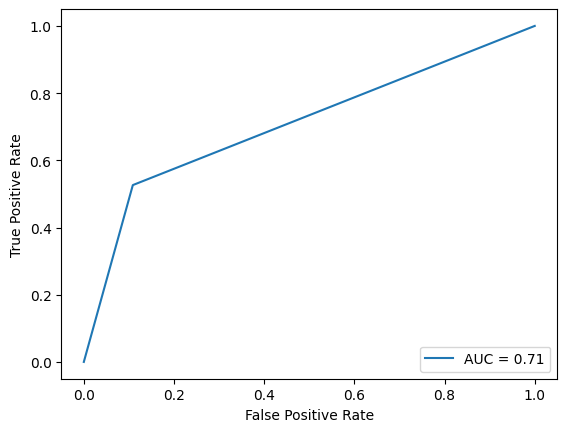

In [54]:
RocCurveDisplay(fpr=fpr,tpr=tpr,roc_auc=roc_auc).plot()

In [55]:
logistic_model.n_features_in_

8

## 2. Logistic Regression CV

In [79]:
from sklearn.linear_model import LogisticRegressionCV
lr_cv = LogisticRegressionCV(Cs=[0.1,1,5,10,50,100],cv=5,solver='saga' , penalty='elasticnet',l1_ratios=[0.1,0.01,1,0.05])

In [80]:
lr_cv.fit(scaled_Xtrain,y_train)

LogisticRegressionCV(Cs=[0.1, 1, 5, 10, 50, 100], cv=5,
                     l1_ratios=[0.1, 0.01, 1, 0.05], penalty='elasticnet',
                     solver='saga')

In [82]:
ypredlrcv = lr_cv.predict(scaled_Xtrest)

In [83]:
lr_cv.coef_

array([[0.31708461, 0.78886788, 0.11348722, 0.17723978, 0.19920061,
        0.30873241, 0.23840187, 0.35020843]])

In [84]:
confusion_matrix(y_test,ypredlrcv)

array([[82, 10],
       [19, 19]])

In [86]:
accuracy_score(y_test,ypredlrcv)

0.7769230769230769

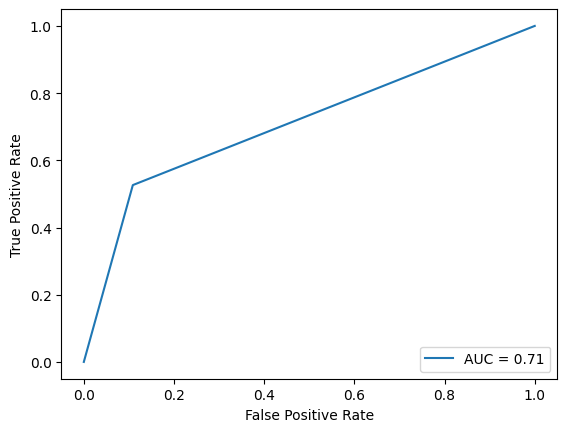

In [87]:
fpr, tpr, thresholds = roc_curve(y_test,ypred)
roc_auc = auc(fpr,tpr)
RocCurveDisplay(fpr=fpr,tpr=tpr,roc_auc=roc_auc).plot()

## 3. Random Forrest Classifier

In [11]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import GridSearchCV

In [91]:
model = RandomForestClassifier(n_estimators=1000,max_features='sqrt',random_state=42)

In [92]:
model.fit(X_train,y_train)

RandomForestClassifier(n_estimators=1000, random_state=42)

In [93]:
ypredrfc = model.predict(X_test)

In [94]:
from sklearn.metrics import pair_confusion_matrix

In [96]:
confusion_matrix(y_test,ypredrfc)

array([[80, 12],
       [20, 18]])

In [97]:
accuracy_score(y_test,ypredrfc)

0.7538461538461538

In [24]:
param_grid = {'n_estimators':[50,100,500,1000],'criterion':['gini',"entropy", "log_loss"],'warm_start':[True,False],'oob_score':[True,False],'bootstrap':[True,False],'max_features':["sqrt", "log2", None]}

In [38]:
grid_modal_randforres = GridSearchCV(estimator=RandomForestClassifier(),
                                    param_grid=param_grid,
                                    cv = 4,
                                    scoring = 'accuracy',
                                    verbose = 2)

In [35]:
from sklearn.metrics import get_scorer_names

In [37]:
get_scorer_names()

['accuracy',
 'adjusted_mutual_info_score',
 'adjusted_rand_score',
 'average_precision',
 'balanced_accuracy',
 'completeness_score',
 'explained_variance',
 'f1',
 'f1_macro',
 'f1_micro',
 'f1_samples',
 'f1_weighted',
 'fowlkes_mallows_score',
 'homogeneity_score',
 'jaccard',
 'jaccard_macro',
 'jaccard_micro',
 'jaccard_samples',
 'jaccard_weighted',
 'matthews_corrcoef',
 'max_error',
 'mutual_info_score',
 'neg_brier_score',
 'neg_log_loss',
 'neg_mean_absolute_error',
 'neg_mean_absolute_percentage_error',
 'neg_mean_gamma_deviance',
 'neg_mean_poisson_deviance',
 'neg_mean_squared_error',
 'neg_mean_squared_log_error',
 'neg_median_absolute_error',
 'neg_negative_likelihood_ratio',
 'neg_root_mean_squared_error',
 'normalized_mutual_info_score',
 'positive_likelihood_ratio',
 'precision',
 'precision_macro',
 'precision_micro',
 'precision_samples',
 'precision_weighted',
 'r2',
 'rand_score',
 'recall',
 'recall_macro',
 'recall_micro',
 'recall_samples',
 'recall_weighted',

In [39]:
grid_modal_randforres.fit(X_train,y_train)

Fitting 4 folds for each of 288 candidates, totalling 1152 fits
[CV] END bootstrap=True, criterion=gini, max_features=sqrt, n_estimators=50, oob_score=True, warm_start=True; total time=   0.1s
[CV] END bootstrap=True, criterion=gini, max_features=sqrt, n_estimators=50, oob_score=True, warm_start=True; total time=   0.1s
[CV] END bootstrap=True, criterion=gini, max_features=sqrt, n_estimators=50, oob_score=True, warm_start=True; total time=   0.1s
[CV] END bootstrap=True, criterion=gini, max_features=sqrt, n_estimators=50, oob_score=True, warm_start=True; total time=   0.1s
[CV] END bootstrap=True, criterion=gini, max_features=sqrt, n_estimators=50, oob_score=True, warm_start=False; total time=   0.1s
[CV] END bootstrap=True, criterion=gini, max_features=sqrt, n_estimators=50, oob_score=True, warm_start=False; total time=   0.1s
[CV] END bootstrap=True, criterion=gini, max_features=sqrt, n_estimators=50, oob_score=True, warm_start=False; total time=   0.1s
[CV] END bootstrap=True, crite

[CV] END bootstrap=True, criterion=gini, max_features=sqrt, n_estimators=1000, oob_score=False, warm_start=False; total time=   1.7s
[CV] END bootstrap=True, criterion=gini, max_features=log2, n_estimators=50, oob_score=True, warm_start=True; total time=   0.1s
[CV] END bootstrap=True, criterion=gini, max_features=log2, n_estimators=50, oob_score=True, warm_start=True; total time=   0.2s
[CV] END bootstrap=True, criterion=gini, max_features=log2, n_estimators=50, oob_score=True, warm_start=True; total time=   0.1s
[CV] END bootstrap=True, criterion=gini, max_features=log2, n_estimators=50, oob_score=True, warm_start=True; total time=   0.1s
[CV] END bootstrap=True, criterion=gini, max_features=log2, n_estimators=50, oob_score=True, warm_start=False; total time=   0.1s
[CV] END bootstrap=True, criterion=gini, max_features=log2, n_estimators=50, oob_score=True, warm_start=False; total time=   0.1s
[CV] END bootstrap=True, criterion=gini, max_features=log2, n_estimators=50, oob_score=True

[CV] END bootstrap=True, criterion=gini, max_features=log2, n_estimators=1000, oob_score=False, warm_start=False; total time=   1.5s
[CV] END bootstrap=True, criterion=gini, max_features=log2, n_estimators=1000, oob_score=False, warm_start=False; total time=   1.7s
[CV] END bootstrap=True, criterion=gini, max_features=None, n_estimators=50, oob_score=True, warm_start=True; total time=   0.1s
[CV] END bootstrap=True, criterion=gini, max_features=None, n_estimators=50, oob_score=True, warm_start=True; total time=   0.1s
[CV] END bootstrap=True, criterion=gini, max_features=None, n_estimators=50, oob_score=True, warm_start=True; total time=   0.1s
[CV] END bootstrap=True, criterion=gini, max_features=None, n_estimators=50, oob_score=True, warm_start=True; total time=   0.1s
[CV] END bootstrap=True, criterion=gini, max_features=None, n_estimators=50, oob_score=True, warm_start=False; total time=   0.1s
[CV] END bootstrap=True, criterion=gini, max_features=None, n_estimators=50, oob_score=T

[CV] END bootstrap=True, criterion=gini, max_features=None, n_estimators=1000, oob_score=False, warm_start=False; total time=   2.2s
[CV] END bootstrap=True, criterion=gini, max_features=None, n_estimators=1000, oob_score=False, warm_start=False; total time=   2.0s
[CV] END bootstrap=True, criterion=gini, max_features=None, n_estimators=1000, oob_score=False, warm_start=False; total time=   2.0s
[CV] END bootstrap=True, criterion=entropy, max_features=sqrt, n_estimators=50, oob_score=True, warm_start=True; total time=   0.1s
[CV] END bootstrap=True, criterion=entropy, max_features=sqrt, n_estimators=50, oob_score=True, warm_start=True; total time=   0.1s
[CV] END bootstrap=True, criterion=entropy, max_features=sqrt, n_estimators=50, oob_score=True, warm_start=True; total time=   0.1s
[CV] END bootstrap=True, criterion=entropy, max_features=sqrt, n_estimators=50, oob_score=True, warm_start=True; total time=   0.1s
[CV] END bootstrap=True, criterion=entropy, max_features=sqrt, n_estimato

[CV] END bootstrap=True, criterion=entropy, max_features=sqrt, n_estimators=1000, oob_score=False, warm_start=True; total time=   1.6s
[CV] END bootstrap=True, criterion=entropy, max_features=sqrt, n_estimators=1000, oob_score=False, warm_start=False; total time=   1.6s
[CV] END bootstrap=True, criterion=entropy, max_features=sqrt, n_estimators=1000, oob_score=False, warm_start=False; total time=   1.6s
[CV] END bootstrap=True, criterion=entropy, max_features=sqrt, n_estimators=1000, oob_score=False, warm_start=False; total time=   1.9s
[CV] END bootstrap=True, criterion=entropy, max_features=sqrt, n_estimators=1000, oob_score=False, warm_start=False; total time=   1.6s
[CV] END bootstrap=True, criterion=entropy, max_features=log2, n_estimators=50, oob_score=True, warm_start=True; total time=   0.1s
[CV] END bootstrap=True, criterion=entropy, max_features=log2, n_estimators=50, oob_score=True, warm_start=True; total time=   0.1s
[CV] END bootstrap=True, criterion=entropy, max_features=

[CV] END bootstrap=True, criterion=entropy, max_features=log2, n_estimators=1000, oob_score=False, warm_start=True; total time=   1.7s
[CV] END bootstrap=True, criterion=entropy, max_features=log2, n_estimators=1000, oob_score=False, warm_start=True; total time=   1.8s
[CV] END bootstrap=True, criterion=entropy, max_features=log2, n_estimators=1000, oob_score=False, warm_start=True; total time=   1.7s
[CV] END bootstrap=True, criterion=entropy, max_features=log2, n_estimators=1000, oob_score=False, warm_start=False; total time=   2.0s
[CV] END bootstrap=True, criterion=entropy, max_features=log2, n_estimators=1000, oob_score=False, warm_start=False; total time=   2.0s
[CV] END bootstrap=True, criterion=entropy, max_features=log2, n_estimators=1000, oob_score=False, warm_start=False; total time=   2.0s
[CV] END bootstrap=True, criterion=entropy, max_features=log2, n_estimators=1000, oob_score=False, warm_start=False; total time=   1.7s
[CV] END bootstrap=True, criterion=entropy, max_fea

[CV] END bootstrap=True, criterion=entropy, max_features=None, n_estimators=1000, oob_score=True, warm_start=False; total time=   3.4s
[CV] END bootstrap=True, criterion=entropy, max_features=None, n_estimators=1000, oob_score=False, warm_start=True; total time=   2.4s
[CV] END bootstrap=True, criterion=entropy, max_features=None, n_estimators=1000, oob_score=False, warm_start=True; total time=   2.2s
[CV] END bootstrap=True, criterion=entropy, max_features=None, n_estimators=1000, oob_score=False, warm_start=True; total time=   2.0s
[CV] END bootstrap=True, criterion=entropy, max_features=None, n_estimators=1000, oob_score=False, warm_start=True; total time=   2.1s
[CV] END bootstrap=True, criterion=entropy, max_features=None, n_estimators=1000, oob_score=False, warm_start=False; total time=   2.0s
[CV] END bootstrap=True, criterion=entropy, max_features=None, n_estimators=1000, oob_score=False, warm_start=False; total time=   1.8s
[CV] END bootstrap=True, criterion=entropy, max_featu

[CV] END bootstrap=True, criterion=log_loss, max_features=sqrt, n_estimators=1000, oob_score=True, warm_start=False; total time=   2.1s
[CV] END bootstrap=True, criterion=log_loss, max_features=sqrt, n_estimators=1000, oob_score=True, warm_start=False; total time=   2.1s
[CV] END bootstrap=True, criterion=log_loss, max_features=sqrt, n_estimators=1000, oob_score=True, warm_start=False; total time=   2.3s
[CV] END bootstrap=True, criterion=log_loss, max_features=sqrt, n_estimators=1000, oob_score=True, warm_start=False; total time=   2.3s
[CV] END bootstrap=True, criterion=log_loss, max_features=sqrt, n_estimators=1000, oob_score=False, warm_start=True; total time=   2.0s
[CV] END bootstrap=True, criterion=log_loss, max_features=sqrt, n_estimators=1000, oob_score=False, warm_start=True; total time=   1.9s
[CV] END bootstrap=True, criterion=log_loss, max_features=sqrt, n_estimators=1000, oob_score=False, warm_start=True; total time=   1.7s
[CV] END bootstrap=True, criterion=log_loss, max

[CV] END bootstrap=True, criterion=log_loss, max_features=log2, n_estimators=1000, oob_score=True, warm_start=True; total time=   2.1s
[CV] END bootstrap=True, criterion=log_loss, max_features=log2, n_estimators=1000, oob_score=True, warm_start=True; total time=   2.1s
[CV] END bootstrap=True, criterion=log_loss, max_features=log2, n_estimators=1000, oob_score=True, warm_start=True; total time=   2.0s
[CV] END bootstrap=True, criterion=log_loss, max_features=log2, n_estimators=1000, oob_score=True, warm_start=False; total time=   2.1s
[CV] END bootstrap=True, criterion=log_loss, max_features=log2, n_estimators=1000, oob_score=True, warm_start=False; total time=   2.0s
[CV] END bootstrap=True, criterion=log_loss, max_features=log2, n_estimators=1000, oob_score=True, warm_start=False; total time=   2.0s
[CV] END bootstrap=True, criterion=log_loss, max_features=log2, n_estimators=1000, oob_score=True, warm_start=False; total time=   2.0s
[CV] END bootstrap=True, criterion=log_loss, max_fe

[CV] END bootstrap=True, criterion=log_loss, max_features=None, n_estimators=500, oob_score=False, warm_start=False; total time=   1.0s
[CV] END bootstrap=True, criterion=log_loss, max_features=None, n_estimators=500, oob_score=False, warm_start=False; total time=   1.0s
[CV] END bootstrap=True, criterion=log_loss, max_features=None, n_estimators=1000, oob_score=True, warm_start=True; total time=   2.3s
[CV] END bootstrap=True, criterion=log_loss, max_features=None, n_estimators=1000, oob_score=True, warm_start=True; total time=   2.6s
[CV] END bootstrap=True, criterion=log_loss, max_features=None, n_estimators=1000, oob_score=True, warm_start=True; total time=   2.7s
[CV] END bootstrap=True, criterion=log_loss, max_features=None, n_estimators=1000, oob_score=True, warm_start=True; total time=   2.6s
[CV] END bootstrap=True, criterion=log_loss, max_features=None, n_estimators=1000, oob_score=True, warm_start=False; total time=   2.6s
[CV] END bootstrap=True, criterion=log_loss, max_fea

[CV] END bootstrap=False, criterion=gini, max_features=sqrt, n_estimators=500, oob_score=False, warm_start=False; total time=   0.7s
[CV] END bootstrap=False, criterion=gini, max_features=sqrt, n_estimators=500, oob_score=False, warm_start=False; total time=   0.6s
[CV] END bootstrap=False, criterion=gini, max_features=sqrt, n_estimators=500, oob_score=False, warm_start=False; total time=   0.7s
[CV] END bootstrap=False, criterion=gini, max_features=sqrt, n_estimators=500, oob_score=False, warm_start=False; total time=   0.8s
[CV] END bootstrap=False, criterion=gini, max_features=sqrt, n_estimators=1000, oob_score=True, warm_start=True; total time=   0.0s
[CV] END bootstrap=False, criterion=gini, max_features=sqrt, n_estimators=1000, oob_score=True, warm_start=True; total time=   0.0s
[CV] END bootstrap=False, criterion=gini, max_features=sqrt, n_estimators=1000, oob_score=True, warm_start=True; total time=   0.0s
[CV] END bootstrap=False, criterion=gini, max_features=sqrt, n_estimator

[CV] END bootstrap=False, criterion=gini, max_features=log2, n_estimators=500, oob_score=False, warm_start=True; total time=   0.8s
[CV] END bootstrap=False, criterion=gini, max_features=log2, n_estimators=500, oob_score=False, warm_start=False; total time=   0.8s
[CV] END bootstrap=False, criterion=gini, max_features=log2, n_estimators=500, oob_score=False, warm_start=False; total time=   0.7s
[CV] END bootstrap=False, criterion=gini, max_features=log2, n_estimators=500, oob_score=False, warm_start=False; total time=   0.7s
[CV] END bootstrap=False, criterion=gini, max_features=log2, n_estimators=500, oob_score=False, warm_start=False; total time=   0.7s
[CV] END bootstrap=False, criterion=gini, max_features=log2, n_estimators=1000, oob_score=True, warm_start=True; total time=   0.0s
[CV] END bootstrap=False, criterion=gini, max_features=log2, n_estimators=1000, oob_score=True, warm_start=True; total time=   0.0s
[CV] END bootstrap=False, criterion=gini, max_features=log2, n_estimator

[CV] END bootstrap=False, criterion=gini, max_features=None, n_estimators=500, oob_score=False, warm_start=True; total time=   0.9s
[CV] END bootstrap=False, criterion=gini, max_features=None, n_estimators=500, oob_score=False, warm_start=True; total time=   0.9s
[CV] END bootstrap=False, criterion=gini, max_features=None, n_estimators=500, oob_score=False, warm_start=False; total time=   0.9s
[CV] END bootstrap=False, criterion=gini, max_features=None, n_estimators=500, oob_score=False, warm_start=False; total time=   0.9s
[CV] END bootstrap=False, criterion=gini, max_features=None, n_estimators=500, oob_score=False, warm_start=False; total time=   1.0s
[CV] END bootstrap=False, criterion=gini, max_features=None, n_estimators=500, oob_score=False, warm_start=False; total time=   1.3s
[CV] END bootstrap=False, criterion=gini, max_features=None, n_estimators=1000, oob_score=True, warm_start=True; total time=   0.0s
[CV] END bootstrap=False, criterion=gini, max_features=None, n_estimator

[CV] END bootstrap=False, criterion=entropy, max_features=sqrt, n_estimators=500, oob_score=False, warm_start=True; total time=   0.9s
[CV] END bootstrap=False, criterion=entropy, max_features=sqrt, n_estimators=500, oob_score=False, warm_start=True; total time=   0.8s
[CV] END bootstrap=False, criterion=entropy, max_features=sqrt, n_estimators=500, oob_score=False, warm_start=True; total time=   1.0s
[CV] END bootstrap=False, criterion=entropy, max_features=sqrt, n_estimators=500, oob_score=False, warm_start=True; total time=   0.9s
[CV] END bootstrap=False, criterion=entropy, max_features=sqrt, n_estimators=500, oob_score=False, warm_start=False; total time=   0.7s
[CV] END bootstrap=False, criterion=entropy, max_features=sqrt, n_estimators=500, oob_score=False, warm_start=False; total time=   0.7s
[CV] END bootstrap=False, criterion=entropy, max_features=sqrt, n_estimators=500, oob_score=False, warm_start=False; total time=   0.7s
[CV] END bootstrap=False, criterion=entropy, max_fea

[CV] END bootstrap=False, criterion=entropy, max_features=log2, n_estimators=500, oob_score=False, warm_start=True; total time=   1.0s
[CV] END bootstrap=False, criterion=entropy, max_features=log2, n_estimators=500, oob_score=False, warm_start=True; total time=   0.9s
[CV] END bootstrap=False, criterion=entropy, max_features=log2, n_estimators=500, oob_score=False, warm_start=True; total time=   0.9s
[CV] END bootstrap=False, criterion=entropy, max_features=log2, n_estimators=500, oob_score=False, warm_start=True; total time=   0.8s
[CV] END bootstrap=False, criterion=entropy, max_features=log2, n_estimators=500, oob_score=False, warm_start=False; total time=   0.8s
[CV] END bootstrap=False, criterion=entropy, max_features=log2, n_estimators=500, oob_score=False, warm_start=False; total time=   0.8s
[CV] END bootstrap=False, criterion=entropy, max_features=log2, n_estimators=500, oob_score=False, warm_start=False; total time=   0.8s
[CV] END bootstrap=False, criterion=entropy, max_fea

[CV] END bootstrap=False, criterion=entropy, max_features=None, n_estimators=500, oob_score=True, warm_start=False; total time=   0.0s
[CV] END bootstrap=False, criterion=entropy, max_features=None, n_estimators=500, oob_score=False, warm_start=True; total time=   1.3s
[CV] END bootstrap=False, criterion=entropy, max_features=None, n_estimators=500, oob_score=False, warm_start=True; total time=   1.6s
[CV] END bootstrap=False, criterion=entropy, max_features=None, n_estimators=500, oob_score=False, warm_start=True; total time=   1.1s
[CV] END bootstrap=False, criterion=entropy, max_features=None, n_estimators=500, oob_score=False, warm_start=True; total time=   1.1s
[CV] END bootstrap=False, criterion=entropy, max_features=None, n_estimators=500, oob_score=False, warm_start=False; total time=   1.1s
[CV] END bootstrap=False, criterion=entropy, max_features=None, n_estimators=500, oob_score=False, warm_start=False; total time=   1.1s
[CV] END bootstrap=False, criterion=entropy, max_feat

[CV] END bootstrap=False, criterion=log_loss, max_features=sqrt, n_estimators=500, oob_score=False, warm_start=True; total time=   0.7s
[CV] END bootstrap=False, criterion=log_loss, max_features=sqrt, n_estimators=500, oob_score=False, warm_start=True; total time=   1.0s
[CV] END bootstrap=False, criterion=log_loss, max_features=sqrt, n_estimators=500, oob_score=False, warm_start=True; total time=   1.1s
[CV] END bootstrap=False, criterion=log_loss, max_features=sqrt, n_estimators=500, oob_score=False, warm_start=True; total time=   0.8s
[CV] END bootstrap=False, criterion=log_loss, max_features=sqrt, n_estimators=500, oob_score=False, warm_start=False; total time=   1.1s
[CV] END bootstrap=False, criterion=log_loss, max_features=sqrt, n_estimators=500, oob_score=False, warm_start=False; total time=   0.7s
[CV] END bootstrap=False, criterion=log_loss, max_features=sqrt, n_estimators=500, oob_score=False, warm_start=False; total time=   1.0s
[CV] END bootstrap=False, criterion=log_loss,

[CV] END bootstrap=False, criterion=log_loss, max_features=log2, n_estimators=500, oob_score=True, warm_start=False; total time=   0.0s
[CV] END bootstrap=False, criterion=log_loss, max_features=log2, n_estimators=500, oob_score=True, warm_start=False; total time=   0.0s
[CV] END bootstrap=False, criterion=log_loss, max_features=log2, n_estimators=500, oob_score=True, warm_start=False; total time=   0.0s
[CV] END bootstrap=False, criterion=log_loss, max_features=log2, n_estimators=500, oob_score=False, warm_start=True; total time=   1.0s
[CV] END bootstrap=False, criterion=log_loss, max_features=log2, n_estimators=500, oob_score=False, warm_start=True; total time=   0.7s
[CV] END bootstrap=False, criterion=log_loss, max_features=log2, n_estimators=500, oob_score=False, warm_start=True; total time=   0.7s
[CV] END bootstrap=False, criterion=log_loss, max_features=log2, n_estimators=500, oob_score=False, warm_start=True; total time=   0.7s
[CV] END bootstrap=False, criterion=log_loss, ma

[CV] END bootstrap=False, criterion=log_loss, max_features=None, n_estimators=500, oob_score=False, warm_start=True; total time=   1.0s
[CV] END bootstrap=False, criterion=log_loss, max_features=None, n_estimators=500, oob_score=False, warm_start=True; total time=   1.0s
[CV] END bootstrap=False, criterion=log_loss, max_features=None, n_estimators=500, oob_score=False, warm_start=True; total time=   1.0s
[CV] END bootstrap=False, criterion=log_loss, max_features=None, n_estimators=500, oob_score=False, warm_start=True; total time=   1.0s
[CV] END bootstrap=False, criterion=log_loss, max_features=None, n_estimators=500, oob_score=False, warm_start=False; total time=   1.1s
[CV] END bootstrap=False, criterion=log_loss, max_features=None, n_estimators=500, oob_score=False, warm_start=False; total time=   0.9s
[CV] END bootstrap=False, criterion=log_loss, max_features=None, n_estimators=500, oob_score=False, warm_start=False; total time=   1.1s
[CV] END bootstrap=False, criterion=log_loss,

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
288 fits failed out of a total of 1152.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
288 fits failed with the following error:
Traceback (most recent call last):
  File "/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/ensemble/_forest.py", line 434, in fit
    raise ValueError("Out of bag estimation only available if bootstrap=True")
ValueError: Out of bag estimation only available if bootstrap=True

  warnings.warn(som

GridSearchCV(cv=4, estimator=RandomForestClassifier(),
             param_grid={'bootstrap': [True, False],
                         'criterion': ['gini', 'entropy', 'log_loss'],
                         'max_features': ['sqrt', 'log2', None],
                         'n_estimators': [50, 100, 500, 1000],
                         'oob_score': [True, False],
                         'warm_start': [True, False]},
             scoring='accuracy', verbose=2)

In [40]:
ypred_grid_random_forrest_classifier = grid_modal_randforres.predict(X_test)

In [43]:
confusion_matrix(y_test,ypred_grid_random_forrest_classifier)

array([[82, 10],
       [20, 18]])

In [44]:
accuracy_score(y_test,ypred_grid_random_forrest_classifier)

0.7692307692307693

## 4. SVMs

In [39]:
from sklearn.svm import SVC

In [40]:
svc = SVC()

In [64]:
help(SVC)

Help on class SVC in module sklearn.svm._classes:

class SVC(sklearn.svm._base.BaseSVC)
 |  SVC(*, C=1.0, kernel='rbf', degree=3, gamma='scale', coef0=0.0, shrinking=True, probability=False, tol=0.001, cache_size=200, class_weight=None, verbose=False, max_iter=-1, decision_function_shape='ovr', break_ties=False, random_state=None)
 |  
 |  C-Support Vector Classification.
 |  
 |  The implementation is based on libsvm. The fit time scales at least
 |  quadratically with the number of samples and may be impractical
 |  beyond tens of thousands of samples. For large datasets
 |  consider using :class:`~sklearn.svm.LinearSVC` or
 |  :class:`~sklearn.linear_model.SGDClassifier` instead, possibly after a
 |  :class:`~sklearn.kernel_approximation.Nystroem` transformer or
 |  other :ref:`kernel_approximation`.
 |  
 |  The multiclass support is handled according to a one-vs-one scheme.
 |  
 |  For details on the precise mathematical formulation of the provided
 |  kernel functions and how `g

In [41]:
param_grid_svm = {'C':[1.0,0.01,0.1], 'kernel':['linear', 'poly', 'rbf', 'sigmoid'], 
                  'degree':[3], 
                  'gamma':['scale']}

In [42]:
grid_model_svm = GridSearchCV(estimator=svc,param_grid=param_grid_svm,verbose=2)

In [43]:
grid_model_svm.fit(X_train,y_train)

Fitting 5 folds for each of 12 candidates, totalling 60 fits
[CV] END ........C=1.0, degree=3, gamma=scale, kernel=linear; total time=   0.8s
[CV] END ........C=1.0, degree=3, gamma=scale, kernel=linear; total time=   0.9s
[CV] END ........C=1.0, degree=3, gamma=scale, kernel=linear; total time=   1.4s
[CV] END ........C=1.0, degree=3, gamma=scale, kernel=linear; total time=   0.6s
[CV] END ........C=1.0, degree=3, gamma=scale, kernel=linear; total time=   0.8s
[CV] END ..........C=1.0, degree=3, gamma=scale, kernel=poly; total time=   0.0s
[CV] END ..........C=1.0, degree=3, gamma=scale, kernel=poly; total time=   0.0s
[CV] END ..........C=1.0, degree=3, gamma=scale, kernel=poly; total time=   0.0s
[CV] END ..........C=1.0, degree=3, gamma=scale, kernel=poly; total time=   0.0s
[CV] END ..........C=1.0, degree=3, gamma=scale, kernel=poly; total time=   0.0s
[CV] END ...........C=1.0, degree=3, gamma=scale, kernel=rbf; total time=   0.0s
[CV] END ...........C=1.0, degree=3, gamma=scale

GridSearchCV(estimator=SVC(),
             param_grid={'C': [1.0, 0.01, 0.1], 'degree': [3],
                         'gamma': ['scale'],
                         'kernel': ['linear', 'poly', 'rbf', 'sigmoid']},
             verbose=2)

In [45]:
ypred_svm = grid_model_svm.predict(X_test)

In [46]:
accuracy_score(y_test,ypred_svm)

0.7692307692307693

In [47]:
grid_model_svm.best_estimator_

SVC(C=0.01, kernel='linear')

In [48]:
param_grid_svm = {'C':[0.01,0.1,0.001], 'kernel':['linear', 'poly', 'rbf', 'sigmoid'], 
                  'degree':[3], 
                  'gamma':['scale']}

In [49]:
grid_model_svm1 = GridSearchCV(estimator=svc,param_grid=param_grid_svm)

In [50]:
grid_model_svm1.fit(X_test,y_test)

GridSearchCV(estimator=SVC(),
             param_grid={'C': [0.01, 0.1, 0.001], 'degree': [3],
                         'gamma': ['scale'],
                         'kernel': ['linear', 'poly', 'rbf', 'sigmoid']})

In [51]:
ypred_svm1 = grid_model_svm1.predict(X_test)

In [52]:
accuracy_score(y_test,ypred_svm1)

0.7769230769230769

In [53]:
grid_model_svm1.best_estimator_

SVC(C=0.1, kernel='poly')

In [54]:
param_grid_svm2 = {'C':[0.01,0.1,0.001], 'kernel':['linear', 'poly', 'rbf', 'sigmoid'], 
                  'degree':[3,4,2], 
                  'gamma':['scale']}
grid_model_svm2 = GridSearchCV(estimator=svc,param_grid=param_grid_svm2)
grid_model_svm2.fit(X_test,y_test)
ypred_svm2 = grid_model_svm2.predict(X_test)
accuracy_score(y_test,ypred_svm2)

0.7769230769230769

In [55]:
grid_model_svm2.best_estimator_

SVC(C=0.1, kernel='poly')

In [56]:
grid_model_svm2.best_score_

0.7846153846153847

In [153]:
grid_model_svm2.best_estimator_

SVC(C=0.1, kernel='poly')

## 5. AdaBoost CLassifier

In [1]:
from sklearn.ensemble import AdaBoostClassifier

In [12]:
ada = AdaBoostClassifier()

In [13]:
param_grid_ada = {'n_estimators':[50,100], 'learning_rate':[1.0,0.5,2], 
                  'algorithm':['SAMME.R','SAMME'],'random_state':[42]}

In [14]:
grid_ada = GridSearchCV(estimator=ada,param_grid=param_grid_ada)

In [15]:
grid_ada.fit(X_train,y_train)

GridSearchCV(estimator=AdaBoostClassifier(),
             param_grid={'algorithm': ['SAMME.R', 'SAMME'],
                         'learning_rate': [1.0, 0.5, 2],
                         'n_estimators': [50, 100], 'random_state': [42]})

In [16]:
ypred_ada = grid_ada.predict(X_test)

In [17]:
accuracy_score(y_test,ypred_ada)

0.7230769230769231

In [19]:
grid_ada.best_estimator_

AdaBoostClassifier(algorithm='SAMME', learning_rate=0.5, n_estimators=100,
                   random_state=42)

In [58]:
grid_ada.best_score_

0.7838171262699564

In [20]:
param_grid_ada1 = {'n_estimators':[100,150,200], 'learning_rate':[0.5,0.8,0.2], 
                  'algorithm':['SAMME.R','SAMME'],'random_state':[42]}

In [21]:
grid_ada1 = GridSearchCV(estimator=ada,param_grid=param_grid_ada1)

In [22]:
grid_ada1.fit(X_test,y_test)

GridSearchCV(estimator=AdaBoostClassifier(),
             param_grid={'algorithm': ['SAMME.R', 'SAMME'],
                         'learning_rate': [0.5, 0.8, 0.2],
                         'n_estimators': [100, 150, 200],
                         'random_state': [42]})

In [23]:
ypred_ada1 = grid_ada1.predict(X_test)

In [24]:
accuracy_score(y_test,ypred_ada1)

1.0

In [25]:
grid_ada1.best_estimator_

AdaBoostClassifier(learning_rate=0.5, n_estimators=200, random_state=42)

In [57]:
grid_ada1.best_score_

0.7923076923076924

In [68]:
print(classification_report(y_test,ypred_ada1))

              precision    recall  f1-score   support

           0       1.00      1.00      1.00        92
           1       1.00      1.00      1.00        38

    accuracy                           1.00       130
   macro avg       1.00      1.00      1.00       130
weighted avg       1.00      1.00      1.00       130



In [128]:
grid_ada1.best_estimator_.feature_importances_

array([0.055, 0.15 , 0.075, 0.075, 0.135, 0.145, 0.195, 0.17 ])

In [129]:
feats_grid = pd.DataFrame(index=X.columns,data=grid_ada1.best_estimator_.feature_importances_,columns=['Importance'])

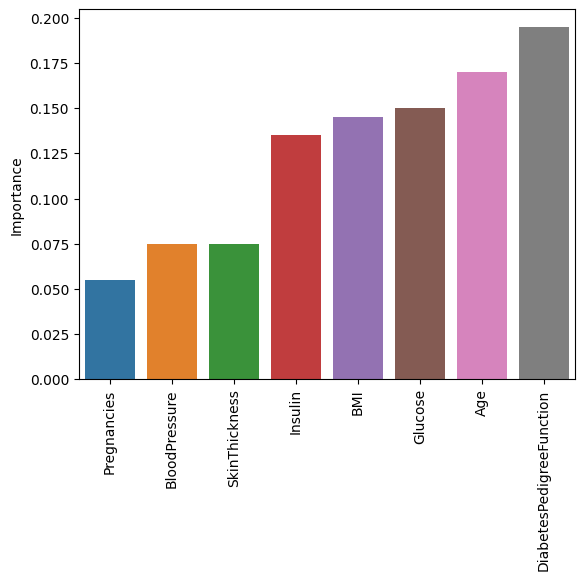

In [130]:
imp_feats_grid = feats_grid.sort_values("Importance")
sns.barplot(data=imp_feats_grid,x=imp_feats_grid.index,y='Importance')
plt.xticks(rotation=90);

In [116]:
ada1 = AdaBoostClassifier(learning_rate=0.5, n_estimators=95, random_state=42)

In [117]:
ada1.fit(X_train,y_train)

AdaBoostClassifier(learning_rate=0.5, n_estimators=95, random_state=42)

In [118]:
y_pred_ada1 = ada1.predict(X_test)

In [119]:
accuracy_score(y_test,y_pred_ada1)

0.7769230769230769

In [120]:
ada1.feature_importances_

array([0.04210526, 0.18947368, 0.09473684, 0.05263158, 0.14736842,
       0.11578947, 0.16842105, 0.18947368])

In [121]:
feats = pd.DataFrame(index=X.columns,data=ada1.feature_importances_,columns=['Importance'])

In [122]:
feats

,Importance
Pregnancies,0.042105
Glucose,0.189474
BloodPressure,0.094737
SkinThickness,0.052632
Insulin,0.147368
BMI,0.115789
DiabetesPedigreeFunction,0.168421
Age,0.189474


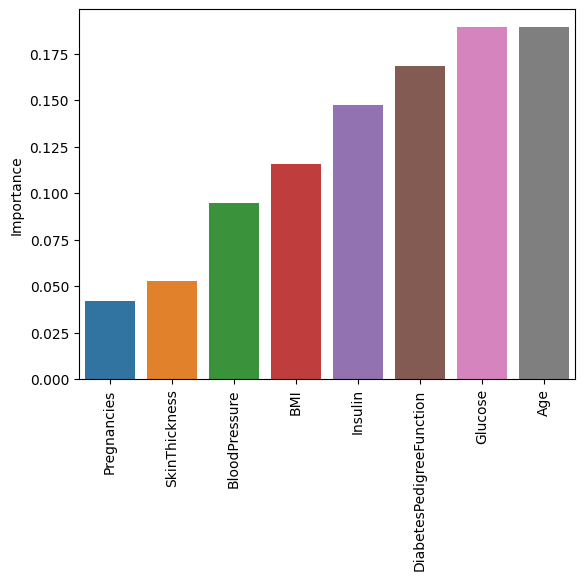

In [127]:
imp_feats = feats.sort_values("Importance")
sns.barplot(data=imp_feats,x=imp_feats.index,y='Importance')
plt.xticks(rotation=90);

## 6. Gradient Boosting

In [131]:
from sklearn.ensemble import GradientBoostingClassifier

In [132]:
gb = GradientBoostingClassifier()

In [135]:
param_grid_gb = {"n_estimators":[1,10,100],'max_depth':[3,4,5],
             'loss':['log_loss', 'exponential'],
             'learning_rate':[0.1,0.5,1],
             'criterion':['friedman_mse', 'squared_error']
             }

In [136]:
grid_gb = GridSearchCV(gb,param_grid_gb,verbose =2)

In [137]:
grid_gb.fit(X_train,y_train)
ypred_gb = grid_gb.predict(X_test)
accuracy_score(y_test,ypred_gb)

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/ensemble/_gb.py:280: FutureWarning: The loss parameter name 'deviance' was deprecated in v1.1 and will be removed in version 1.3. Use the new parameter name 'log_loss' which is equivalent.
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/ensemble/_gb.py:280: FutureWarning: The loss parameter name 'deviance' was deprecated in v1.1 and will be removed in version 1.3. Use the new parameter name 'log_loss' which is equivalent.
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/ensemble/_gb.py:280: FutureWarning: The loss parameter name 'deviance' was deprecated in v1.1 and will be removed in version 1.3. Use the new parameter name 'log_loss' which is equivalent.
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/ensemble/_gb.py:280: FutureWarning: The loss parameter name 'deviance' was deprecated in v1.1 and will be removed in versi

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/ensemble/_gb.py:280: FutureWarning: The loss parameter name 'deviance' was deprecated in v1.1 and will be removed in version 1.3. Use the new parameter name 'log_loss' which is equivalent.
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/ensemble/_gb.py:280: FutureWarning: The loss parameter name 'deviance' was deprecated in v1.1 and will be removed in version 1.3. Use the new parameter name 'log_loss' which is equivalent.
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/ensemble/_gb.py:280: FutureWarning: The loss parameter name 'deviance' was deprecated in v1.1 and will be removed in version 1.3. Use the new parameter name 'log_loss' which is equivalent.
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/ensemble/_gb.py:280: FutureWarning: The loss parameter name 'deviance' was deprecated in v1.1 and will be removed in versi

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/ensemble/_gb.py:280: FutureWarning: The loss parameter name 'deviance' was deprecated in v1.1 and will be removed in version 1.3. Use the new parameter name 'log_loss' which is equivalent.
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/ensemble/_gb.py:280: FutureWarning: The loss parameter name 'deviance' was deprecated in v1.1 and will be removed in version 1.3. Use the new parameter name 'log_loss' which is equivalent.
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/ensemble/_gb.py:280: FutureWarning: The loss parameter name 'deviance' was deprecated in v1.1 and will be removed in version 1.3. Use the new parameter name 'log_loss' which is equivalent.
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/ensemble/_gb.py:280: FutureWarning: The loss parameter name 'deviance' was deprecated in v1.1 and will be removed in versi

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/ensemble/_gb.py:280: FutureWarning: The loss parameter name 'deviance' was deprecated in v1.1 and will be removed in version 1.3. Use the new parameter name 'log_loss' which is equivalent.
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/ensemble/_gb.py:280: FutureWarning: The loss parameter name 'deviance' was deprecated in v1.1 and will be removed in version 1.3. Use the new parameter name 'log_loss' which is equivalent.
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/ensemble/_gb.py:280: FutureWarning: The loss parameter name 'deviance' was deprecated in v1.1 and will be removed in version 1.3. Use the new parameter name 'log_loss' which is equivalent.
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/ensemble/_gb.py:280: FutureWarning: The loss parameter name 'deviance' was deprecated in v1.1 and will be removed in versi

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/ensemble/_gb.py:280: FutureWarning: The loss parameter name 'deviance' was deprecated in v1.1 and will be removed in version 1.3. Use the new parameter name 'log_loss' which is equivalent.
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/ensemble/_gb.py:280: FutureWarning: The loss parameter name 'deviance' was deprecated in v1.1 and will be removed in version 1.3. Use the new parameter name 'log_loss' which is equivalent.
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/ensemble/_gb.py:280: FutureWarning: The loss parameter name 'deviance' was deprecated in v1.1 and will be removed in version 1.3. Use the new parameter name 'log_loss' which is equivalent.
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/ensemble/_gb.py:280: FutureWarning: The loss parameter name 'deviance' was deprecated in v1.1 and will be removed in versi

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/ensemble/_gb.py:280: FutureWarning: The loss parameter name 'deviance' was deprecated in v1.1 and will be removed in version 1.3. Use the new parameter name 'log_loss' which is equivalent.
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/ensemble/_gb.py:280: FutureWarning: The loss parameter name 'deviance' was deprecated in v1.1 and will be removed in version 1.3. Use the new parameter name 'log_loss' which is equivalent.
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/ensemble/_gb.py:280: FutureWarning: The loss parameter name 'deviance' was deprecated in v1.1 and will be removed in version 1.3. Use the new parameter name 'log_loss' which is equivalent.
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/ensemble/_gb.py:280: FutureWarning: The loss parameter name 'deviance' was deprecated in v1.1 and will be removed in versi

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/ensemble/_gb.py:280: FutureWarning: The loss parameter name 'deviance' was deprecated in v1.1 and will be removed in version 1.3. Use the new parameter name 'log_loss' which is equivalent.
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/ensemble/_gb.py:280: FutureWarning: The loss parameter name 'deviance' was deprecated in v1.1 and will be removed in version 1.3. Use the new parameter name 'log_loss' which is equivalent.
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/ensemble/_gb.py:280: FutureWarning: The loss parameter name 'deviance' was deprecated in v1.1 and will be removed in version 1.3. Use the new parameter name 'log_loss' which is equivalent.
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/ensemble/_gb.py:280: FutureWarning: The loss parameter name 'deviance' was deprecated in v1.1 and will be removed in versi

/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/ensemble/_gb.py:280: FutureWarning: The loss parameter name 'deviance' was deprecated in v1.1 and will be removed in version 1.3. Use the new parameter name 'log_loss' which is equivalent.
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/ensemble/_gb.py:280: FutureWarning: The loss parameter name 'deviance' was deprecated in v1.1 and will be removed in version 1.3. Use the new parameter name 'log_loss' which is equivalent.
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/ensemble/_gb.py:280: FutureWarning: The loss parameter name 'deviance' was deprecated in v1.1 and will be removed in version 1.3. Use the new parameter name 'log_loss' which is equivalent.
  warnings.warn(
/home/vip/Softwares/envs/dl/lib/python3.11/site-packages/sklearn/ensemble/_gb.py:280: FutureWarning: The loss parameter name 'deviance' was deprecated in v1.1 and will be removed in versi

0.7

In [138]:
grid_gb.best_estimator_

GradientBoostingClassifier(learning_rate=1, n_estimators=10)

In [139]:
param_grid_gb1 = {"n_estimators":[5,10,50],'max_depth':[3,4,5,6],
             'loss':['log_loss', 'exponential'],
             'learning_rate':[1,1.25,1.75],
             'criterion':['friedman_mse', 'squared_error']
             }
grid_gb1 = GridSearchCV(gb,param_grid_gb1,verbose =2)

In [140]:
grid_gb1.fit(X_train,y_train)
ypred_gb1 = grid_gb1.predict(X_test)


Fitting 5 folds for each of 144 candidates, totalling 720 fits
[CV] END criterion=friedman_mse, learning_rate=1, loss=log_loss, max_depth=3, n_estimators=5; total time=   0.0s
[CV] END criterion=friedman_mse, learning_rate=1, loss=log_loss, max_depth=3, n_estimators=5; total time=   0.0s
[CV] END criterion=friedman_mse, learning_rate=1, loss=log_loss, max_depth=3, n_estimators=5; total time=   0.0s
[CV] END criterion=friedman_mse, learning_rate=1, loss=log_loss, max_depth=3, n_estimators=5; total time=   0.0s
[CV] END criterion=friedman_mse, learning_rate=1, loss=log_loss, max_depth=3, n_estimators=5; total time=   0.0s
[CV] END criterion=friedman_mse, learning_rate=1, loss=log_loss, max_depth=3, n_estimators=10; total time=   0.0s
[CV] END criterion=friedman_mse, learning_rate=1, loss=log_loss, max_depth=3, n_estimators=10; total time=   0.0s
[CV] END criterion=friedman_mse, learning_rate=1, loss=log_loss, max_depth=3, n_estimators=10; total time=   0.0s
[CV] END criterion=friedman_ms

[CV] END criterion=friedman_mse, learning_rate=1, loss=exponential, max_depth=3, n_estimators=50; total time=   0.1s
[CV] END criterion=friedman_mse, learning_rate=1, loss=exponential, max_depth=3, n_estimators=50; total time=   0.1s
[CV] END criterion=friedman_mse, learning_rate=1, loss=exponential, max_depth=4, n_estimators=5; total time=   0.0s
[CV] END criterion=friedman_mse, learning_rate=1, loss=exponential, max_depth=4, n_estimators=5; total time=   0.0s
[CV] END criterion=friedman_mse, learning_rate=1, loss=exponential, max_depth=4, n_estimators=5; total time=   0.0s
[CV] END criterion=friedman_mse, learning_rate=1, loss=exponential, max_depth=4, n_estimators=5; total time=   0.0s
[CV] END criterion=friedman_mse, learning_rate=1, loss=exponential, max_depth=4, n_estimators=5; total time=   0.0s
[CV] END criterion=friedman_mse, learning_rate=1, loss=exponential, max_depth=4, n_estimators=10; total time=   0.0s
[CV] END criterion=friedman_mse, learning_rate=1, loss=exponential, m

[CV] END criterion=friedman_mse, learning_rate=1.25, loss=log_loss, max_depth=4, n_estimators=50; total time=   0.1s
[CV] END criterion=friedman_mse, learning_rate=1.25, loss=log_loss, max_depth=4, n_estimators=50; total time=   0.1s
[CV] END criterion=friedman_mse, learning_rate=1.25, loss=log_loss, max_depth=4, n_estimators=50; total time=   0.1s
[CV] END criterion=friedman_mse, learning_rate=1.25, loss=log_loss, max_depth=5, n_estimators=5; total time=   0.0s
[CV] END criterion=friedman_mse, learning_rate=1.25, loss=log_loss, max_depth=5, n_estimators=5; total time=   0.0s
[CV] END criterion=friedman_mse, learning_rate=1.25, loss=log_loss, max_depth=5, n_estimators=5; total time=   0.0s
[CV] END criterion=friedman_mse, learning_rate=1.25, loss=log_loss, max_depth=5, n_estimators=5; total time=   0.0s
[CV] END criterion=friedman_mse, learning_rate=1.25, loss=log_loss, max_depth=5, n_estimators=5; total time=   0.0s
[CV] END criterion=friedman_mse, learning_rate=1.25, loss=log_loss, m

[CV] END criterion=friedman_mse, learning_rate=1.25, loss=exponential, max_depth=5, n_estimators=10; total time=   0.0s
[CV] END criterion=friedman_mse, learning_rate=1.25, loss=exponential, max_depth=5, n_estimators=10; total time=   0.0s
[CV] END criterion=friedman_mse, learning_rate=1.25, loss=exponential, max_depth=5, n_estimators=10; total time=   0.0s
[CV] END criterion=friedman_mse, learning_rate=1.25, loss=exponential, max_depth=5, n_estimators=50; total time=   0.1s
[CV] END criterion=friedman_mse, learning_rate=1.25, loss=exponential, max_depth=5, n_estimators=50; total time=   0.1s
[CV] END criterion=friedman_mse, learning_rate=1.25, loss=exponential, max_depth=5, n_estimators=50; total time=   0.1s
[CV] END criterion=friedman_mse, learning_rate=1.25, loss=exponential, max_depth=5, n_estimators=50; total time=   0.1s
[CV] END criterion=friedman_mse, learning_rate=1.25, loss=exponential, max_depth=5, n_estimators=50; total time=   0.1s
[CV] END criterion=friedman_mse, learnin

[CV] END criterion=friedman_mse, learning_rate=1.75, loss=log_loss, max_depth=6, n_estimators=50; total time=   0.1s
[CV] END criterion=friedman_mse, learning_rate=1.75, loss=log_loss, max_depth=6, n_estimators=50; total time=   0.1s
[CV] END criterion=friedman_mse, learning_rate=1.75, loss=log_loss, max_depth=6, n_estimators=50; total time=   0.1s
[CV] END criterion=friedman_mse, learning_rate=1.75, loss=log_loss, max_depth=6, n_estimators=50; total time=   0.1s
[CV] END criterion=friedman_mse, learning_rate=1.75, loss=log_loss, max_depth=6, n_estimators=50; total time=   0.1s
[CV] END criterion=friedman_mse, learning_rate=1.75, loss=exponential, max_depth=3, n_estimators=5; total time=   0.0s
[CV] END criterion=friedman_mse, learning_rate=1.75, loss=exponential, max_depth=3, n_estimators=5; total time=   0.0s
[CV] END criterion=friedman_mse, learning_rate=1.75, loss=exponential, max_depth=3, n_estimators=5; total time=   0.0s
[CV] END criterion=friedman_mse, learning_rate=1.75, loss=

[CV] END criterion=squared_error, learning_rate=1, loss=log_loss, max_depth=3, n_estimators=10; total time=   0.0s
[CV] END criterion=squared_error, learning_rate=1, loss=log_loss, max_depth=3, n_estimators=10; total time=   0.0s
[CV] END criterion=squared_error, learning_rate=1, loss=log_loss, max_depth=3, n_estimators=10; total time=   0.0s
[CV] END criterion=squared_error, learning_rate=1, loss=log_loss, max_depth=3, n_estimators=10; total time=   0.0s
[CV] END criterion=squared_error, learning_rate=1, loss=log_loss, max_depth=3, n_estimators=50; total time=   0.1s
[CV] END criterion=squared_error, learning_rate=1, loss=log_loss, max_depth=3, n_estimators=50; total time=   0.1s
[CV] END criterion=squared_error, learning_rate=1, loss=log_loss, max_depth=3, n_estimators=50; total time=   0.1s
[CV] END criterion=squared_error, learning_rate=1, loss=log_loss, max_depth=3, n_estimators=50; total time=   0.1s
[CV] END criterion=squared_error, learning_rate=1, loss=log_loss, max_depth=3, n

[CV] END criterion=squared_error, learning_rate=1, loss=exponential, max_depth=4, n_estimators=50; total time=   0.1s
[CV] END criterion=squared_error, learning_rate=1, loss=exponential, max_depth=4, n_estimators=50; total time=   0.1s
[CV] END criterion=squared_error, learning_rate=1, loss=exponential, max_depth=4, n_estimators=50; total time=   0.1s
[CV] END criterion=squared_error, learning_rate=1, loss=exponential, max_depth=4, n_estimators=50; total time=   0.1s
[CV] END criterion=squared_error, learning_rate=1, loss=exponential, max_depth=4, n_estimators=50; total time=   0.1s
[CV] END criterion=squared_error, learning_rate=1, loss=exponential, max_depth=5, n_estimators=5; total time=   0.0s
[CV] END criterion=squared_error, learning_rate=1, loss=exponential, max_depth=5, n_estimators=5; total time=   0.0s
[CV] END criterion=squared_error, learning_rate=1, loss=exponential, max_depth=5, n_estimators=5; total time=   0.0s
[CV] END criterion=squared_error, learning_rate=1, loss=exp

[CV] END criterion=squared_error, learning_rate=1.25, loss=log_loss, max_depth=5, n_estimators=50; total time=   0.1s
[CV] END criterion=squared_error, learning_rate=1.25, loss=log_loss, max_depth=5, n_estimators=50; total time=   0.1s
[CV] END criterion=squared_error, learning_rate=1.25, loss=log_loss, max_depth=5, n_estimators=50; total time=   0.1s
[CV] END criterion=squared_error, learning_rate=1.25, loss=log_loss, max_depth=5, n_estimators=50; total time=   0.1s
[CV] END criterion=squared_error, learning_rate=1.25, loss=log_loss, max_depth=5, n_estimators=50; total time=   0.1s
[CV] END criterion=squared_error, learning_rate=1.25, loss=log_loss, max_depth=6, n_estimators=5; total time=   0.0s
[CV] END criterion=squared_error, learning_rate=1.25, loss=log_loss, max_depth=6, n_estimators=5; total time=   0.0s
[CV] END criterion=squared_error, learning_rate=1.25, loss=log_loss, max_depth=6, n_estimators=5; total time=   0.0s
[CV] END criterion=squared_error, learning_rate=1.25, loss=

[CV] END criterion=squared_error, learning_rate=1.25, loss=exponential, max_depth=6, n_estimators=10; total time=   0.0s
[CV] END criterion=squared_error, learning_rate=1.25, loss=exponential, max_depth=6, n_estimators=10; total time=   0.0s
[CV] END criterion=squared_error, learning_rate=1.25, loss=exponential, max_depth=6, n_estimators=10; total time=   0.0s
[CV] END criterion=squared_error, learning_rate=1.25, loss=exponential, max_depth=6, n_estimators=10; total time=   0.0s
[CV] END criterion=squared_error, learning_rate=1.25, loss=exponential, max_depth=6, n_estimators=50; total time=   0.1s
[CV] END criterion=squared_error, learning_rate=1.25, loss=exponential, max_depth=6, n_estimators=50; total time=   0.1s
[CV] END criterion=squared_error, learning_rate=1.25, loss=exponential, max_depth=6, n_estimators=50; total time=   0.1s
[CV] END criterion=squared_error, learning_rate=1.25, loss=exponential, max_depth=6, n_estimators=50; total time=   0.1s
[CV] END criterion=squared_error

[CV] END criterion=squared_error, learning_rate=1.75, loss=exponential, max_depth=3, n_estimators=50; total time=   0.1s
[CV] END criterion=squared_error, learning_rate=1.75, loss=exponential, max_depth=3, n_estimators=50; total time=   0.1s
[CV] END criterion=squared_error, learning_rate=1.75, loss=exponential, max_depth=3, n_estimators=50; total time=   0.1s
[CV] END criterion=squared_error, learning_rate=1.75, loss=exponential, max_depth=3, n_estimators=50; total time=   0.1s
[CV] END criterion=squared_error, learning_rate=1.75, loss=exponential, max_depth=4, n_estimators=5; total time=   0.0s
[CV] END criterion=squared_error, learning_rate=1.75, loss=exponential, max_depth=4, n_estimators=5; total time=   0.0s
[CV] END criterion=squared_error, learning_rate=1.75, loss=exponential, max_depth=4, n_estimators=5; total time=   0.0s
[CV] END criterion=squared_error, learning_rate=1.75, loss=exponential, max_depth=4, n_estimators=5; total time=   0.0s
[CV] END criterion=squared_error, le

0.7384615384615385

In [141]:
accuracy_score(y_test,ypred_gb1)

0.7384615384615385

In [142]:
grid_gb1.best_estimator_

GradientBoostingClassifier(learning_rate=1, max_depth=6, n_estimators=5)

In [147]:
param_grid_gb2 = {"n_estimators":[5,10,6,4],'max_depth':[3,4,5,6,7,8],
             'loss':['log_loss', 'exponential'],
             'learning_rate':[1,1.1,1.05],
             'criterion':['friedman_mse', 'squared_error']
             }
grid_gb2 = GridSearchCV(gb,param_grid_gb2,verbose =2)

In [148]:
grid_gb2.fit(X_train,y_train)
ypred_gb2 = grid_gb2.predict(X_test)

Fitting 5 folds for each of 288 candidates, totalling 1440 fits
[CV] END criterion=friedman_mse, learning_rate=1, loss=log_loss, max_depth=3, n_estimators=5; total time=   0.0s
[CV] END criterion=friedman_mse, learning_rate=1, loss=log_loss, max_depth=3, n_estimators=5; total time=   0.0s
[CV] END criterion=friedman_mse, learning_rate=1, loss=log_loss, max_depth=3, n_estimators=5; total time=   0.0s
[CV] END criterion=friedman_mse, learning_rate=1, loss=log_loss, max_depth=3, n_estimators=5; total time=   0.0s
[CV] END criterion=friedman_mse, learning_rate=1, loss=log_loss, max_depth=3, n_estimators=5; total time=   0.0s
[CV] END criterion=friedman_mse, learning_rate=1, loss=log_loss, max_depth=3, n_estimators=10; total time=   0.0s
[CV] END criterion=friedman_mse, learning_rate=1, loss=log_loss, max_depth=3, n_estimators=10; total time=   0.0s
[CV] END criterion=friedman_mse, learning_rate=1, loss=log_loss, max_depth=3, n_estimators=10; total time=   0.0s
[CV] END criterion=friedman_m

[CV] END criterion=friedman_mse, learning_rate=1, loss=log_loss, max_depth=6, n_estimators=6; total time=   0.0s
[CV] END criterion=friedman_mse, learning_rate=1, loss=log_loss, max_depth=6, n_estimators=4; total time=   0.0s
[CV] END criterion=friedman_mse, learning_rate=1, loss=log_loss, max_depth=6, n_estimators=4; total time=   0.0s
[CV] END criterion=friedman_mse, learning_rate=1, loss=log_loss, max_depth=6, n_estimators=4; total time=   0.0s
[CV] END criterion=friedman_mse, learning_rate=1, loss=log_loss, max_depth=6, n_estimators=4; total time=   0.0s
[CV] END criterion=friedman_mse, learning_rate=1, loss=log_loss, max_depth=6, n_estimators=4; total time=   0.0s
[CV] END criterion=friedman_mse, learning_rate=1, loss=log_loss, max_depth=7, n_estimators=5; total time=   0.0s
[CV] END criterion=friedman_mse, learning_rate=1, loss=log_loss, max_depth=7, n_estimators=5; total time=   0.0s
[CV] END criterion=friedman_mse, learning_rate=1, loss=log_loss, max_depth=7, n_estimators=5; to

[CV] END criterion=friedman_mse, learning_rate=1, loss=exponential, max_depth=4, n_estimators=4; total time=   0.0s
[CV] END criterion=friedman_mse, learning_rate=1, loss=exponential, max_depth=4, n_estimators=4; total time=   0.0s
[CV] END criterion=friedman_mse, learning_rate=1, loss=exponential, max_depth=4, n_estimators=4; total time=   0.0s
[CV] END criterion=friedman_mse, learning_rate=1, loss=exponential, max_depth=4, n_estimators=4; total time=   0.0s
[CV] END criterion=friedman_mse, learning_rate=1, loss=exponential, max_depth=4, n_estimators=4; total time=   0.0s
[CV] END criterion=friedman_mse, learning_rate=1, loss=exponential, max_depth=5, n_estimators=5; total time=   0.0s
[CV] END criterion=friedman_mse, learning_rate=1, loss=exponential, max_depth=5, n_estimators=5; total time=   0.0s
[CV] END criterion=friedman_mse, learning_rate=1, loss=exponential, max_depth=5, n_estimators=5; total time=   0.0s
[CV] END criterion=friedman_mse, learning_rate=1, loss=exponential, max_

[CV] END criterion=friedman_mse, learning_rate=1, loss=exponential, max_depth=8, n_estimators=10; total time=   0.0s
[CV] END criterion=friedman_mse, learning_rate=1, loss=exponential, max_depth=8, n_estimators=10; total time=   0.0s
[CV] END criterion=friedman_mse, learning_rate=1, loss=exponential, max_depth=8, n_estimators=10; total time=   0.0s
[CV] END criterion=friedman_mse, learning_rate=1, loss=exponential, max_depth=8, n_estimators=6; total time=   0.0s
[CV] END criterion=friedman_mse, learning_rate=1, loss=exponential, max_depth=8, n_estimators=6; total time=   0.0s
[CV] END criterion=friedman_mse, learning_rate=1, loss=exponential, max_depth=8, n_estimators=6; total time=   0.0s
[CV] END criterion=friedman_mse, learning_rate=1, loss=exponential, max_depth=8, n_estimators=6; total time=   0.0s
[CV] END criterion=friedman_mse, learning_rate=1, loss=exponential, max_depth=8, n_estimators=6; total time=   0.0s
[CV] END criterion=friedman_mse, learning_rate=1, loss=exponential, m

[CV] END criterion=friedman_mse, learning_rate=1.1, loss=log_loss, max_depth=6, n_estimators=10; total time=   0.0s
[CV] END criterion=friedman_mse, learning_rate=1.1, loss=log_loss, max_depth=6, n_estimators=10; total time=   0.0s
[CV] END criterion=friedman_mse, learning_rate=1.1, loss=log_loss, max_depth=6, n_estimators=10; total time=   0.0s
[CV] END criterion=friedman_mse, learning_rate=1.1, loss=log_loss, max_depth=6, n_estimators=10; total time=   0.0s
[CV] END criterion=friedman_mse, learning_rate=1.1, loss=log_loss, max_depth=6, n_estimators=6; total time=   0.0s
[CV] END criterion=friedman_mse, learning_rate=1.1, loss=log_loss, max_depth=6, n_estimators=6; total time=   0.0s
[CV] END criterion=friedman_mse, learning_rate=1.1, loss=log_loss, max_depth=6, n_estimators=6; total time=   0.0s
[CV] END criterion=friedman_mse, learning_rate=1.1, loss=log_loss, max_depth=6, n_estimators=6; total time=   0.0s
[CV] END criterion=friedman_mse, learning_rate=1.1, loss=log_loss, max_depth

[CV] END criterion=friedman_mse, learning_rate=1.1, loss=exponential, max_depth=4, n_estimators=10; total time=   0.0s
[CV] END criterion=friedman_mse, learning_rate=1.1, loss=exponential, max_depth=4, n_estimators=10; total time=   0.0s
[CV] END criterion=friedman_mse, learning_rate=1.1, loss=exponential, max_depth=4, n_estimators=10; total time=   0.0s
[CV] END criterion=friedman_mse, learning_rate=1.1, loss=exponential, max_depth=4, n_estimators=10; total time=   0.0s
[CV] END criterion=friedman_mse, learning_rate=1.1, loss=exponential, max_depth=4, n_estimators=10; total time=   0.0s
[CV] END criterion=friedman_mse, learning_rate=1.1, loss=exponential, max_depth=4, n_estimators=6; total time=   0.0s
[CV] END criterion=friedman_mse, learning_rate=1.1, loss=exponential, max_depth=4, n_estimators=6; total time=   0.0s
[CV] END criterion=friedman_mse, learning_rate=1.1, loss=exponential, max_depth=4, n_estimators=6; total time=   0.0s
[CV] END criterion=friedman_mse, learning_rate=1.1,

[CV] END criterion=friedman_mse, learning_rate=1.1, loss=exponential, max_depth=8, n_estimators=5; total time=   0.0s
[CV] END criterion=friedman_mse, learning_rate=1.1, loss=exponential, max_depth=8, n_estimators=5; total time=   0.0s
[CV] END criterion=friedman_mse, learning_rate=1.1, loss=exponential, max_depth=8, n_estimators=5; total time=   0.0s
[CV] END criterion=friedman_mse, learning_rate=1.1, loss=exponential, max_depth=8, n_estimators=5; total time=   0.0s
[CV] END criterion=friedman_mse, learning_rate=1.1, loss=exponential, max_depth=8, n_estimators=10; total time=   0.0s
[CV] END criterion=friedman_mse, learning_rate=1.1, loss=exponential, max_depth=8, n_estimators=10; total time=   0.0s
[CV] END criterion=friedman_mse, learning_rate=1.1, loss=exponential, max_depth=8, n_estimators=10; total time=   0.0s
[CV] END criterion=friedman_mse, learning_rate=1.1, loss=exponential, max_depth=8, n_estimators=10; total time=   0.0s
[CV] END criterion=friedman_mse, learning_rate=1.1, 

[CV] END criterion=friedman_mse, learning_rate=1.05, loss=log_loss, max_depth=6, n_estimators=5; total time=   0.0s
[CV] END criterion=friedman_mse, learning_rate=1.05, loss=log_loss, max_depth=6, n_estimators=5; total time=   0.0s
[CV] END criterion=friedman_mse, learning_rate=1.05, loss=log_loss, max_depth=6, n_estimators=5; total time=   0.0s
[CV] END criterion=friedman_mse, learning_rate=1.05, loss=log_loss, max_depth=6, n_estimators=5; total time=   0.0s
[CV] END criterion=friedman_mse, learning_rate=1.05, loss=log_loss, max_depth=6, n_estimators=5; total time=   0.0s
[CV] END criterion=friedman_mse, learning_rate=1.05, loss=log_loss, max_depth=6, n_estimators=10; total time=   0.0s
[CV] END criterion=friedman_mse, learning_rate=1.05, loss=log_loss, max_depth=6, n_estimators=10; total time=   0.0s
[CV] END criterion=friedman_mse, learning_rate=1.05, loss=log_loss, max_depth=6, n_estimators=10; total time=   0.0s
[CV] END criterion=friedman_mse, learning_rate=1.05, loss=log_loss, m

[CV] END criterion=friedman_mse, learning_rate=1.05, loss=exponential, max_depth=4, n_estimators=10; total time=   0.0s
[CV] END criterion=friedman_mse, learning_rate=1.05, loss=exponential, max_depth=4, n_estimators=10; total time=   0.0s
[CV] END criterion=friedman_mse, learning_rate=1.05, loss=exponential, max_depth=4, n_estimators=10; total time=   0.0s
[CV] END criterion=friedman_mse, learning_rate=1.05, loss=exponential, max_depth=4, n_estimators=6; total time=   0.0s
[CV] END criterion=friedman_mse, learning_rate=1.05, loss=exponential, max_depth=4, n_estimators=6; total time=   0.0s
[CV] END criterion=friedman_mse, learning_rate=1.05, loss=exponential, max_depth=4, n_estimators=6; total time=   0.0s
[CV] END criterion=friedman_mse, learning_rate=1.05, loss=exponential, max_depth=4, n_estimators=6; total time=   0.0s
[CV] END criterion=friedman_mse, learning_rate=1.05, loss=exponential, max_depth=4, n_estimators=6; total time=   0.0s
[CV] END criterion=friedman_mse, learning_rat

[CV] END criterion=friedman_mse, learning_rate=1.05, loss=exponential, max_depth=8, n_estimators=5; total time=   0.0s
[CV] END criterion=friedman_mse, learning_rate=1.05, loss=exponential, max_depth=8, n_estimators=5; total time=   0.0s
[CV] END criterion=friedman_mse, learning_rate=1.05, loss=exponential, max_depth=8, n_estimators=5; total time=   0.0s
[CV] END criterion=friedman_mse, learning_rate=1.05, loss=exponential, max_depth=8, n_estimators=5; total time=   0.0s
[CV] END criterion=friedman_mse, learning_rate=1.05, loss=exponential, max_depth=8, n_estimators=10; total time=   0.0s
[CV] END criterion=friedman_mse, learning_rate=1.05, loss=exponential, max_depth=8, n_estimators=10; total time=   0.0s
[CV] END criterion=friedman_mse, learning_rate=1.05, loss=exponential, max_depth=8, n_estimators=10; total time=   0.0s
[CV] END criterion=friedman_mse, learning_rate=1.05, loss=exponential, max_depth=8, n_estimators=10; total time=   0.0s
[CV] END criterion=friedman_mse, learning_ra

[CV] END criterion=squared_error, learning_rate=1, loss=log_loss, max_depth=5, n_estimators=6; total time=   0.0s
[CV] END criterion=squared_error, learning_rate=1, loss=log_loss, max_depth=5, n_estimators=6; total time=   0.0s
[CV] END criterion=squared_error, learning_rate=1, loss=log_loss, max_depth=5, n_estimators=4; total time=   0.0s
[CV] END criterion=squared_error, learning_rate=1, loss=log_loss, max_depth=5, n_estimators=4; total time=   0.0s
[CV] END criterion=squared_error, learning_rate=1, loss=log_loss, max_depth=5, n_estimators=4; total time=   0.0s
[CV] END criterion=squared_error, learning_rate=1, loss=log_loss, max_depth=5, n_estimators=4; total time=   0.0s
[CV] END criterion=squared_error, learning_rate=1, loss=log_loss, max_depth=5, n_estimators=4; total time=   0.0s
[CV] END criterion=squared_error, learning_rate=1, loss=log_loss, max_depth=6, n_estimators=5; total time=   0.0s
[CV] END criterion=squared_error, learning_rate=1, loss=log_loss, max_depth=6, n_estimat

[CV] END criterion=squared_error, learning_rate=1, loss=exponential, max_depth=3, n_estimators=6; total time=   0.0s
[CV] END criterion=squared_error, learning_rate=1, loss=exponential, max_depth=3, n_estimators=6; total time=   0.0s
[CV] END criterion=squared_error, learning_rate=1, loss=exponential, max_depth=3, n_estimators=4; total time=   0.0s
[CV] END criterion=squared_error, learning_rate=1, loss=exponential, max_depth=3, n_estimators=4; total time=   0.0s
[CV] END criterion=squared_error, learning_rate=1, loss=exponential, max_depth=3, n_estimators=4; total time=   0.0s
[CV] END criterion=squared_error, learning_rate=1, loss=exponential, max_depth=3, n_estimators=4; total time=   0.0s
[CV] END criterion=squared_error, learning_rate=1, loss=exponential, max_depth=3, n_estimators=4; total time=   0.0s
[CV] END criterion=squared_error, learning_rate=1, loss=exponential, max_depth=4, n_estimators=5; total time=   0.0s
[CV] END criterion=squared_error, learning_rate=1, loss=exponent

[CV] END criterion=squared_error, learning_rate=1, loss=exponential, max_depth=7, n_estimators=10; total time=   0.0s
[CV] END criterion=squared_error, learning_rate=1, loss=exponential, max_depth=7, n_estimators=10; total time=   0.0s
[CV] END criterion=squared_error, learning_rate=1, loss=exponential, max_depth=7, n_estimators=10; total time=   0.0s
[CV] END criterion=squared_error, learning_rate=1, loss=exponential, max_depth=7, n_estimators=6; total time=   0.0s
[CV] END criterion=squared_error, learning_rate=1, loss=exponential, max_depth=7, n_estimators=6; total time=   0.0s
[CV] END criterion=squared_error, learning_rate=1, loss=exponential, max_depth=7, n_estimators=6; total time=   0.0s
[CV] END criterion=squared_error, learning_rate=1, loss=exponential, max_depth=7, n_estimators=6; total time=   0.0s
[CV] END criterion=squared_error, learning_rate=1, loss=exponential, max_depth=7, n_estimators=6; total time=   0.0s
[CV] END criterion=squared_error, learning_rate=1, loss=expon

[CV] END criterion=squared_error, learning_rate=1.1, loss=log_loss, max_depth=5, n_estimators=10; total time=   0.0s
[CV] END criterion=squared_error, learning_rate=1.1, loss=log_loss, max_depth=5, n_estimators=10; total time=   0.0s
[CV] END criterion=squared_error, learning_rate=1.1, loss=log_loss, max_depth=5, n_estimators=6; total time=   0.0s
[CV] END criterion=squared_error, learning_rate=1.1, loss=log_loss, max_depth=5, n_estimators=6; total time=   0.0s
[CV] END criterion=squared_error, learning_rate=1.1, loss=log_loss, max_depth=5, n_estimators=6; total time=   0.0s
[CV] END criterion=squared_error, learning_rate=1.1, loss=log_loss, max_depth=5, n_estimators=6; total time=   0.0s
[CV] END criterion=squared_error, learning_rate=1.1, loss=log_loss, max_depth=5, n_estimators=6; total time=   0.0s
[CV] END criterion=squared_error, learning_rate=1.1, loss=log_loss, max_depth=5, n_estimators=4; total time=   0.0s
[CV] END criterion=squared_error, learning_rate=1.1, loss=log_loss, ma

[CV] END criterion=squared_error, learning_rate=1.1, loss=exponential, max_depth=3, n_estimators=5; total time=   0.0s
[CV] END criterion=squared_error, learning_rate=1.1, loss=exponential, max_depth=3, n_estimators=10; total time=   0.0s
[CV] END criterion=squared_error, learning_rate=1.1, loss=exponential, max_depth=3, n_estimators=10; total time=   0.0s
[CV] END criterion=squared_error, learning_rate=1.1, loss=exponential, max_depth=3, n_estimators=10; total time=   0.0s
[CV] END criterion=squared_error, learning_rate=1.1, loss=exponential, max_depth=3, n_estimators=10; total time=   0.0s
[CV] END criterion=squared_error, learning_rate=1.1, loss=exponential, max_depth=3, n_estimators=10; total time=   0.0s
[CV] END criterion=squared_error, learning_rate=1.1, loss=exponential, max_depth=3, n_estimators=6; total time=   0.0s
[CV] END criterion=squared_error, learning_rate=1.1, loss=exponential, max_depth=3, n_estimators=6; total time=   0.0s
[CV] END criterion=squared_error, learning_

[CV] END criterion=squared_error, learning_rate=1.1, loss=exponential, max_depth=6, n_estimators=4; total time=   0.0s
[CV] END criterion=squared_error, learning_rate=1.1, loss=exponential, max_depth=6, n_estimators=4; total time=   0.0s
[CV] END criterion=squared_error, learning_rate=1.1, loss=exponential, max_depth=6, n_estimators=4; total time=   0.0s
[CV] END criterion=squared_error, learning_rate=1.1, loss=exponential, max_depth=6, n_estimators=4; total time=   0.0s
[CV] END criterion=squared_error, learning_rate=1.1, loss=exponential, max_depth=6, n_estimators=4; total time=   0.0s
[CV] END criterion=squared_error, learning_rate=1.1, loss=exponential, max_depth=7, n_estimators=5; total time=   0.0s
[CV] END criterion=squared_error, learning_rate=1.1, loss=exponential, max_depth=7, n_estimators=5; total time=   0.0s
[CV] END criterion=squared_error, learning_rate=1.1, loss=exponential, max_depth=7, n_estimators=5; total time=   0.0s
[CV] END criterion=squared_error, learning_rate=

[CV] END criterion=squared_error, learning_rate=1.05, loss=log_loss, max_depth=4, n_estimators=4; total time=   0.0s
[CV] END criterion=squared_error, learning_rate=1.05, loss=log_loss, max_depth=4, n_estimators=4; total time=   0.0s
[CV] END criterion=squared_error, learning_rate=1.05, loss=log_loss, max_depth=4, n_estimators=4; total time=   0.0s
[CV] END criterion=squared_error, learning_rate=1.05, loss=log_loss, max_depth=4, n_estimators=4; total time=   0.0s
[CV] END criterion=squared_error, learning_rate=1.05, loss=log_loss, max_depth=4, n_estimators=4; total time=   0.0s
[CV] END criterion=squared_error, learning_rate=1.05, loss=log_loss, max_depth=5, n_estimators=5; total time=   0.0s
[CV] END criterion=squared_error, learning_rate=1.05, loss=log_loss, max_depth=5, n_estimators=5; total time=   0.0s
[CV] END criterion=squared_error, learning_rate=1.05, loss=log_loss, max_depth=5, n_estimators=5; total time=   0.0s
[CV] END criterion=squared_error, learning_rate=1.05, loss=log_l

[CV] END criterion=squared_error, learning_rate=1.05, loss=log_loss, max_depth=8, n_estimators=10; total time=   0.0s
[CV] END criterion=squared_error, learning_rate=1.05, loss=log_loss, max_depth=8, n_estimators=10; total time=   0.0s
[CV] END criterion=squared_error, learning_rate=1.05, loss=log_loss, max_depth=8, n_estimators=10; total time=   0.0s
[CV] END criterion=squared_error, learning_rate=1.05, loss=log_loss, max_depth=8, n_estimators=10; total time=   0.0s
[CV] END criterion=squared_error, learning_rate=1.05, loss=log_loss, max_depth=8, n_estimators=10; total time=   0.0s
[CV] END criterion=squared_error, learning_rate=1.05, loss=log_loss, max_depth=8, n_estimators=6; total time=   0.0s
[CV] END criterion=squared_error, learning_rate=1.05, loss=log_loss, max_depth=8, n_estimators=6; total time=   0.0s
[CV] END criterion=squared_error, learning_rate=1.05, loss=log_loss, max_depth=8, n_estimators=6; total time=   0.0s
[CV] END criterion=squared_error, learning_rate=1.05, loss=

[CV] END criterion=squared_error, learning_rate=1.05, loss=exponential, max_depth=6, n_estimators=5; total time=   0.0s
[CV] END criterion=squared_error, learning_rate=1.05, loss=exponential, max_depth=6, n_estimators=5; total time=   0.0s
[CV] END criterion=squared_error, learning_rate=1.05, loss=exponential, max_depth=6, n_estimators=5; total time=   0.0s
[CV] END criterion=squared_error, learning_rate=1.05, loss=exponential, max_depth=6, n_estimators=5; total time=   0.0s
[CV] END criterion=squared_error, learning_rate=1.05, loss=exponential, max_depth=6, n_estimators=10; total time=   0.0s
[CV] END criterion=squared_error, learning_rate=1.05, loss=exponential, max_depth=6, n_estimators=10; total time=   0.0s
[CV] END criterion=squared_error, learning_rate=1.05, loss=exponential, max_depth=6, n_estimators=10; total time=   0.0s
[CV] END criterion=squared_error, learning_rate=1.05, loss=exponential, max_depth=6, n_estimators=10; total time=   0.0s
[CV] END criterion=squared_error, le

In [149]:
accuracy_score(y_test,ypred_gb2)

0.7384615384615385

In [150]:
grid_gb2.best_estimator_

GradientBoostingClassifier(learning_rate=1.05, max_depth=4, n_estimators=6)

In [151]:
feats_gb = pd.DataFrame(index=X.columns,data=grid_gb2.best_estimator_.feature_importances_,columns=['Importance'])

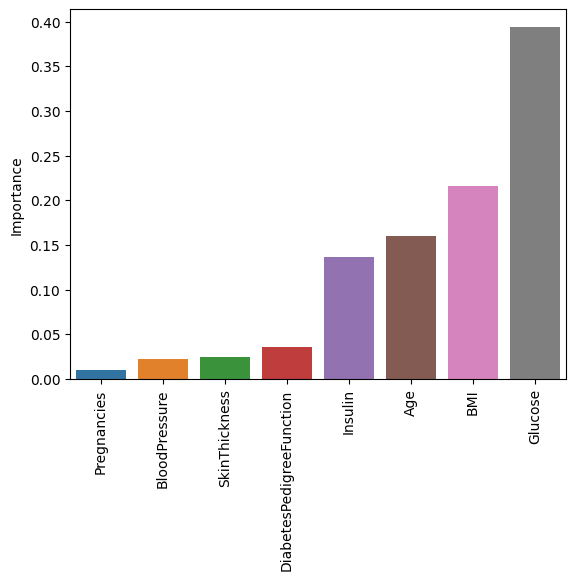

In [152]:
imp_feats_gb = feats_gb.sort_values("Importance")
sns.barplot(data=imp_feats_gb,x=imp_feats_gb.index,y='Importance')
plt.xticks(rotation=90);

## 7. Descision Trees

In [154]:
from sklearn.tree import DecisionTreeClassifier

In [155]:
tree = DecisionTreeClassifier()

In [161]:
param_grid_tree = {'criterion':['gini', "entropy", "log_loss"],
    'splitter':['best', "random"],
    'min_samples_split':[2,3,4,5,8],'random_state':[42]}

In [162]:
grid_tree = GridSearchCV(tree,param_grid_tree)

In [163]:
grid_tree.fit(X_train,y_train)
ypred_tree = grid_tree.predict(X_test)

In [164]:
accuracy_score(y_test,ypred_tree)

0.7076923076923077

In [166]:
grid_tree.best_estimator_.feature_importances_

array([0.11820486, 0.33165341, 0.0555849 , 0.08911011, 0.04012908,
       0.09343785, 0.07070128, 0.20117851])

In [170]:
feats_tree = pd.DataFrame(index=X.columns,data=grid_tree.best_estimator_.feature_importances_,columns=['Importance'])

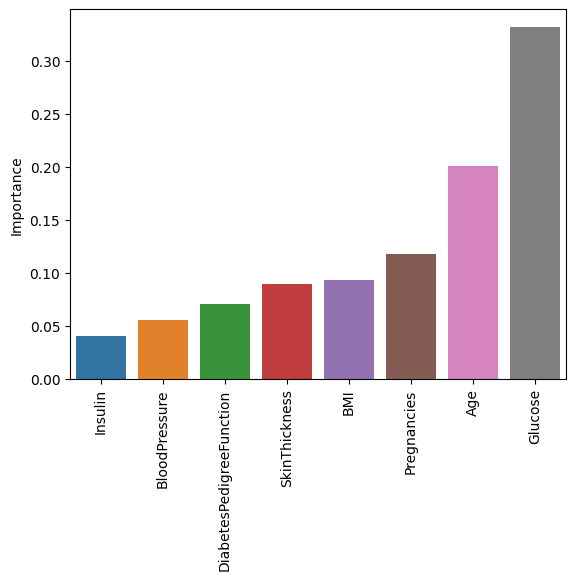

In [173]:
imp_feats_tree = feats_tree.sort_values("Importance")
sns.barplot(data=imp_feats_tree,x=imp_feats_tree.index,y='Importance')
plt.xticks(rotation=90);

In [167]:
from sklearn.tree import plot_tree

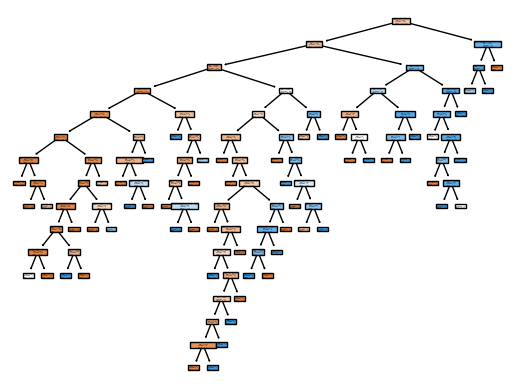

In [169]:
plot_tree(grid_tree.best_estimator_,filled=True,feature_names=X.columns);